Vorhersage der wöchentlichen Verkaufszahlen

**Table of contents**<a id='toc0_'></a>    
1. [Einleitung](#toc1_)    
1.1. [Problemstellung](#toc1_1_)    
1.2. [Hintergrund](#toc1_2_)    
1.3. [Datenquelle](#toc1_3_)    
1.4. [Datenfelder bzw. Variablenbezeichnungen](#toc1_4_)    
1.4.1. [Datenbeschreibung](#toc1_4_1_)    
1.4.1.1. [`train.csv`](#toc1_4_1_1_)    
1.4.1.2. [`store.csv`](#toc1_4_1_2_)    
1.5. [Konkrete Aufgabenstellung](#toc1_5_)    
2. [Preliminary](#toc2_)    
2.1. [Importieren der Module](#toc2_1_)    
2.2. [Daten laden](#toc2_2_)    
3. [Daten Vorbereiten](#toc3_)    
3.1. [df_sales](#toc3_1_)    
3.1.1. [Daten übersetzen](#toc3_1_1_)    
3.1.2. [Daten Dimensionen und Dateiformate](#toc3_1_2_)    
3.1.3. [df_sales["Feiertag"]](#toc3_1_3_)    
3.1.4. [Suche nach fehlenden Werten](#toc3_1_4_)    
3.1.5. [Suche nach Duplikaten](#toc3_1_5_)    
3.2. [df_store](#toc3_2_)    
3.2.1. [Daten übersetzen](#toc3_2_1_)    
3.2.2. [Daten Dimensionen und Formate](#toc3_2_2_)    
3.2.3. [Suche nach fehlenden Werten](#toc3_2_3_)    
3.2.4. [Imputation](#toc3_2_4_)    
3.2.4.1. [Wettbewerber_Distanz](#toc3_2_4_1_)    
3.2.4.2. [Promo2_Interval, _seit_Woche und _seit_Jahr](#toc3_2_4_2_)    
3.2.4.3. [Wettbew_offen_seit_Jahr und _offen_seit_Monat mit KNNImputer](#toc3_2_4_3_)    
3.2.5. [Dublikate](#toc3_2_5_)    
3.2.6. [Dateiformate](#toc3_2_6_)    
3.2.7. [kategoriale Spalten](#toc3_2_7_)    
3.3. [Dataframes kombinieren und Infos aus Features extrahieren](#toc3_3_)    
3.3.1. [Dataframes zu df_daily kombinieren](#toc3_3_1_)    
3.3.2. [Promo2 Features](#toc3_3_2_)    
3.3.3. [Wettbewerber Features](#toc3_3_3_)    
3.3.4. [Bundesländer Mapping nach Schulferien](#toc3_3_4_)    
3.3.5. [temporale Features hinzufügen](#toc3_3_5_)    
3.3.6. [Datenpunkte ohne Umsätze rausfiltern](#toc3_3_6_)    
3.3.7. [aggregierte Ansicht](#toc3_3_7_)    
3.3.8. [Gruppierung basierend auf Umsatz pro Kunde](#toc3_3_8_)    
3.3.9. [dataframes als pkl abspeichern](#toc3_3_9_)    
4. [Explorative Datenanalyse](#toc4_)    
4.1. [Zielvariable](#toc4_1_)    
4.1.1. [Korrelationen von Umsatz](#toc4_1_1_)    
4.1.2. [Bivariate Analyse von Umsatz](#toc4_1_2_)    
4.1.3. [kategorische Variablen gegen Umsatz](#toc4_1_3_)    
4.2. [KPIs](#toc4_2_)    
4.2.1. [Verlauf der KPIs](#toc4_2_1_)    
4.2.2. [KPIs nach Tagen](#toc4_2_2_)    
4.2.3. [Irreguläre Tage](#toc4_2_3_)    
4.3. [Promo](#toc4_3_)    
4.3.1. [Korrelationen von Promo](#toc4_3_1_)    
4.3.2. [Jahresverlauf](#toc4_3_2_)    
4.3.3. [Irreguläre Tage](#toc4_3_3_)    
4.4. [Promo2](#toc4_4_)    
4.4.1. [Korrelationen von Promo2](#toc4_4_1_)    
4.4.2. [Jahresverlauf](#toc4_4_2_)    
4.4.3. [Irreguläre Tage](#toc4_4_3_)    
4.4.4. [Promo2 Intervalle](#toc4_4_4_)    
4.4.5. [Dauer Promo2](#toc4_4_5_)    
4.4.6. [Promo2 gegen Promo](#toc4_4_6_)    
4.5. [Wettbewerber](#toc4_5_)    
4.5.1. [Korrelationen von Wettbewerber Distanz](#toc4_5_1_)    
4.5.2. [Einfluss auf KPIs](#toc4_5_2_)    
4.5.3. [Umsatz in Abhängigkeit seit der Öffnung von Wettbwerbern](#toc4_5_3_)    
4.5.4. [Wettbew Distanz und Promo](#toc4_5_4_)    
4.6. [Sortiment](#toc4_6_)    
4.6.1. [Jahresverlauf](#toc4_6_1_)    
4.6.2. [Irreguläre Tage](#toc4_6_2_)    
4.6.3. [Promo](#toc4_6_3_)    
4.7. [Geschäftstyp](#toc4_7_)    
4.7.1. [Jahresverlauf](#toc4_7_1_)    
4.7.2. [Irreguläre Tage](#toc4_7_2_)    
4.7.3. [Promo](#toc4_7_3_)    
4.7.4. [Sortiment](#toc4_7_4_)    
4.7.5. [Sortiment und Promo](#toc4_7_5_)    
4.8. [Bundesländer](#toc4_8_)    
4.8.1. [KPIs](#toc4_8_1_)    
4.8.2. [Geschäftstyp und Sortiment](#toc4_8_2_)    
4.8.3. [Anzahl Filialen pro Bundesland](#toc4_8_3_)    
4.9. [Gruppierung](#toc4_9_)    
4.9.1. [KPIs](#toc4_9_1_)    
4.9.2. [Geschäftstyp und Sortiment](#toc4_9_2_)    
4.9.3. [Anzahl Filialen pro Bundesland](#toc4_9_3_)    
4.10. [Zusammenfassung der EDA](#toc4_10_)    
5. [Datenpreprozessierung](#toc5_)    
5.1. [Dataframes laden und auf wöchentlich aggregieren](#toc5_1_)    
5.2. [Transformieren](#toc5_2_)    
5.3. [Splitten](#toc5_3_)    
6. [Feature Selection](#toc6_)    
6.1. [per Korrelation](#toc6_1_)    
6.2. [per RandomForestRegressor](#toc6_2_)    
6.3. [Recursive Feature Elimination (RFE)](#toc6_3_)    
6.4. [Final Features](#toc6_4_)    
7. [Auswahl des Machine Learning Moduls](#toc7_)    
7.1. [Average Modell](#toc7_1_)    
7.2. [Linear Regression](#toc7_2_)    
7.3. [Linear Regression Regularized Model - LASSO](#toc7_3_)    
7.4. [Linear Regression Regularized Model - Ridge](#toc7_4_)    
7.5. [k nearest neighbor (KNN)](#toc7_5_)    
7.6. [Suport Vector Machines (SVM)](#toc7_6_)    
7.7. [Random Forest Regressor](#toc7_7_)    
7.8. [MLP Regressor (deep-Learning)](#toc7_8_)    
8. [CrossValidation und HyperParameter Tuning](#toc8_)    
8.1. [Cross Validation](#toc8_1_)    
8.2. [Hyperparameter Tuning](#toc8_2_)    
8.3. [Paramater auf Overfitting testen](#toc8_3_)    
9. [ZukunftsDataframe erstellen](#toc9_)    
9.1. [Datenskelett aufbauen (letzen 8 Wochen der Daten)](#toc9_1_)    
9.2. [Datenskelett testen](#toc9_2_)    
10. [Finales Modell und Zukunft](#toc10_)    
10.1. [Datenskelett aufbauen (zukunft)](#toc10_1_)    
10.2. [Zukunft vorhersagen](#toc10_2_)    
11. [Filialebericht-Generator](#toc11_)    

<!-- vscode-jupyter-toc-config
	numbering=true
	anchor=true
	flat=true
	minLevel=1
	maxLevel=4
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# 1. <a id='toc1_'></a>Einleitung [&#9650;](#toc0_)

## 1.1. <a id='toc1_1_'></a>Problemstellung [&#9650;](#toc0_)

Dieses Projekt soll untersuchen, welche Erkenntnisse die Drogeriekette Rossmann aus ihren historischen Verkaufs- und Werbedaten gewinnen kann, mit Daten zu ...
- Schulferien
- Feiertagen
- Wettbewerbern
- Promoaktionen
- Geschäftstyp
- Sortiment   
  
Ziele:
- den Betrieb und das Management der Filialen optimieren
- mehr Umsatz generieren durch gezieltere Promoaktionen  
- Darüber hinaus soll ermittelt werden
- die wöchentlichen Verkäufe (Umsatzerlöse) für jede Filiale vorhersagen

## 1.2. <a id='toc1_2_'></a>Hintergrund [&#9650;](#toc0_)

Rossmann betreibt über 4.300 Drogeriemärkte in 9 europäischen Ländern (vgl. https://de.wikipedia.org/wiki/Rossmann_(Handelskette)). Derzeit sind Rossmann-Filialleiter damit beauftragt, ihre wöchentlichen Verkaufsprognosen bis zu acht Wochen im Voraus zu erstellen. Die Verkaufsergebnisse der Filialen werden von vielen Faktoren beeinflusst, einschließlich Werbeaktionen, Wettbewerbsintensität, Schulferien und staatlichen Feiertagen, saisonalen Veränderungen und Standortbedingungen. Da Tausende von einzelnen Filialleitern Verkaufsprognosen auf der Grundlage ihrer individuellen Umstände erstellen, kann die Genauigkeit der Ergebnisse sehr unterschiedlich sein. Daher ist das Data Science Team des Unternehmens auf einer neuen Mission, eine vereinheitlichte Modellierungsmethode für Filialleiter zu erstellen, um die wöchentlichen Ergebnisse mit höherer Genauigkeit vorherzusagen. Das Management Team benötigt zudem auch einen Gesamtbericht mit machbaren bzw. umsetzbaren Strategien, um die allgemeine Leistung (Performance) aller Filialen zu verstehen und eine Möglichkeit zur Optimierung zukünftiger Verkaufsleistungen (d. h. der Umsatzerlöse) zu finden. Zuletzt muss jedem Filialleiter ein individueller Bericht zur Leistung der jeweiligen Filiale zur Verfügung gestellt werden.

## 1.3. <a id='toc1_3_'></a>Datenquelle [&#9650;](#toc0_)

Die in diesem Projekt verwendeten Daten stammen von Kaggle und bestehen aus zwei Datensätzen: `train.csv` und `store.csv`.
<div style="display: flex; justify-content: space-between;">
  <div style="width: 45%;">
    <h3><code>train.csv</code></h3>
    <ul>
      <li><strong>1.017.209 Datenpunkte</strong></li>
      <li><strong>9 Variablen</strong></li>
      <li><strong>1115 Rossmann Filialen</strong></li>
      <li><strong>942 Tage</strong></li>
      <li><strong>01.01.2013 bis zum 31.07.2015</strong></li>
    </ul>
  </div>
  <div style="width: 45%;">
    <h3><code>store.csv</code></h3>
    <ul>
      <li><strong>1115 Datenpunkte</strong></li>
      <li><strong>10 Variablen</strong></li>
      <li><strong>1115 Rossmann Filialen</strong></li>
    </ul
  </div>
</div>
>
  </div>
</div>


## 1.4. <a id='toc1_4_'></a>Datenfelder bzw. Variablenbezeichnungen [&#9650;](#toc0_)

### 1.4.1. <a id='toc1_4_1_'></a>Datenbeschreibung [&#9650;](#toc0_)

Die in diesem Projekt verwendeten Daten stammen von Kaggle und bestehen aus zwei Datensätzen: `train.csv` und `store.csv`.

#### 1.4.1.1. <a id='toc1_4_1_1_'></a>`train.csv` [&#9650;](#toc0_)
- **Id**: Eine ID-Variable, die ein (Filiale, Datum) Paar innerhalb des Trainingssets identifiziert.
- **Store**: Eine eindeutige ID für jede Filiale.
- **Sales**: Der Umsatz für einen bestimmten Tag (das ist die Zielvariable, die vorhergesagt werden soll, auf wöchentlicher Ebene aggregiert).
- **Customers**: Die Anzahl der Kunden an einem bestimmten Tag.
- **Open**: Ein Indikator dafür, ob der Laden (Filiale) geöffnet war (0 = geschlossen, 1 = geöffnet).
- **StateHoliday**: Gibt einen staatlichen Feiertag an. Normalerweise sind an staatlichen Feiertagen alle Geschäfte mit wenigen Ausnahmen geschlossen. Beachte bitte, dass an öffentlichen Feiertagen und Wochenenden alle Schulen geschlossen sind (a = öffentlicher Feiertag, b = Ostern, c = Weihnachten, 0 = kein Feiertag).
- **SchoolHoliday**: Gibt an, ob das (Filiale, Datum) Paar von der Schließung öffentlicher Schulen betroffen war.
- **StoreType**: Unterscheidet zwischen vier verschiedenen Ladenmodellen (a, b, c, d).
- **Assortment**: Beschreibt einen Sortimentsgrad (a = Basis, b = Extra, c = Erweitert).

#### 1.4.1.2. <a id='toc1_4_1_2_'></a>`store.csv` [&#9650;](#toc0_)
- **Store**: Eine eindeutige ID für jede Filiale.
- **CompetitionDistance**: Ist die Entfernung in Metern zum nächstgelegenen Konkurrenzgeschäft.
- **CompetitionOpenSince[Month/Year]**: Gibt das ungefähre Jahr und den Monat der Eröffnung des nächsten Konkurrenten an.
- **Promo**: Gibt an, ob an diesem Tag eine Werbeaktion im Geschäft stattgefunden hat.
- **Promo2**: Ist eine fortlaufende und aufeinanderfolgende Werbeaktion für einige Geschäfte (0 = Geschäft nimmt nicht teil, 1 = Geschäft nimmt teil).
- **Promo2Since[Year/Week]**: Beschreibt das Jahr und die Kalenderwoche, in der das Geschäft an Promo2 teilgenommen hat.
- **PromoInterval**: Beschreibt die aufeinanderfolgenden Intervalle, in denen Promo2 gestartet wird, indem die Monate benannt werden, in denen die Werbeaktionen neu gestartet werden. Zum Beispiel bedeutet "Feb, May, Aug, Nov", dass jede Runde im Februar, Mai, August, November eines jeden Jahres für diesen Laden startet.
es für diesen Laden startet.

## 1.5. <a id='toc1_5_'></a>Konkrete Aufgabenstellung [&#9650;](#toc0_)

1. Bestimme die **Schlüsselfaktoren, die die Verkaufs- bzw. Umsatzerlöse beeinflussen** und stelle geeignete Strategien für das Management-Team für die zukünftige Geschäftsplanung bereit.

2. Baue ein vereinheitlichtes **Prognosemodell** auf (z.B. mit Hilfe einer einfachen Zeitreihenmodellierung) für jede Filiale auf der Grundlage der historischen Verkaufsdaten oder mit zusätzlichen Schlüsselvariablen, falls erforderlich, um sicherzustellen, dass das Modell besser abschneidet als die durchschnittliche Methode (Mittelwertmethode - Prognose mit dem Durchschnittswert der historischen Daten).

3. Generiere **Berichte** mit Informationen zur Gesamtleistung der 1115 Filialen sowie individueller Leistungsberichte für jede Filiale.
le.
le.


# 2. <a id='toc2_'></a>Preliminary [&#9650;](#toc0_)

## 2.1. <a id='toc2_1_'></a>Importieren der Module [&#9650;](#toc0_)

In [3]:
import numpy as np
import pandas as pd
from datetime import datetime, timedelta
import time

#plotten
import matplotlib.pyplot as plt
import seaborn as sns

#Plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
%matplotlib inline
import kaleido
import plotly.io as pio
pio.renderers.default = 'vscode+png'

from IPython.display import display, HTML
from functools import reduce
import joblib
import pyarrow as pa
from scipy.stats import anderson, randint, ttest_ind
pd.set_option('display.max_columns', None)

# machine Learning
from sklearn.impute import KNNImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Ridge, Lasso, LinearRegression
from sklearn.feature_selection import SelectPercentile, f_regression, RFE, SelectFromModel
from sklearn.model_selection import TimeSeriesSplit, cross_val_score, KFold, train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error, make_scorer
from sklearn.preprocessing import PowerTransformer, StandardScaler, MinMaxScaler, RobustScaler, LabelEncoder, OneHotEncoder
from sklearn.experimental import enable_iterative_imputer

## 2.2. <a id='toc2_2_'></a>Daten laden [&#9650;](#toc0_)

In [4]:
df_sales_raw = pd.read_csv(r"..\Datafiles\train-230314-173235.csv",
                           low_memory=False, parse_dates=True)
df_store_raw = pd.read_csv(r"..\Datafiles\store-230314-173325.csv",
                           low_memory=False)


# 3. <a id='toc3_'></a>Daten Vorbereiten [&#9650;](#toc0_)

Im ersten Schritt werden die Datensätze näher angeschaut, fehlende Werte werden untersucht und neue Features werden für weitere Analysen erstellt.  
Wir beginnen mit df_sales (df_train Datei), dann df_stores und kombinieren diese im Anschluss.

## 3.1. <a id='toc3_1_'></a>df_sales [&#9650;](#toc0_)

In [5]:
round(df_sales_raw.describe().T, 2)

,count,mean,std,min,25%,50%,75%,max
Store,1017209.0,558.43,321.91,1.0,280.0,558.0,838.0,1115.0
DayOfWeek,1017209.0,4.00,2.00,1.0,2.0,4.0,6.0,7.0
Sales,1017209.0,5773.82,3849.93,0.0,3727.0,5744.0,7856.0,41551.0
Customers,1017209.0,633.15,464.41,0.0,405.0,609.0,837.0,7388.0
Open,1017209.0,0.83,0.38,0.0,1.0,1.0,1.0,1.0
Promo,1017209.0,0.38,0.49,0.0,0.0,0.0,1.0,1.0
SchoolHoliday,1017209.0,0.18,0.38,0.0,0.0,0.0,0.0,1.0


Im Durchschninitt wird pro Filiale 5773 € am Tag erzielt. Jedoch schwankt die Zahl zwischen 0 und 41551 €. Wie es scheint gibt es Tage an denen keine 
Einnahmen erzielt wurden.

### 3.1.1. <a id='toc3_1_1_'></a>Daten übersetzen [&#9650;](#toc0_)

Zunächst werden die Spalltennamen übersetzt und die Spalten "Umsatz_pro_Kunde", "Umsatz_pro_Tag" und "Kunden_pro_Tag" erstellt.

In [6]:
df_sales = df_sales_raw.copy()

spalten_eng = ['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo', 'StateHoliday', 'SchoolHoliday']
spalten_deu = ["Filiale", "Wochentag", "Datum", "Umsatz", "Kundenzahl", "Geöffnet", "Promo", "Feiertag", "Schulferien"]
df_sales.columns = spalten_deu

# Neue Spalte erstellen
df_sales["Umsatz_pro_Tag"] = df_sales.Umsatz//df_sales.Geöffnet.round(0)
df_sales["Kunden_pro_Tag"] = df_sales.Kundenzahl//df_sales.Geöffnet.round(0)
df_sales["Umsatz_pro_Kunde"] = df_sales.Umsatz / df_sales.Kundenzahl.round(2)
print(df_sales.columns)
round(df_sales[["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]].describe(), 2)

Index(['Filiale', 'Wochentag', 'Datum', 'Umsatz', 'Kundenzahl', 'Geöffnet',
       'Promo', 'Feiertag', 'Schulferien', 'Umsatz_pro_Tag', 'Kunden_pro_Tag',
       'Umsatz_pro_Kunde'],
      dtype='object')


,Umsatz_pro_Tag,Kunden_pro_Tag,Umsatz_pro_Kunde
count,844392.00,844392.00,844340.00
mean,6955.51,762.73,9.49
std,3104.21,401.23,2.20
min,0.00,0.00,0.00
25%,4859.00,519.00,7.90
50%,6369.00,676.00,9.25
75%,8360.00,893.00,10.90
max,41551.00,7388.00,64.96


Im Schnitt geben Kunden 9,49 € am Tag aus.

### 3.1.2. <a id='toc3_1_2_'></a>Daten Dimensionen und Dateiformate [&#9650;](#toc0_)

In [7]:
# Shape des dataframes und dtypes
print(df_sales.shape)
df_sales.dtypes

(1017209, 12)


Filiale               int64
Wochentag             int64
Datum                object
Umsatz                int64
Kundenzahl            int64
Geöffnet              int64
Promo                 int64
Feiertag             object
Schulferien           int64
Umsatz_pro_Tag      float64
Kunden_pro_Tag      float64
Umsatz_pro_Kunde    float64
dtype: object

Datum wird aufs datetime Format gesetzt und Feiertag näher untersucht

In [8]:
# Datum auf datetime Format ändern
df_sales.Datum = pd.to_datetime(df_sales.Datum)

df_sales.Feiertag.unique()

array(['0', 'a', 'b', 'c'], dtype=object)

### 3.1.3. <a id='toc3_1_3_'></a>[df_sales["Feiertag"]](#toc0_) [&#9650;](#toc0_)

Die Variablen in Feiertag werden umgenannt.

In [9]:
# alte und neue Variablen Namen
variablen_feiertag_alt = ['0', 'a', 'b', 'c']
variablen_feiertag_neu = ["regulärer_Tag", "öffentl_Feiertag", "Ostern", "Weihnachten"]

# Namen ersetzen
df_sales.Feiertag = df_sales.Feiertag.replace(dict(zip(variablen_feiertag_alt, variablen_feiertag_neu)))
df_sales.Feiertag.unique()

array(['regulärer_Tag', 'öffentl_Feiertag', 'Ostern', 'Weihnachten'],
      dtype=object)

Im folgenden ist die Verteilung von den Feiertag Variablen zu sehen. Regulärer_Tag wurde jedoch entfernt. Es gibt mehr öffentliche Feiertage als Ostertage als Weihnachtstage

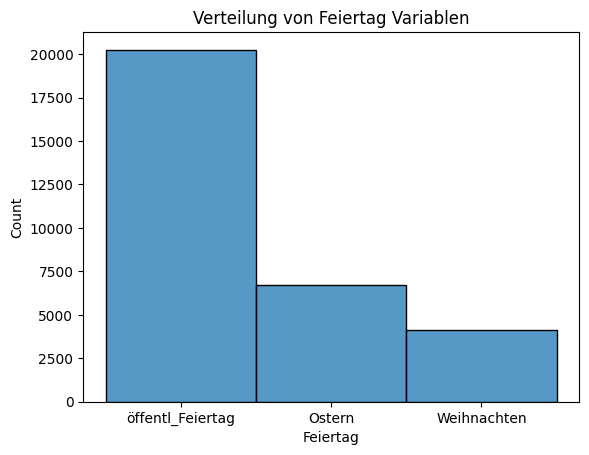

In [10]:
sns.histplot(df_sales[df_sales.Feiertag != "regulärer_Tag"], x="Feiertag")
plt.title("Verteilung von Feiertag Variablen")
plt.show()

### 3.1.4. <a id='toc3_1_4_'></a>Suche nach fehlenden Werten [&#9650;](#toc0_)

In [11]:
# Anteil der NA Werte in einer Tabelle zeigen
def percent(df):
    null = df.isnull().sum()
    null_df = pd.DataFrame(null)
    null_df.columns = ["Total"]
    null_df = null_df[null_df["Total"] > 0]
    
    if null_df.empty:
        print("Keine fehlenden Werte")
    else:
        null_df["Anteil_[%]"] = null_df.Total / df.shape[0] * 100
        null_df["Anteil_[%]"] = null_df["Anteil_[%]"].map("{:.2f}".format)
        
    return null_df
percent(df_sales)

,Total,Anteil_[%]
Umsatz_pro_Tag,172817,16.99
Kunden_pro_Tag,172817,16.99
Umsatz_pro_Kunde,172869,16.99


Da es geschlossene Tage mit 0 € Umsatz und 0 Kunden gibt, hat neu erzeugten Spalten fehlende Werte.  
Dies wird in der unteren Grafik ersichtlich. Es gibt viele Werte um 0 €

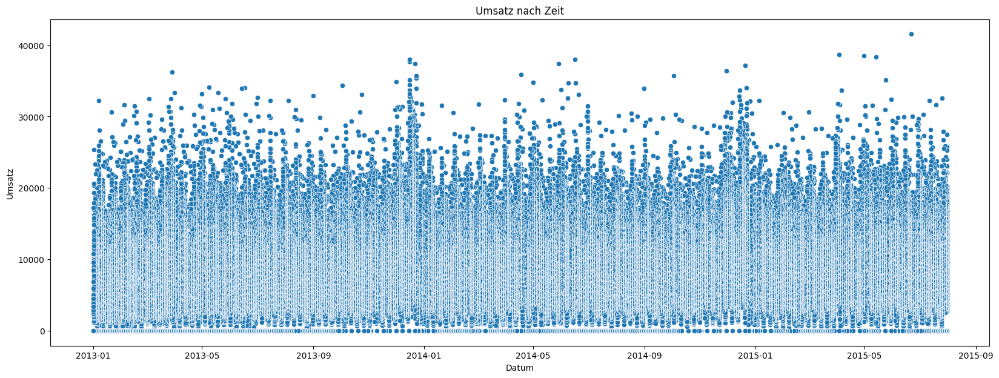

In [12]:
plt.figure(figsize=(20, 7))
sns.scatterplot(df_sales, x="Datum", y="Umsatz")
plt.title("Umsatz nach Zeit")
plt.show()

In [13]:
# Filtern nach geschlossen und 0 € Umsatz. Anzeigen der Anzahl von Datenpunkten mit Filter
print(df_sales[(df_sales.Geöffnet == 0) & (df_sales.Umsatz == 0)].shape)
df_sales[(df_sales.Geöffnet == 0) & (df_sales.Umsatz == 0)].head()

(172817, 12)


,Filiale,Wochentag,Datum,Umsatz,Kundenzahl,Geöffnet,Promo,Feiertag,Schulferien,Umsatz_pro_Tag,Kunden_pro_Tag,Umsatz_pro_Kunde
291,292,5,2015-07-31,0,0,0,1,regulärer_Tag,1,NaN,NaN,NaN
875,876,5,2015-07-31,0,0,0,1,regulärer_Tag,1,NaN,NaN,NaN
1406,292,4,2015-07-30,0,0,0,1,regulärer_Tag,1,NaN,NaN,NaN
1990,876,4,2015-07-30,0,0,0,1,regulärer_Tag,1,NaN,NaN,NaN
2521,292,3,2015-07-29,0,0,0,1,regulärer_Tag,1,NaN,NaN,NaN


172817 Tage sind geschlossen und erbringen keine Einnahmen. Wie sieht es mit  
geöffneten Tagen aber ohne Einnahmen aus?

In [14]:
# Filtern nach Geöffnet und 0 € Umsatz
print(df_sales[(df_sales.Geöffnet != 0) & (df_sales.Umsatz == 0)].shape)
df_sales[(df_sales.Geöffnet != 0) & (df_sales.Umsatz == 0)].head()

(54, 12)


,Filiale,Wochentag,Datum,Umsatz,Kundenzahl,Geöffnet,Promo,Feiertag,Schulferien,Umsatz_pro_Tag,Kunden_pro_Tag,Umsatz_pro_Kunde
86825,971,5,2015-05-15,0,0,1,0,regulärer_Tag,1,0.0,0.0,NaN
142278,674,4,2015-03-26,0,0,1,0,regulärer_Tag,0,0.0,0.0,NaN
196938,699,4,2015-02-05,0,0,1,1,regulärer_Tag,0,0.0,0.0,NaN
322053,708,3,2014-10-01,0,0,1,1,regulärer_Tag,0,0.0,0.0,NaN
330176,357,1,2014-09-22,0,0,1,0,regulärer_Tag,0,0.0,0.0,NaN


Es gibt auch Tage an denen eine Filiale geöffnet hat, aber keine Einnahmen erzielt. Tage ohne Einnahmen werden am Ende dieses Kapitel rausgefiltert, da die Daten für das Feature Engineering gleich noch benötigt werden.

### 3.1.5. <a id='toc3_1_5_'></a>Suche nach Duplikaten [&#9650;](#toc0_)

In [15]:
df_sales.duplicated().sum()

0

Es sind keine Duplikate vorhanden.

## 3.2. <a id='toc3_2_'></a>df_store [&#9650;](#toc0_)

In [16]:
round(df_store_raw.describe().T)

,count,mean,std,min,25%,50%,75%,max
Store,1115.0,558.0,322.0,1.0,280.0,558.0,836.0,1115.0
CompetitionDistance,1112.0,5405.0,7663.0,20.0,718.0,2325.0,6882.0,75860.0
CompetitionOpenSinceMonth,761.0,7.0,3.0,1.0,4.0,8.0,10.0,12.0
CompetitionOpenSinceYear,761.0,2009.0,6.0,1900.0,2006.0,2010.0,2013.0,2015.0
Promo2,1115.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0
Promo2SinceWeek,571.0,24.0,14.0,1.0,13.0,22.0,37.0,50.0
Promo2SinceYear,571.0,2012.0,2.0,2009.0,2011.0,2012.0,2013.0,2015.0


In [17]:
df_store_raw.head()

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN


### 3.2.1. <a id='toc3_2_1_'></a>Daten übersetzen [&#9650;](#toc0_)

Wie auch bei df_sales werden die Spalten erst übersetzt.

In [18]:
df_store = df_store_raw.copy()

spalten_eng = ['Store', 'StoreType', 'Assortment', 'CompetitionDistance','CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2','Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval']
spalten_deu = ["Filiale", "Geschäftstyp", "Sortiment", "Wettbew_Distanz", "Wettbew_offen_seit_Monat", "Wettbew_offen_seit_Jahr", "Promo2", "Promo2_seit_Woche", "Promo2_seit_Jahr", "Promo2_Intervall"]

df_store.columns = spalten_deu
df_store.columns

Index(['Filiale', 'Geschäftstyp', 'Sortiment', 'Wettbew_Distanz',
       'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr', 'Promo2',
       'Promo2_seit_Woche', 'Promo2_seit_Jahr', 'Promo2_Intervall'],
      dtype='object')

### 3.2.2. <a id='toc3_2_2_'></a>Daten Dimensionen und Formate [&#9650;](#toc0_)

In [19]:
print(df_store.shape)
df_store.dtypes

(1115, 10)


Filiale                       int64
Geschäftstyp                 object
Sortiment                    object
Wettbew_Distanz             float64
Wettbew_offen_seit_Monat    float64
Wettbew_offen_seit_Jahr     float64
Promo2                        int64
Promo2_seit_Woche           float64
Promo2_seit_Jahr            float64
Promo2_Intervall             object
dtype: object

### 3.2.3. <a id='toc3_2_3_'></a>Suche nach fehlenden Werten [&#9650;](#toc0_)

In [20]:
percent(df_store)

,Total,Anteil_[%]
Wettbew_Distanz,3,0.27
Wettbew_offen_seit_Monat,354,31.75
Wettbew_offen_seit_Jahr,354,31.75
Promo2_seit_Woche,544,48.79
Promo2_seit_Jahr,544,48.79
Promo2_Intervall,544,48.79


Für mehrere Spalten gibt es fehlende Werte. Diese werden im Folgenden nacheinander bearbeitet.

### 3.2.4. <a id='toc3_2_4_'></a>Imputation [&#9650;](#toc0_)

#### 3.2.4.1. <a id='toc3_2_4_1_'></a>Wettbewerber_Distanz [&#9650;](#toc0_)

In [21]:
df_store[pd.isnull(df_store.Wettbew_Distanz)]

,Filiale,Geschäftstyp,Sortiment,Wettbew_Distanz,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_seit_Woche,Promo2_seit_Jahr,Promo2_Intervall
290,291,d,a,NaN,NaN,NaN,0,NaN,NaN,NaN
621,622,a,c,NaN,NaN,NaN,0,NaN,NaN,NaN
878,879,d,a,NaN,NaN,NaN,1,5.0,2013.0,"Feb,May,Aug,Nov"


Die Werte scheinen zufällig zu fehlen, jedoch kann es sein, dass die Distanz zu hoch ist, weshalb die Werte für einige Stores fehlen.  
Jedoch ist dies Spekulation und die Werte werden mit dem Median gefüllt.

In [22]:
df_store['Wettbew_Distanz'] = df_store['Wettbew_Distanz'].fillna(df_store['Wettbew_Distanz'].median())

#### 3.2.4.2. <a id='toc3_2_4_2_'></a>Promo2_Interval, _seit_Woche und _seit_Jahr [&#9650;](#toc0_)

Die drei Spalten haben die gleiche Anzahl an fehlenden Werten. Wenn wir und das genauer anschauen, wird ersichtlich, dass diese Filialen nicht an Promo2 teilnehmen. Daher werden Die Werte einfach auf 0 gesetzt.

In [23]:
df_store[pd.isnull(df_store.Promo2_Intervall)]

,Filiale,Geschäftstyp,Sortiment,Wettbew_Distanz,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_seit_Woche,Promo2_seit_Jahr,Promo2_Intervall
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN
5,6,a,a,310.0,12.0,2013.0,0,NaN,NaN,NaN
6,7,a,c,24000.0,4.0,2013.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
1107,1108,a,a,540.0,4.0,2004.0,0,NaN,NaN,NaN
1109,1110,c,c,900.0,9.0,2010.0,0,NaN,NaN,NaN
1111,1112,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
1112,1113,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN


Daher überprüfen wir ob es Null Werte bei Filialen mit Promo2=1 gibt

In [24]:
# Filterung nach Promo2 ungleich 0 und Promo2_Intervall ohne Angaben
df_store[pd.isnull(df_store.Promo2_Intervall) & df_store.Promo2 != 0]

,Filiale,Geschäftstyp,Sortiment,Wettbew_Distanz,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_seit_Woche,Promo2_seit_Jahr,Promo2_Intervall


Wie erwartet nehmen diese Filialen nicht an Promo2 teil und kriegen den Wert 0.

In [25]:
df_store["Promo2_Intervall"] = df_store["Promo2_Intervall"].fillna(0)
df_store["Promo2_seit_Woche"] = df_store["Promo2_seit_Woche"].fillna(0)
df_store["Promo2_seit_Jahr"] = df_store["Promo2_seit_Jahr"].fillna(0)

#### 3.2.4.3. <a id='toc3_2_4_3_'></a>Wettbew_offen_seit_Jahr und _offen_seit_Monat mit KNNImputer [&#9650;](#toc0_)

In [26]:
df_store[pd.isnull(df_store.Wettbew_offen_seit_Jahr)].head()

,Filiale,Geschäftstyp,Sortiment,Wettbew_Distanz,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_seit_Woche,Promo2_seit_Jahr,Promo2_Intervall
11,12,a,c,1070.0,NaN,NaN,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
12,13,d,a,310.0,NaN,NaN,1,45.0,2009.0,"Feb,May,Aug,Nov"
15,16,a,c,3270.0,NaN,NaN,0,0.0,0.0,0
18,19,a,c,3240.0,NaN,NaN,1,22.0,2011.0,"Mar,Jun,Sept,Dec"
21,22,a,a,1040.0,NaN,NaN,1,22.0,2012.0,"Jan,Apr,Jul,Oct"


Obwohl es Wettbewerber für die Filiale gibt, gibt es keine Angaben über das Öffnungsdatum der Wettbewerber. Daher werden diese Werte mittels KNN Imputer geüllt. Für den prozess werden temporäre Dataframes erstellt.

OneHotEncoding von Feiertag Spalte

In [27]:
df_sales_temp = df_sales.copy()

# OneHotEncoding für "Feiertag" in df_sales
ohe = OneHotEncoder(sparse_output=False)
enc_columns = ohe.fit_transform(df_sales_temp[['Feiertag']])
# Dataframe with encoded columns
encoded_df = pd.DataFrame(enc_columns,
                          columns=ohe.get_feature_names_out(["Feiertag"]))
# adding encoded columns to train
df_sales_temp = pd.concat([df_sales, encoded_df], axis=1).drop("Feiertag", axis=1)
old_names_feiertag = list(ohe.get_feature_names_out(["Feiertag"]))

# nach store aggregieren
df_sales_temp = df_sales_temp.drop(["Wochentag","Datum"], axis=1).groupby("Filiale").sum().reset_index().astype("int")

Umsatz und Kunden pro Tag

In [28]:
# Kombinieren
df_combined_temp = pd.merge(df_sales_temp, df_store, how = 'left', on = 'Filiale')

# interaktionen SalesPerDay, CustomersPerDay, SalesPerCustomer
df_combined_temp["Umsatz_pro_Tag"] = df_combined_temp.Umsatz//df_combined_temp.Geöffnet
df_combined_temp["Kunden_pro_Tag"] = df_combined_temp.Kundenzahl//df_combined_temp.Geöffnet

OneHotEncoding Geschäftstyp, Sortiment und Promo2_Interall

In [29]:
# Storetype OneHotEncoding
enc_columns = ohe.fit_transform(df_combined_temp[["Geschäftstyp"]])
encoded_df = pd.DataFrame(enc_columns,
                          columns=ohe.get_feature_names_out(["Geschäftstyp"]))
df_combined_temp = pd.concat([df_combined_temp, encoded_df], axis=1).drop("Geschäftstyp", axis=1)

# Assortment OneHotEncoding
enc_columns = ohe.fit_transform(df_combined_temp[["Sortiment"]])
encoded_df = pd.DataFrame(enc_columns,
                          columns=ohe.get_feature_names_out(["Sortiment"]))
df_combined_temp = pd.concat([df_combined_temp, encoded_df], axis=1).drop("Sortiment", axis=1)

# PromoInterval OneHotEncoding
enc_columns = ohe.fit_transform(df_combined_temp[["Promo2_Intervall"]].astype("str"))
encoded_df = pd.DataFrame(enc_columns,
                          columns=ohe.get_feature_names_out(["Promo2_Intervall"]))
df_combined_temp = pd.concat([df_combined_temp, encoded_df], axis=1).drop("Promo2_Intervall", axis=1)

KNN Imputer

In [30]:
# Initialisiere den KNN-Imputer
imputer = KNNImputer(n_neighbors=2)
# Fitte und transform den Imputer mit dem gesamten DataFrame
imputer.fit(df_combined_temp)
df_combined_imputed = imputer.transform(df_combined_temp)
# Wandle das NumPy-Array zurück in einen DataFrame und behalte die ursprünglichen Spaltennamen bei
df_combined_temp = pd.DataFrame(df_combined_imputed, columns=df_combined_temp.columns)

# Imputierte Werte für "PromoInterval" runden
df_combined_temp['Wettbew_offen_seit_Monat'] = np.round(df_combined_temp['Wettbew_offen_seit_Monat']).astype("int")
df_combined_temp['Wettbew_offen_seit_Jahr'] = np.round(df_combined_temp['Wettbew_offen_seit_Jahr']).astype("int")

In [31]:
# Spalten, die ersetzt werden sollen
columns_to_impute = ['Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr']

## Nullwerte in df_imputed basierend auf df_combined ersetzen
for column in columns_to_impute:
    df_store[column] = df_store.apply(
        lambda row: df_combined_temp[df_combined_temp['Filiale'] == row['Filiale']][column].values[0] if pd.isnull(row[column]) else row[column],
        axis=1
    )

Abschließende Kontrolle ob alle fehlenden Werte imputiert wurden

In [32]:
percent(df_store)

Keine fehlenden Werte


,Total


Alle fehlenden Werte wurden erfolgreich imputiert.

### 3.2.5. <a id='toc3_2_5_'></a>Dublikate [&#9650;](#toc0_)

In [33]:
df_store.duplicated().sum()

0

### 3.2.6. <a id='toc3_2_6_'></a>Dateiformate [&#9650;](#toc0_)

Nach der Imputation können wir uns nun erneut die Dateiformate anschauen und entsprechende Spalten näher betrachten

In [34]:
df_store.dtypes

Filiale                       int64
Geschäftstyp                 object
Sortiment                    object
Wettbew_Distanz             float64
Wettbew_offen_seit_Monat    float64
Wettbew_offen_seit_Jahr     float64
Promo2                        int64
Promo2_seit_Woche           float64
Promo2_seit_Jahr            float64
Promo2_Intervall             object
dtype: object

Zunächst einige floats in int umwandeln und Sortiment Variablen entsprechend benennen

In [35]:
# dtypes umändern in int
to_str = ['Wettbew_Distanz',"Promo2_seit_Woche", 'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr', 'Promo2_seit_Jahr']
df_store[to_str] = df_store[to_str].astype("int")

# Variablen für Sortiment umbennen
dict_assort = {'a': 'basic', 'b': 'extra','c': 'extended'}
df_store['Sortiment'] = df_store['Sortiment'].apply(lambda x: dict_assort[x])

### 3.2.7. <a id='toc3_2_7_'></a>kategoriale Spalten [&#9650;](#toc0_)

Es gibt 4 Geschäftstypen von denen Typ-a mit 602 Filialen am meisten vertreten ist. 348 Filialen sind Typ-d und 148 sind -c. den Typ-b gibt es mit 17 Filialen am wenigsten.

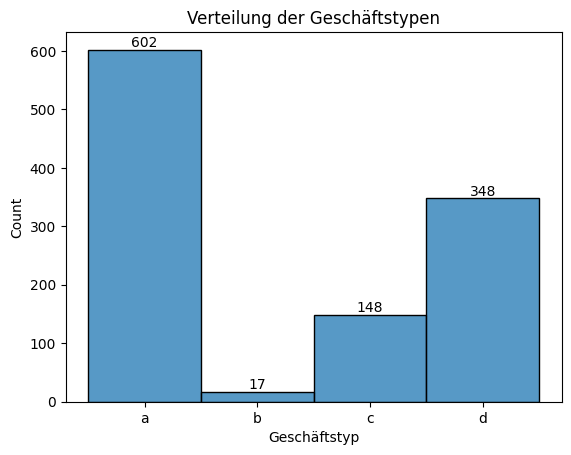

In [36]:
sns.histplot(df_store.sort_values("Geschäftstyp"), x="Geschäftstyp")
plt.title("Verteilung der Geschäftstypen")
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), textcoords='offset points')
plt.show()

Das basic Sortiment gibt es 593 mal und das extended Sortiment 513 mal. Auch hier gibt es einen selteneren Typ, das extra Sortiment mit 9 Filialen.

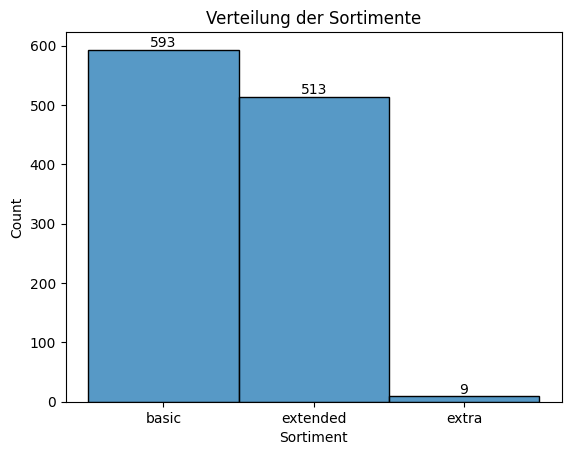

In [37]:
sns.histplot(df_store.sort_values("Sortiment"), x="Sortiment")
plt.title("Verteilung der Sortimente")
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), textcoords='offset points')
plt.show()

Bei der Verteilung der Promo2 Intervalle wird deutlich, dass die Hälfte der Stores nicht an Promo2 teilnehmen. Bei den teilnehmenden Store wird die Rotation Jan,Apr,Jul,Okt am meisten verwendet.

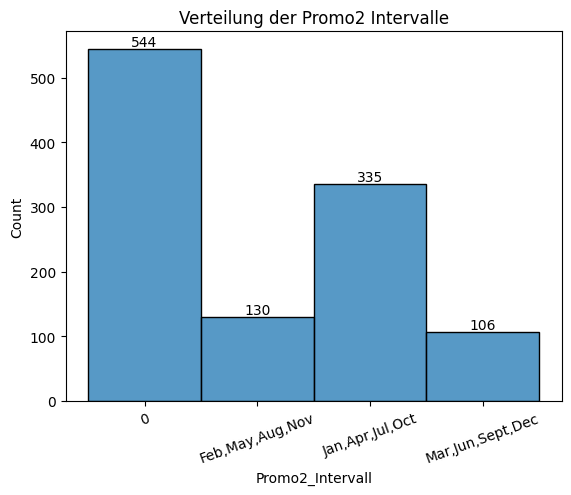

In [38]:
df_store.Promo2_Intervall = df_store.Promo2_Intervall.astype(str)
sns.histplot(df_store.sort_values("Promo2_Intervall"), x="Promo2_Intervall")
plt.title("Verteilung der Promo2 Intervalle")
plt.xticks(rotation=20)
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), textcoords='offset points')
plt.show()

## 3.3. <a id='toc3_3_'></a>Dataframes kombinieren und Infos aus Features extrahieren [&#9650;](#toc0_)

### 3.3.1. <a id='toc3_3_1_'></a>Dataframes zu df_daily kombinieren [&#9650;](#toc0_)

In [39]:
# Kombinieren von df_sales und df_store
df_daily = pd.merge(df_sales, df_store, how = 'inner', on = 'Filiale')
print(f"shape der kombinieretn Ansicht auf täglicher Basis {df_daily.shape}")
df_daily.head()

shape der kombinieretn Ansicht auf täglicher Basis (1017209, 21)


,Filiale,Wochentag,Datum,Umsatz,Kundenzahl,Geöffnet,Promo,Feiertag,Schulferien,Umsatz_pro_Tag,Kunden_pro_Tag,Umsatz_pro_Kunde,Geschäftstyp,Sortiment,Wettbew_Distanz,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_seit_Woche,Promo2_seit_Jahr,Promo2_Intervall
0,1,5,2015-07-31,5263,555,1,1,regulärer_Tag,1,5263.0,555.0,9.482883,c,basic,1270,9,2008,0,0,0,0
1,2,5,2015-07-31,6064,625,1,1,regulärer_Tag,1,6064.0,625.0,9.702400,a,basic,570,11,2007,1,13,2010,"Jan,Apr,Jul,Oct"
2,3,5,2015-07-31,8314,821,1,1,regulärer_Tag,1,8314.0,821.0,10.126675,a,basic,14130,12,2006,1,14,2011,"Jan,Apr,Jul,Oct"
3,4,5,2015-07-31,13995,1498,1,1,regulärer_Tag,1,13995.0,1498.0,9.342457,c,extended,620,9,2009,0,0,0,0
4,5,5,2015-07-31,4822,559,1,1,regulärer_Tag,1,4822.0,559.0,8.626118,a,basic,29910,4,2015,0,0,0,0


Feiertag wird auf die einzelnen Parameter aufgespalten um die Summe an Tagen für jede Variable bei der Aggregation zu berechnen.

In [40]:
# OneHotEncoding für "StateHoliday"
ohe = OneHotEncoder(sparse_output=False)
enc_columns = ohe.fit_transform(df_daily[['Feiertag']])

# Dataframe with encoded columns
encoded_df_daily = pd.DataFrame(enc_columns, columns=ohe.categories_[0], index=df_daily.index)
    
# adding encoded columns to train
df_daily = pd.concat([df_daily, encoded_df_daily], axis=1).drop("Feiertag", axis=1)
df_daily.head(1)

,Filiale,Wochentag,Datum,Umsatz,Kundenzahl,Geöffnet,Promo,Schulferien,Umsatz_pro_Tag,Kunden_pro_Tag,Umsatz_pro_Kunde,Geschäftstyp,Sortiment,Wettbew_Distanz,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_seit_Woche,Promo2_seit_Jahr,Promo2_Intervall,Ostern,Weihnachten,regulärer_Tag,öffentl_Feiertag
0,1,5,2015-07-31,5263,555,1,1,1,5263.0,555.0,9.482883,c,basic,1270,9,2008,0,0,0,0,0.0,0.0,1.0,0.0


### 3.3.2. <a id='toc3_3_2_'></a>Promo2 Features [&#9650;](#toc0_)

Wir wissen aus den Daten welche Filialen an Promo2 teilnehmen und in welchem Zyklus sie stattfindet. Daher erstellen wie eine neue Spalte mir ist_Promo2, die auf einer täglichen Basis angibt ob Promo2 grade läuft

In [41]:
# temporäre Moantsmapping vornehmen 
months = {1: 'Jan', 2: 'Feb', 3: 'Mär', 4: 'Apr', 5: 'Mai', 6: 'Jun', 7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dez'}
df_daily['month_map'] = df_daily['Datum'].dt.month.apply(lambda x: months[x])

# ist_Promo2 mit aktiver Promo2 für den Tag, wenn Monat im Intervall ist
df_daily['ist_Promo2'] = df_daily.apply(lambda x: 0 if x['Promo2_Intervall'] == 0 else 1 if x['month_map'] in x['Promo2_Intervall'].split(',') else 0, axis = 1)
df_daily = df_daily.drop("month_map", axis=1)
df_daily.ist_Promo2

0          0
1          1
2          1
3          0
4          0
          ..
1017204    1
1017205    0
1017206    0
1017207    0
1017208    0
Name: ist_Promo2, Length: 1017209, dtype: int64

Die Jahres und Wochenangabe wird temporär kombniert um die Dauer der Promo2 in Wochen zu berechnen

In [42]:
# Promo2_seit aus Jahr und Woche extrahieren
df_daily['Promo2_seit'] = np.where(df_daily['Promo2_seit_Jahr'] != 0,
                                   df_daily['Promo2_seit_Jahr'].astype(str) + '-' + df_daily['Promo2_seit_Woche'].astype(str),
                                   np.nan)

# Promo2_seit in Datetime Format
df_daily['Promo2_seit'] = df_daily['Promo2_seit'].apply(lambda x: datetime.strptime(x + '-1', '%Y-%W-%w') - timedelta(days=7) if pd.notna(x) else np.nan)

# Berechne Promo2_seit_Wochen --> Promo2_seit vom aktuellen Datum subtrahieren
df_daily['Promo2_seit_Wochen'] = np.where(pd.notna(df_daily['Promo2_seit']),
                                          ((df_daily['Datum'] - df_daily['Promo2_seit']).dt.days / 7),
                                          0)
df_daily['Promo2_seit_Wochen'] = round(df_daily['Promo2_seit_Wochen']).astype(int)

# temporäre Spalte Promo2_seit löschen
df_daily.drop(columns=(["Promo2_seit"]), inplace=True)
df_daily["Promo2_seit_Wochen"].describe()

count    1.017209e+06
mean     5.466500e+01
std      8.580439e+01
min     -1.260000e+02
25%      0.000000e+00
50%      0.000000e+00
75%      1.100000e+02
max      3.140000e+02
Name: Promo2_seit_Wochen, dtype: float64

Im Schnitt läuft Promo2 seit 85 Wochen, aber da Filialen erst im Laufe der Zeit mit Promo2 angefangen haben, gibt es negative Wochen. Diese zeigen an, in wie vielen Wochen die Promo2 anfängt

### 3.3.3. <a id='toc3_3_3_'></a>Wettbewerber Features [&#9650;](#toc0_)

Gleiches wie bei Promo2 wurde für Wettbewerber erstellt. Hier wird die Dauer seit der Eröffnung vom Wettbewerber in Monaten berechnet.

In [43]:
# Wettbew_seit aus Jahr und Monat durch Kombination extrahieren
df_daily['Wettbew_seit'] = df_daily.apply(lambda x: datetime(year = x['Wettbew_offen_seit_Jahr'], month = x['Wettbew_offen_seit_Monat'], day = 1), axis = 1)
df_daily['Wettbew_seit_Monaten'] = ((df_daily['Datum'] - df_daily['Wettbew_seit']) / 30).apply(lambda x: x.days).astype(int)

# Berechne Wettbew_seit_Monaten --> Wettbew_seit vom aktuellen Datum subtrahieren
df_daily.drop(columns=(['Wettbew_seit']), inplace=True)
df_daily['Wettbew_seit_Monaten'].describe()

count    1.017209e+06
mean     6.239011e+01
std      7.383035e+01
min     -3.200000e+01
25%      1.900000e+01
50%      5.500000e+01
75%      9.100000e+01
max      1.407000e+03
Name: Wettbew_seit_Monaten, dtype: float64

Im Schnitt sind Wettbewerber 62 Monate alt, wobei es auch hier Filialen gibt die erst im Laufe der Zeit Wettbewerber erhalten haben. Daher die negativen Monate.

### 3.3.4. <a id='toc3_3_4_'></a>Bundesländer Mapping nach Schulferien [&#9650;](#toc0_)

Um das Bundesland für jede Filiale zu bestimmen, werden die Infos aus der Spalte Schulferien extrahiert, da jedes Bundesland seine eigenen Daten für Schulferien hat. Diese Daten werden mit der Angabe Schulferien in unserem Datensatz verglichen.

Zunächst wird eine Excel Datei aus 3 Excel Dateien mit den Schulferien für die Jahre 2013 bis 2015 zusammengefügt und als dataframe eingelesen. (Quelle der Excel Dateien:https://www.kalenderpedia.de/ferien/ferien-2013.html).

In [44]:
df_ferien = pd.read_excel("..//Datafiles//schulferien-2013-2015.xlsx")
# kleine Korrektur bei den Spaltennamen
df_ferien.columns = ['Bundesländer', "vor 2013", 'Winter 2013', 'Ostern 2013', 'Pfingsten 2013',
       'Sommer 2013', 'Herbst 2013', 'Weihnachten 2013', 'Winter 2014',
       'Ostern 2014', 'Pfingsten 2014', 'Sommer 2014', 'Herbst 2014',
       'Weihnachten 2014', 'Winter 2015', 'Ostern  2015',
       'Pfingsten  2015', 'Sommer  2015', 'Herbst  2015']
df_ferien.drop(columns="Herbst  2015", inplace=True)
df_ferien.head()

,Bundesländer,vor 2013,Winter 2013,Ostern 2013,Pfingsten 2013,Sommer 2013,Herbst 2013,Weihnachten 2013,Winter 2014,Ostern 2014,Pfingsten 2014,Sommer 2014,Herbst 2014,Weihnachten 2014,Winter 2015,Ostern 2015,Pfingsten 2015,Sommer 2015
0,Baden_Württemberg,01.01-05.01,-,25.03.-05.04.,21.05.-01.06.,25.07.-07.09.,28.10.-31.10.,23.12.-04.01.,-,14.04.-25.04.,10.06.-21.06.,31.07.-13.09.,27.10.-31.10.,22.12.-05.01.,-,30.03.-10.04.,26.05.-06.06.,30.07.-12.09.
1,Bayern,01.01-05.01,11.02.-15.02.,25.03.-06.04.,21.05.-31.05.,31.07.-11.09.,28.10.-31.10.,23.12.-04.01.,03.03.-07.03.,14.04.-26.04.,10.06.-21.06.,30.07.-15.09.,27.10.-31.10.,24.12.-05.01.,16.02.-20.02.,30.03.-11.04.,26.05.-05.06.,01.08.-14.09.
2,Berlin,01.01-04.01,04.02.-09.02.,25.03.-06.04.,10.05./21.05.,19.06.-02.08.,30.09.-12.10.,23.12.-03.01.,03.02.-08.02.,14.04.-26.04.,02.05./30.05.,10.07.-22.8.,20.10.-01.11.,22.12.-02.01.,02.02.-07.02.,30.03.-11.04.,15.05./26.05.,16.7.-28.8.
3,Brandenburg,01.01-04.01,04.02.-09.02.,27.03.-06.04.,10.05.-10.05.,20.06.-02.08.,30.09.-12.10.,23.12.-03.01.,03.02.-08.02.,16.04.-26.04.,02.05./30.05.,10.07.-22.08.,20.10.-01.11.,22.12.-02.01.,02.02.-07.02.,01.04.-11.04.,15.05.-15.05.,16.07.-28.08.
4,Bremen,01.01-05.01,31.01.-01.02.,16.03.-02.04.,21.05.-21.05.,27.06.-07.08.,04.10.-18.10.,23.12.-03.01.,30.01.-31.01.,03.04.-22.04.,10.06.-10.06.,31.07.-10.09.,27.10.-08.11.,22.12.-05.01.,02.02.-03.02.,25.03.-10.04.,26.05.-26.05.,23.07.-02.09.


Die Informationen aus der Exceldatei werden in ein einheitliches Format überführt und als dictionary abgespeichert. Das Format sieht wie folgt aus: {"Bundesland": [(Start_Datum, End_Datum für Ferien 1), (Start_Datum, End_Datum für Ferien 2) usw... ]}. Da Ferien, wie Pfingsten, nicht in jedem Bundesland genutzt werden, haben die dict-Einträge eine unterschiedliche Anzahl an Start-und-End-Paaren für Ferien.

In [45]:
# Funktion zum Extrahieren der Ferien
def extract_ferien(df, years):
    # Dictionary mit Bundesländer und Ferienzeiten
    ferien_data = {}
    # Für jedes Bundesland ein key Eintrag im dict erstellen
    for index, row in df.iterrows():
        bundesland = row["Bundesländer"]
        ferien_data[bundesland] = []
        # Für Jahre 2013 - 2015 Ferienname und Jahr kombinieren --> Winter 2013, Ostern 2013 ... 
        for year in years:
            for ferien in ["vor", "Winter", "Ostern", "Pfingsten", "Sommer", "Herbst", "Weihnachten"]:
                ferien_key = f"{ferien} {year}"
                if (ferien_key in df.columns) and (row[ferien_key] != "-") and ("-" in row[ferien_key]):
                    # Zellen Eintrag beim Symbol "-" in Start- und End-Datum splitten
                    start, end = row[ferien_key].split("-")
                    # Startdatum Tag.Monat mit Jahr verbinden und "." durch "-" ersetzen
                    start_date = f"{year}-{start.strip().replace('.', '-')}".rstrip('-')
                    # Überprüfen, ob das Enddatum im nächsten Jahr liegt ...
                    if "Weihnachten" in ferien and int(end.strip().split(".")[1]) < int(start.strip().split(".")[1]):
                        # ...wenn ja, das Jahr in Enddatum auf nächstes Jahr setzen
                        end_date = f"{int(year)+1}-{end.strip().replace('.', '-')}".rstrip('-')
                    else:
                        # ...wenn nein, gleiches Jahr benutzen
                        end_date = f"{year}-{end.strip().replace('.', '-')}".rstrip('-')
                    # Formatierung in "Monat-Tag-Jahr"
                    start_date = "-".join(start_date.split("-")[::-1])
                    end_date = "-".join(end_date.split("-")[::-1])
                    ferien_data[bundesland].append((start_date, end_date))
    return ferien_data

# Jahre, die extrahiert werden sollen
years = ["2013", "2014", "2015"]

# Ferien-Daten extrahieren
ferien_data = extract_ferien(df_ferien, years)

# Ergebnis anzeigen
ferien_data

{'Baden_Württemberg': [('01-01-2013', '01-05-2013'),
  ('03-25-2013', '04-05-2013'),
  ('05-21-2013', '06-01-2013'),
  ('07-25-2013', '09-07-2013'),
  ('10-28-2013', '10-31-2013'),
  ('12-23-2013', '01-04-2014'),
  ('04-14-2014', '04-25-2014'),
  ('06-10-2014', '06-21-2014'),
  ('07-31-2014', '09-13-2014'),
  ('10-27-2014', '10-31-2014'),
  ('12-22-2014', '01-05-2015')],
 'Bayern': [('01-01-2013', '01-05-2013'),
  ('02-11-2013', '02-15-2013'),
  ('03-25-2013', '04-06-2013'),
  ('05-21-2013', '05-31-2013'),
  ('07-31-2013', '09-11-2013'),
  ('10-28-2013', '10-31-2013'),
  ('12-23-2013', '01-04-2014'),
  ('03-03-2014', '03-07-2014'),
  ('04-14-2014', '04-26-2014'),
  ('06-10-2014', '06-21-2014'),
  ('07-30-2014', '09-15-2014'),
  ('10-27-2014', '10-31-2014'),
  ('12-24-2014', '01-05-2015'),
  ('02-16-2015', '02-20-2015')],
 'Berlin': [('01-01-2013', '01-04-2013'),
  ('02-04-2013', '02-09-2013'),
  ('03-25-2013', '04-06-2013'),
  ('06-19-2013', '08-02-2013'),
  ('09-30-2013', '10-12-2013'

Anschließend wird überprüft, wie oft die Spalte "Schulferien" für eine Filiale mit allen Einträgen für jedes Bundesländer übereinstimmt. Die Anzahl an matches für Filiale-Bundesland wird gezählt und durch die Anzahl an allen Ferientagen in einem Bundesland geteilt. Das Maximum aus der ratio entscheidet über die Zuordnung. Jedoch werden Schwellenwerte aus dem median der Anzahl matches für jedes Bundesland erstellt. Filialen, die den Schwellenwert nicht erreichen werden ohne Zuordnung seperat abgespeichert. Falls ein maximaler Wert für mehr als ein Bundesland erzielt wird, wird die Filiale ebenfalls ohne Zuordnung seperat abgespeichert. Filialen ohne Zuordnung werden manuell zugeordnet.

In [46]:
df_länder = df_daily.copy()

# Schwellenwerte für jedes Bundesland erstellt aus dem median an matches für jedes Bundesland plus die Standardabweichung
schwellenwerte = {'Baden_Württemberg': 89,
 'Bayern': 89,
 'Berlin': 84,
 'Brandenburg': 83,
 'Bremen': 74,
 'Hamburg': 68,
 'Hessen': 93,
 'Mecklenburg_Vorp.': 80,
 'Niedersachsen': 73,
 'NRW': 92,
 'Rheinland_Pfalz': 92,
 'Saarland': 93,
 'Sachsen': 92,
 'Sachsen_Anhalt': 89,
 'Schleswig_Holstein': 87,
 'Thüringen': 101}

# Funktion zur Zuordnung der Filialen zu Bundesländern
def zuordnung_bundesland(df, ferien_data, schwellenwerte):
    def check_ferien(dates, ferien):
        # Serie aller Ferienzeiträume erstellen aus Start und Enddatum in ferien_ranges
        ferien_ranges = pd.concat([pd.Series(pd.date_range(start, ende)) for start, ende in ferien])
        counts_matches = dates.isin(ferien_ranges).sum()
        counts_ferientage_bundesland = ferien_ranges.count()
        return counts_matches, counts_ferientage_bundesland

    filialen = df['Filiale'].unique()
    bundesland_zuordnung = {}
    matches_df = pd.DataFrame(index=filialen, columns=ferien_data.keys())
    unzugeordnete_filialen = []
    mehrdeutige_filialen = []

    # Jede Filiale einzeln durcharbeiten
    for filiale in filialen:
        # Filtern nach Store und Schulferien=1
        store_data = df[(df['Filiale'] == filiale) & (df['Schulferien'] == 1)]
        # dictionary mit Bundesländer als key und value = 0 erstellen
        matches = pd.DataFrame([[0]*16], index=[filiale], columns=ferien_data.keys())
        bundesland_ferientage = pd.DataFrame([[0]*16], index=[filiale], columns=ferien_data.keys())
        for bundesland, ferien in ferien_data.items():
            # matches für jedes Bundesland wenn gefiltertes Datum in Ferienzeitraum ist
            matches.at[filiale, bundesland], bundesland_ferientage.at[filiale, bundesland] = check_ferien(store_data['Datum'], ferien)
        # Bundesland mit höchstem ratio zwischen Matches und Anzahl Feiertagen des Bundeslandes 
        best_match = (matches.loc[filiale] / bundesland_ferientage.loc[filiale]).idxmax()
        # Anzahl an Matches
        max_matches = matches.at[filiale, best_match]

        # Überprüfen, ob der Schwellenwert für das beste Bundesland erreicht wurde
        if max_matches >= schwellenwerte[best_match]:
            # Überprüfen, ob der maximal Wert mehrmals vorkommt ...
            if (matches.loc[filiale] == max_matches).sum() > 1:
                # wenn ja, Filialennummer in mehrdeutige_filialen speichern
                mehrdeutige_filialen.append(filiale)
            else:
                # wenn nein, Filialennummer in bundesland_zuordnung speichern
                bundesland_zuordnung[filiale] = best_match
        else:
            # sont in unzugeordnete_Filialen
            unzugeordnete_filialen.append(filiale)
            # Zuordnung von Fililae und Bundesland in sepeartem dataframe
        for bundesland in matches:
            matches_df.at[filiale, bundesland] = matches.at[filiale, bundesland]

    return matches_df, bundesland_zuordnung, unzugeordnete_filialen, mehrdeutige_filialen

# Anwendung der Funktion auf den Rossmann-Datensatz
matches_df, bundesland_zuordnung, unzugeordnete_filialen, mehrdeutige_filialen = zuordnung_bundesland(df_länder, ferien_data, schwellenwerte)

# dict Einträge der Filialen als int abspeichern
bundesland_zuordnung = {int(k): v for k, v in bundesland_zuordnung.items()}

# Minimum und Maximum der erreichten Matches
min_matches = matches_df.min().min()
max_matches = matches_df.max().max()

print(f"Minimum erreichte Matches: {min_matches}")
print(f"Maximum erreichte Matches: {max_matches}")
print(f"Unzugeordnete Filialen: {unzugeordnete_filialen}")
print(f"Mehrdeutige Filialen: {mehrdeutige_filialen}")

Minimum erreichte Matches: 23
Maximum erreichte Matches: 178
Unzugeordnete Filialen: []
Mehrdeutige Filialen: []


Die Schwellenwerte wurden nach dem ersten Durchgang berechnet und für den 2ten Durchgang benutzt

In [47]:
# nicht nochmal ausführen
schwellenwerte = (matches_df.median()).astype(int)
schwellenwerte.to_dict()

{'Baden_Württemberg': 89,
 'Bayern': 89,
 'Berlin': 84,
 'Brandenburg': 83,
 'Bremen': 74,
 'Hamburg': 68,
 'Hessen': 93,
 'Mecklenburg_Vorp.': 80,
 'Niedersachsen': 73,
 'NRW': 92,
 'Rheinland_Pfalz': 92,
 'Saarland': 93,
 'Sachsen': 92,
 'Sachsen_Anhalt': 89,
 'Schleswig_Holstein': 87,
 'Thüringen': 101}

Bundesländer den Filialen zuordnen

In [48]:
# Mapping von df['Bundesland']
df_daily['Bundesland'] = df_länder['Filiale'].map(bundesland_zuordnung)

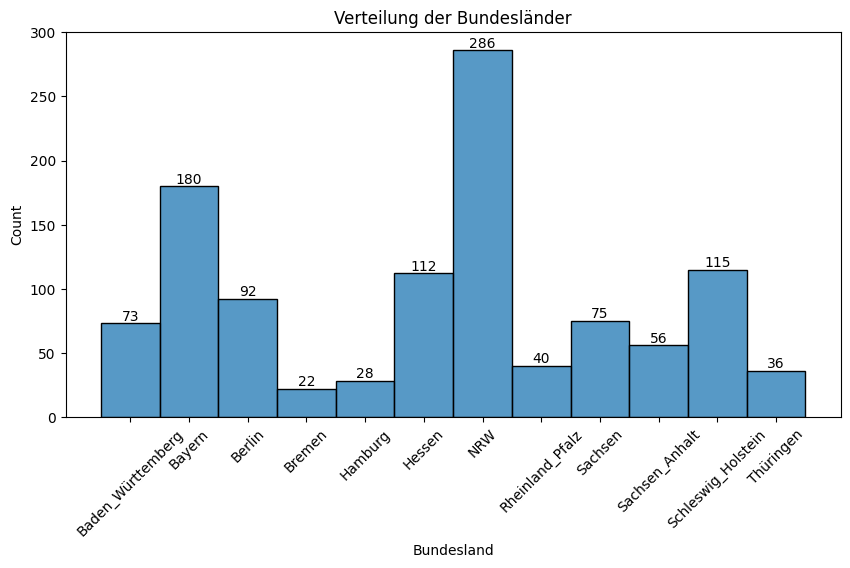

In [49]:
temp_group = df_daily.groupby("Filiale").agg({"Bundesland": "last"}).reset_index()
plt.figure(figsize=(10,5))
sns.histplot(temp_group.sort_values("Bundesland"), x="Bundesland")
plt.title("Verteilung der Bundesländer")
plt.xticks(rotation=45)
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), textcoords='offset points')
plt.show()

Die meisten Daten stammen aus NRW

### 3.3.5. <a id='toc3_3_5_'></a>temporale Features hinzufügen [&#9650;](#toc0_)

Da der Datensatz eine Zeitserie ist, werden temporale Features wie Monat und Kalenderwoche hinzugefügt.

In [50]:
df_daily["Jahr"] = df_daily.Datum.dt.year
df_daily["Quartal"] = df_daily.Datum.dt.quarter
df_daily["Monat"] = df_daily.Datum.dt.month
df_daily["Monatstag"] = df_daily.Datum.dt.day
df_daily["Kalenderwoche"] = df_daily.Datum.dt.isocalendar().week
df_daily.columns

Index(['Filiale', 'Wochentag', 'Datum', 'Umsatz', 'Kundenzahl', 'Geöffnet',
       'Promo', 'Schulferien', 'Umsatz_pro_Tag', 'Kunden_pro_Tag',
       'Umsatz_pro_Kunde', 'Geschäftstyp', 'Sortiment', 'Wettbew_Distanz',
       'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr', 'Promo2',
       'Promo2_seit_Woche', 'Promo2_seit_Jahr', 'Promo2_Intervall', 'Ostern',
       'Weihnachten', 'regulärer_Tag', 'öffentl_Feiertag', 'ist_Promo2',
       'Promo2_seit_Wochen', 'Wettbew_seit_Monaten', 'Bundesland', 'Jahr',
       'Quartal', 'Monat', 'Monatstag', 'Kalenderwoche'],
      dtype='object')

Manche Filialen haben Sonntags offen, daher wird eine entsprechende Spalte mit 1=sonntag_geöffnet und 0=geschlossen erstellt

In [51]:

# Mapping von Sonntag geöffnet
df_daily["Sonntag"] = np.where((df_daily.Wochentag == 7) & (df_daily.Geöffnet == 1), 1, 0)
round(df_daily.Sonntag.describe())


count    1017209.0
mean           0.0
std            0.0
min            0.0
25%            0.0
50%            0.0
75%            0.0
max            1.0
Name: Sonntag, dtype: float64

### 3.3.6. <a id='toc3_3_6_'></a>Datenpunkte ohne Umsätze rausfiltern [&#9650;](#toc0_)

In [52]:
# Kopie speichern bevor Filterung gespeichert wird
df_daily_vor_Filterung = df_daily.copy()
df_daily_vor_Filterung.to_parquet("..\\Save_files\\df_daily_vor_Filterung.parquet", engine='pyarrow')

# 0€ Umsatz Daten rausfiltern und als df_sales abspeichern
df_daily = df_daily[(df_daily.Umsatz != 0)]
round(df_daily.Umsatz.describe())


count    844338.0
mean       6956.0
std        3104.0
min          46.0
25%        4859.0
50%        6369.0
75%        8360.0
max       41551.0
Name: Umsatz, dtype: float64

Der Durchschnittle Umsatz liegt nun bei 6956 € und das Minimum bei 46 €.  
In der Grafik unten ist zu erkennen, dass einige Verkaufstage in Richtung  
0 neigen.

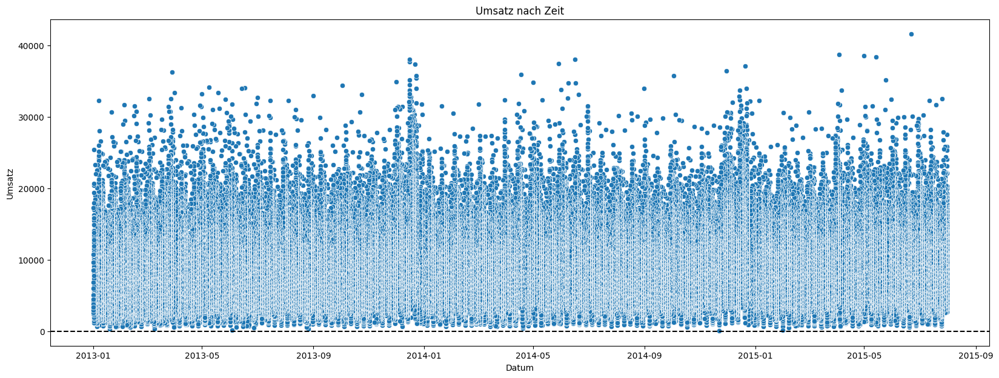

In [53]:
plt.figure(figsize=(20, 7))
sns.scatterplot(df_daily, x="Datum", y="Umsatz")
plt.title("Umsatz nach Zeit")
plt.axhline(0, color='black', linestyle='--')
plt.show()

In [54]:
print(df_daily.shape)
percent(df_daily)

(844338, 34)
Keine fehlenden Werte


,Total


### 3.3.7. <a id='toc3_3_7_'></a>aggregierte Ansicht [&#9650;](#toc0_)

In [55]:
df_agg = df_daily.copy()

# Listen mit Spaltennamen für Aggregationsfunktion "Summe" erstellen 
to_sum = ['Umsatz', 'Kundenzahl', "Umsatz_pro_Tag", "Umsatz_pro_Kunde", 'Kunden_pro_Tag', 'Geöffnet',
          'Promo', 'ist_Promo2', 'Schulferien', 
          'Ostern', 'Weihnachten', 'öffentl_Feiertag',
          'regulärer_Tag', "Sonntag"]

# zweite Liste für Aggregationsfunktion "leter Wert"
to_last = ['Geschäftstyp', 'Sortiment', "Bundesland",
           'Wettbew_Distanz', 'Wettbew_seit_Monaten',
           'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr',
           'Promo2', 'Promo2_Intervall', 'Promo2_seit_Wochen', 
           'Promo2_seit_Woche','Promo2_seit_Jahr']

# Aggregationsfunktionen für die Spalten
agg_funcs = {col: 'sum' for col in to_sum}
agg_funcs.update({col: 'last' for col in to_last})

# Nach store aggregieren
df_agg = df_agg.sort_values(["Filiale", "Datum"])
df_agg = df_agg.groupby("Filiale").agg(agg_funcs).reset_index()

# sortieren
df_agg = df_agg.sort_values(["Filiale"])

df_agg.head(5)

,Filiale,Umsatz,Kundenzahl,Umsatz_pro_Tag,Umsatz_pro_Kunde,Kunden_pro_Tag,Geöffnet,Promo,ist_Promo2,Schulferien,Ostern,Weihnachten,öffentl_Feiertag,regulärer_Tag,Sonntag,Geschäftstyp,Sortiment,Bundesland,Wettbew_Distanz,Wettbew_seit_Monaten,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_Intervall,Promo2_seit_Wochen,Promo2_seit_Woche,Promo2_seit_Jahr
0,1,3716854,440523,3716854.0,6554.962733,440523.0,781,350,0,160,0.0,0.0,0.0,781.0,0,c,basic,Hessen,1270,84,9,2008,0,0,0,0,0
1,2,3883858,457855,3883858.0,6592.219192,457855.0,784,354,284,153,0.0,0.0,2.0,782.0,0,a,basic,Thüringen,570,94,11,2007,1,"Jan,Apr,Jul,Oct",280,13,2010
2,3,5408261,584310,5408261.0,7102.609730,584310.0,779,350,284,156,0.0,0.0,0.0,779.0,0,a,basic,NRW,14130,105,12,2006,1,"Jan,Apr,Jul,Oct",227,14,2011
3,4,7556507,1036254,7556507.0,5683.864617,1036254.0,784,353,0,159,0.0,0.0,0.0,784.0,0,c,extended,Berlin,620,71,9,2009,0,0,0,0,0
4,5,3642818,418588,3642818.0,6708.147434,418588.0,779,351,0,156,0.0,0.0,3.0,776.0,0,a,basic,Sachsen,29910,4,4,2015,0,0,0,0,0


### 3.3.8. <a id='toc3_3_8_'></a>Gruppierung basierend auf Umsatz pro Kunde [&#9650;](#toc0_)

Die Filialen werden basierend auf dem Spalte Umsatz pro Kunde unterteilt. Dabei werden folgende Quantile benutzt [0, 0.01, 0.11, 0.5, 0.89, 0.99, 1]. Da wir die Daten später für das Trainieren der ML Modelle in train und test Datensätze aufteilen werden, splitten wir die Daten jetzt schon und erstellen die Gruppierung. Für die EDA arbeiten wir dann mit dem Gesamten Datensatz.

Zunächst df_daily splitten und aggregieren, wie oben.

In [56]:
# Splitten
timestamp = pd.Timestamp(df_daily["Datum"].sort_values().iloc[-1])
split_point = timestamp - pd.Timedelta(days=(7*8))
df_train_group = df_daily[df_daily["Datum"] < split_point].reset_index(drop=True).copy()


# Listen mit Spaltennamen für Aggregationsfunktion erstellen 
to_sum = ['Umsatz', 'Kundenzahl', "Umsatz_pro_Tag", "Umsatz_pro_Kunde", 'Umsatz_pro_Kunde', 'Geöffnet',
          'Promo', 'ist_Promo2', 'Schulferien', 
          'Ostern', 'Weihnachten', 'öffentl_Feiertag',
          'regulärer_Tag', "Sonntag"]

# zweite Liste für Aggregationsfunktion
to_last = ['Geschäftstyp', 'Sortiment', "Bundesland",
           'Wettbew_Distanz', 'Wettbew_seit_Monaten',
           'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr',
           'Promo2', 'Promo2_Intervall', 'Promo2_seit_Wochen', 
           'Promo2_seit_Woche','Promo2_seit_Jahr']

# Aggregationsfunktionen für die Spalten
agg_funcs = {col: 'sum' for col in to_sum}
agg_funcs.update({col: 'last' for col in to_last})

# Nach store aggregieren
df_train_group = df_train_group.sort_values(["Filiale", "Datum"])
df_train_group = df_train_group.groupby("Filiale").agg(agg_funcs).reset_index()

# sortieren
df_train_group = df_train_group.sort_values(["Filiale"])

df_train_group.head(5)

,Filiale,Umsatz,Kundenzahl,Umsatz_pro_Tag,Umsatz_pro_Kunde,Geöffnet,Promo,ist_Promo2,Schulferien,Ostern,Weihnachten,öffentl_Feiertag,regulärer_Tag,Sonntag,Geschäftstyp,Sortiment,Bundesland,Wettbew_Distanz,Wettbew_seit_Monaten,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_Intervall,Promo2_seit_Wochen,Promo2_seit_Woche,Promo2_seit_Jahr
0,1,3502610,415805,3502610.0,6132.263922,732,329,0,155,0.0,0.0,0.0,732.0,0,c,basic,Hessen,1270,82,9,2008,0,0,0,0,0
1,2,3643513,428945,3643513.0,6180.216263,735,333,257,138,0.0,0.0,2.0,733.0,0,a,basic,Thüringen,570,92,11,2007,1,"Jan,Apr,Jul,Oct",271,13,2010
2,3,5066447,549647,5066447.0,6624.708435,730,329,257,131,0.0,0.0,0.0,730.0,0,a,basic,NRW,14130,103,12,2006,1,"Jan,Apr,Jul,Oct",218,14,2011
3,4,7076699,974228,7076699.0,5306.862810,735,332,0,147,0.0,0.0,0.0,735.0,0,c,extended,Berlin,620,70,9,2009,0,0,0,0,0
4,5,3420909,393378,3420909.0,6279.481598,730,330,0,141,0.0,0.0,3.0,727.0,0,a,basic,Sachsen,29910,2,4,2015,0,0,0,0,0


Filialen den Gruppen zuweisen

In [57]:

# Grenzen für die Gruppen basierend auf Quantilen
df_train_group['Gruppe'] = pd.qcut(df_train_group['Umsatz_pro_Tag'], q=[0, 0.01, 0.11, 0.5, 0.89, 0.99, 1], labels=["Niedrigste 1%", "Niedrig", "Unteres Mittelfeld", "Oberes Mittelfeld", "Hoch", "Höchste 1%"])
# Definiere die Reihenfolge der Kategorien
category_order = ["Niedrigste 1%", "Niedrig", "Unteres Mittelfeld", "Oberes Mittelfeld", "Hoch", "Höchste 1%"]
df_train_group["Gruppe"] = pd.Categorical(df_train_group["Gruppe"], categories=category_order, ordered=True)

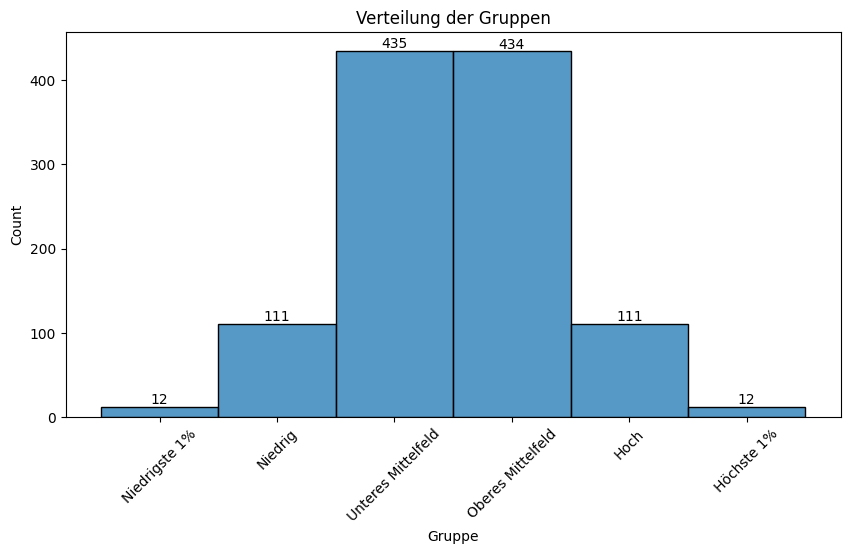

In [58]:
plt.figure(figsize=(10,5))
sns.histplot(df_train_group, x="Gruppe")
plt.title("Verteilung der Gruppen")
plt.xticks(rotation=45)
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), textcoords='offset points')
plt.show()

Gruppierung df_daily und df_agg hinzufügen

In [59]:
# Gruppe hinzufügen
df_daily = pd.merge(df_daily, df_train_group[["Filiale", "Gruppe"]], on="Filiale", how="left")
df_agg = pd.merge(df_agg, df_train_group[["Filiale", "Gruppe"]], on="Filiale", how="left")

### 3.3.9. <a id='toc3_3_9_'></a>dataframes als pkl abspeichern [&#9650;](#toc0_)

In [60]:
df_daily.to_parquet("..\\Save_files\\df_daily.parquet", engine='pyarrow')
df_agg.to_parquet("..\\Save_files\\df_agg.parquet", engine='pyarrow')

# 4. <a id='toc4_'></a>Explorative Datenanalyse [&#9650;](#toc0_)

In [61]:
df_daily = pd.read_parquet("..\\Save_files\\df_daily.parquet", engine='pyarrow')
df_agg = pd.read_parquet("..\\Save_files\\df_agg.parquet", engine='pyarrow')
df_daily_vor_Filterung = pd.read_parquet("..\\Save_files\\df_daily_vor_Filterung.parquet", engine='pyarrow')

## 4.1. <a id='toc4_1_'></a>Zielvariable [&#9650;](#toc0_)

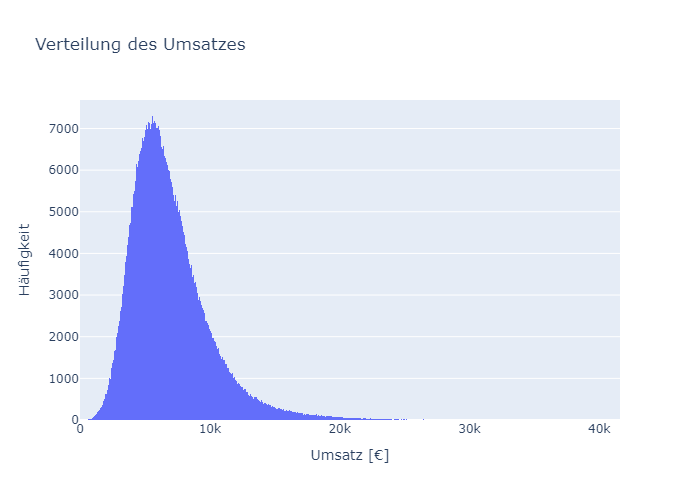

In [62]:
fig = px.histogram(df_daily, x="Umsatz", title=("Verteilung des Umsatzes"))
fig.update_layout(xaxis_title="Umsatz [€]", yaxis_title="Häufigkeit")
fig.show()

### 4.1.1. <a id='toc4_1_1_'></a>Korrelationen von Umsatz [&#9650;](#toc0_)

Nach der Einteilung von Cohen (1988) sind Korrelationen...  
- zwischen r = 0.1 und r = 0.3 als klein bis moderat,  
- Korrelationen zwischen r = 0.3 und r = 0.5 als moderat bis groß
- und ab r = 0.5 als groß einzuordnen.

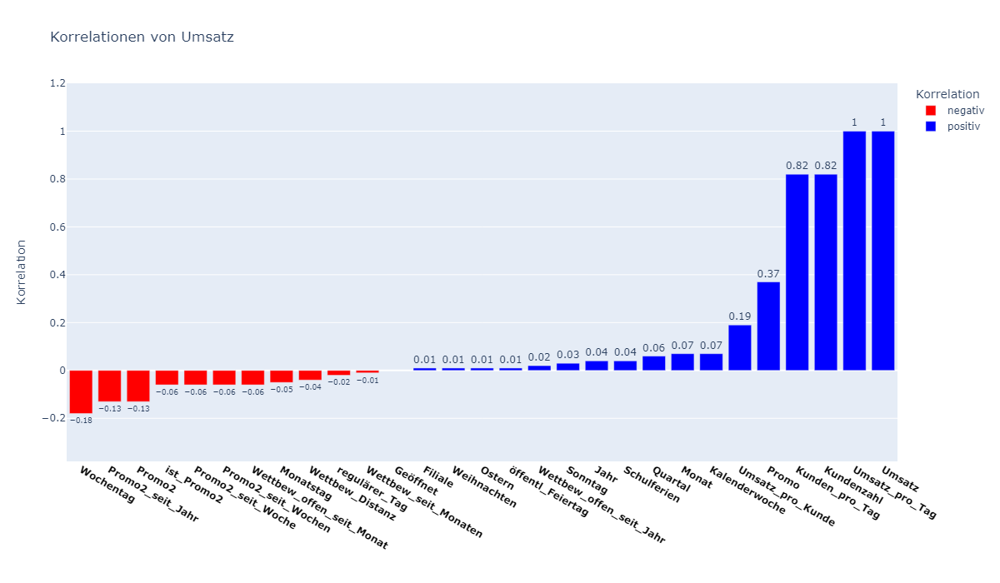

In [63]:
numeric = df_daily.select_dtypes(include=["number"])
# Korrelation
df_corr=numeric.corr()

# Korrelation berechnen für den Einfluss der Faktoren auf SalesPerDay
df_corr = round(df_corr["Umsatz"].sort_values().reset_index(), 2)

# Farben basierend auf den Werten zuweisen
df_corr['Korrelation'] = df_corr['Umsatz'].apply(lambda x: 'positiv' if x > 0 else 'negativ')

# Balkendiagramm erstellen
fig = px.bar(df_corr, 
             x='index', 
             y='Umsatz', 
             title='Korrelationen von Umsatz',
             color='Korrelation',
             color_discrete_map={'positiv': 'blue', 'negativ': 'red'},
             text_auto=True)
fig.update_layout(xaxis_title='', yaxis_title="Korrelation", height=700,  width=1200,
                  yaxis_range=[df_corr['Umsatz'].min() - 0.2, 1.2],
                  xaxis_tickfont=dict(size=12, color='black', weight='bold'))
fig.update_traces(textposition='outside', cliponaxis=False)

# Diagramm anzeigen
fig.show()
fig.write_image("..\\Ausgewählte_Plots\\Korrelationen_von_Umsatz.png")


Positiv:
- hohe Korrelation      = ["Kundenzahl"]
- mittlere Korrelation  = ["Promo"]  
  
Negativ:
- niedrige Korrelation  = ["Wochentag", "Promo2_seit_Jahr", "Promo2"]

### 4.1.2. <a id='toc4_1_2_'></a>Bivariate Analyse von Umsatz [&#9650;](#toc0_)

- Alle Daten sind ungleich verteilt
- "Wochentag"                   = meisten haben 6 Tage die Woche geöffnet, manche auch sonntags  
- 'Wettbew_Distanz'             = meisten haben niedrige Distanz zu Wettbewerben  
- 'Wettbew_offen_seit_Monat'    = September sind die meisten Neueröffnungen  
- 'Wettbew_offen_seit_Jahr'     = meisten Wettbewerber haben 2000-2020 geöffnet  
- 'Promo2'                      = mehr Filialen nehmen nicht an Promo2 teil  
- 'Jahr'                        = 2014 fehlen Daten und 2015 noch mehr  

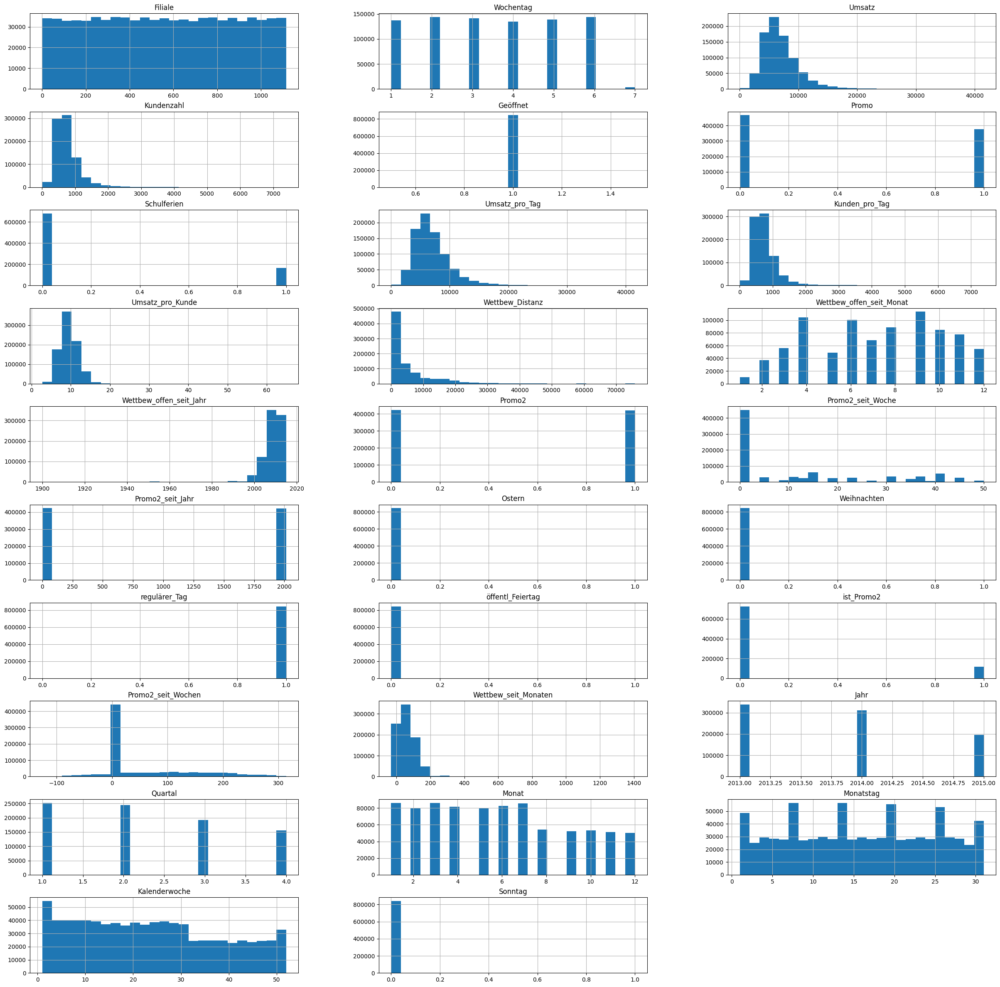

In [64]:
numerisch = df_daily.select_dtypes(include=["number"])
numerisch.hist(bins = 25, figsize = (30,30), layout = (10,3))
plt.show()

### 4.1.3. <a id='toc4_1_3_'></a>kategorische Variablen gegen Umsatz [&#9650;](#toc0_)

Im folgenden können wir die Summe vom Umsatz für die einzelnen kategorialen Variablen sehen, jedoch ist aufgrund der ungleichen Verteilung ein Vergleich auf Basis von Umsatz nicht möglich. Daher gehen wir im nächsten Abschnitt auf die *key performance indicators* (KPIs) ein.

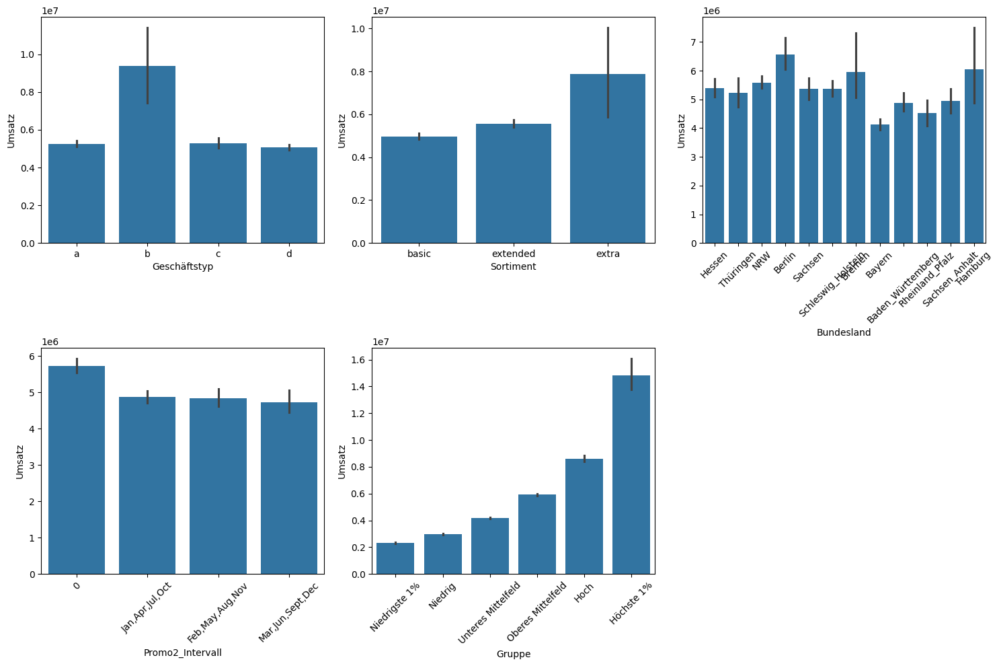

In [65]:
kategorisch = df_daily.select_dtypes(exclude=["number"])

plt.figure(figsize=(15, 10))

# Geschäftstyp
plt.subplot(2,3,1)
sns.barplot(df_agg.sort_values("Geschäftstyp"), x='Geschäftstyp', y="Umsatz");

# Sortiment
plt.subplot(2,3,2)
sns.barplot(df_agg, x='Sortiment', y="Umsatz");

# Bundesland
plt.subplot(2,3,3)
sns.barplot(df_agg, x='Bundesland', y="Umsatz");
plt.xticks(rotation=45)

# Promo2_Intervall
plt.subplot(2,3,4)
sns.barplot(df_agg, x='Promo2_Intervall', y="Umsatz");
plt.xticks(rotation=45)

# Gruppe
plt.subplot(2,3,5)
sns.barplot(df_agg, x='Gruppe', y="Umsatz");
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

## 4.2. <a id='toc4_2_'></a>KPIs [&#9650;](#toc0_)

Als *key performance indicators* (KPIs) werden Umsatz pro Tag, Kunden pro Tag und Umsatz pro Kunde verwendet.

### 4.2.1. <a id='toc4_2_1_'></a>Verlauf der KPIs [&#9650;](#toc0_)

Zunächst ist es wichtig zu wissen, wie hoch der Anteil an geschlossenen Filialen ist, sowie in welcher Zeit diese liegen.

In [66]:
def anteil_schließungen(df):
    # Vergleich der fehlenden Werte wegen Renovierung/Schließung
    df_sales_anteil = df_daily_vor_Filterung.copy()
    df_sales_anteil.set_index("Datum", inplace=True)
    df_sales_anteil = df_sales_anteil.groupby(["Filiale"]).resample("W")["Umsatz"].sum().reset_index()
    df_sales_anteil["Umsatz"] = df_sales_anteil["Umsatz"].replace({0: np.nan, 3: np.nan})
    df_sales_anteil["Woche"] = df_sales_anteil.Datum.dt.isocalendar().week
    df_sales_anteil["Quartal"] = df_sales_anteil.Datum.dt.quarter

        # Funktion zur Berechnung des Anteils der Wochen ohne Verkäufe
    def berechne_anteil(dfx, jahr, quartal):
        dfx_jahr_quartal = dfx[(dfx.Datum.dt.year == jahr) & (dfx.Datum.dt.quarter == quartal)]
        anteil = round(dfx_jahr_quartal.Umsatz.isnull().sum() / dfx_jahr_quartal.Umsatz.count() * 100, 2)
        return anteil

    # Neue Spalte mit dem Anteil der Wochen ohne Verkäufe hinzufügen
    df["Anteil_Schließungen"] = 0.0

    for jahr in [2013, 2014, 2015]:
        for quartal in [1, 2, 3, 4]:
            anteil = berechne_anteil(df_sales_anteil, jahr, quartal)
            df.loc[(jahr, quartal), "Anteil_Schließungen"] = float(anteil)
            if jahr == 2015 and quartal == 3:
                break
    return df

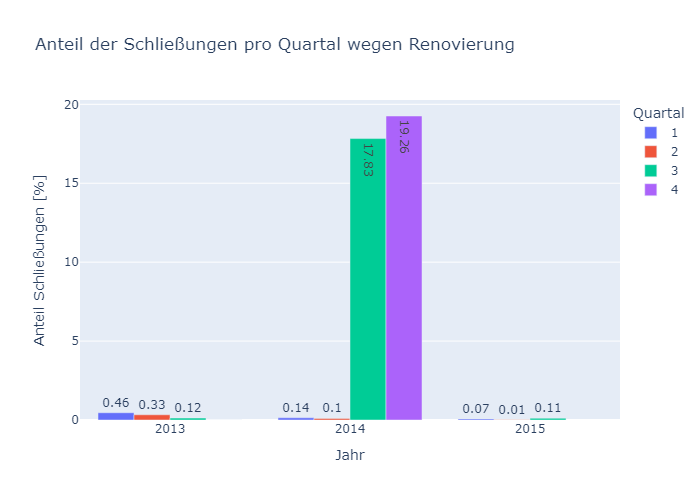

In [67]:
# Anteil Schließungen
df_tempos_closed = df_daily.groupby(["Jahr", "Quartal"]).agg({"Geöffnet": "sum", "Umsatz": "sum", "Kundenzahl": "sum"})
df_tempos_closed = anteil_schließungen(df_tempos_closed).reset_index()
df_tempos_closed.Quartal = df_tempos_closed.Quartal.astype("str")

px.bar(df_tempos_closed, x="Jahr", y="Anteil_Schließungen", color="Quartal",  barmode="group", text_auto=True,
       title="Anteil der Schließungen pro Quartal wegen Renovierung ", labels={"Anteil_Schließungen": "Anteil Schließungen [%]"}, width=700)

Fast alle Schließungen sind im 3ten und 4ten Quartal des Jahres 2014.

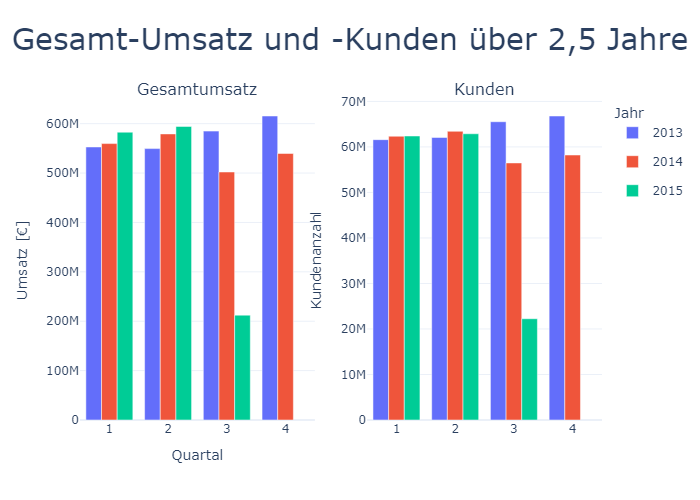

In [68]:
df_tempos = df_daily.copy()
df_tempos = df_tempos.groupby(["Jahr", "Quartal"]).agg({"Umsatz": "sum", "Kundenzahl": "sum"}).reset_index()
df_tempos.Jahr = df_tempos.Jahr.astype(str)


# Subplots erstellen
fig = make_subplots(rows=1, cols=2, subplot_titles=("Gesamtumsatz","Kunden"))

fig1 = px.bar(df_tempos, x="Quartal", y="Umsatz", color="Jahr", barmode="group")
for trace in fig1['data']:
    trace['showlegend'] = True 
    fig.add_trace(trace, row=1, col=1) 

fig2 = px.bar(df_tempos, x="Quartal", y="Kundenzahl", color="Jahr", barmode="group")
for trace in fig2['data']:
    trace['showlegend'] = False 
    fig.add_trace(trace, row=1, col=2) 
    
fig.update_layout(title_text="Gesamt-Umsatz und -Kunden über 2,5 Jahre", title_font_size=30, title_x=0.5, template="plotly_white",
                  xaxis1_title="Quartal", yaxis1_title="Umsatz [€]",
                  xaxis2_title="", yaxis2_title="Kundenanzahl",
                  legend_title="Jahr")
fig.show()

Der Gesamtumsatz steigt im Laufe des Jahres 2013. Dieser Trend folgt für 2014 und 2015 mit erhöhten Werten. Aufgrund von temporären Schließungen ist der Verkauf im 2ten Halbjahr des Jahres 2014 zurückgegangen. Daten von 2015 gehen nur bis 31.07.2015, weshalb das 3te Quartal so niedrig ausfällt. Als nächstes schauen wir uns den Jahresverlauf der KPIs.

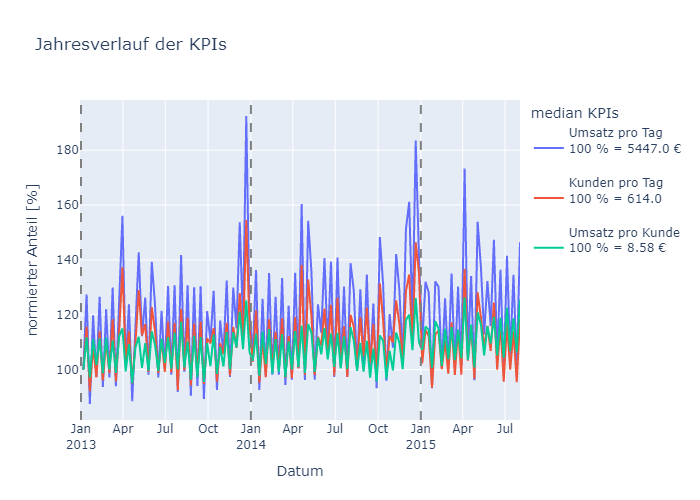

In [69]:
df_tempos = df_daily.copy()
df_tempos.set_index("Datum", inplace=True)
# Jährlich
df_tempos = df_tempos.resample("W").agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).sort_index().reset_index()
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)

# normieren auf ersten wert
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100, 2)

# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Datum"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")

# plotten
fig = px.line(df_tempos_melt, x="Datum", y="Anteil", color="KPIs",
              title = "Jahresverlauf der KPIs", labels={"Anteil": "normierter Anteil [%]", "KPIs": "median KPIs"})

# Variablen in der Legende umbenennen
fig.for_each_trace(lambda trace: trace.update(name=trace.name.replace("Umsatz pro Tag", f"Umsatz pro Tag<br>100 % = {df_tempos.Umsatz_pro_Tag.iloc[0]} €<br>")
                                              .replace("Kunden pro Tag", f"Kunden pro Tag<br>100 % = {df_tempos.Kunden_pro_Tag.iloc[0]} <br>")
                                              .replace("Umsatz pro Kunde", f"Umsatz pro Kunde<br>100 % = {df_tempos.Umsatz_pro_Kunde.iloc[0]} €<br>")
                                              ))
# Vertikale linien für jedes jahr
for year in [2013, 2014, 2015]:
    fig.add_vline(x=pd.Timestamp(f'{year}-01-01'), line=dict(dash='dash', color='gray'))

# jeden 3ten Monat zeigen    
fig.update_xaxes(tickformat="%b\n%Y", dtick="M3")
    
fig.show()
fig.write_image("..\\Ausgewählte_Plots\\Jahresverlauf_der_KPIs.png")

Die KPIs zeigen einen deutlichen Trend in Richtung Weihnachten mit zusätzlichen Peaks im 2ten Quartal. Um den Zeitraum besser zu erkennen, schauen wir uns den Verlauf auf monatlicher Basis an.  


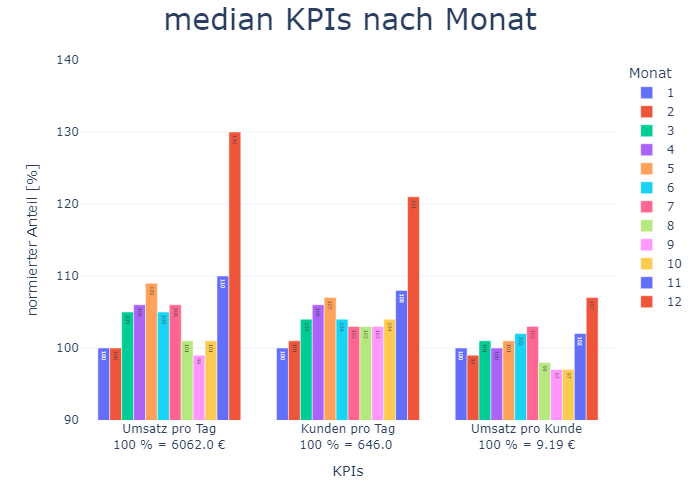

In [70]:
df_tempos = df_daily.copy()
df_tempos = df_tempos.groupby(["Monat"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).sort_index().reset_index()
df_tempos.Monat = df_tempos.Monat.astype(str)

# normieren auf ersten wert
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100)


# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Monat"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")

# plotten
fig = px.bar(df_tempos_melt, x="KPIs", y="Anteil", color="Monat", barmode="group", text_auto=True)

fig.update_layout(title_text="median KPIs nach Monat", title_font_size=30, title_x=0.5, template="plotly_white",
                  yaxis1_title="normierter Anteil [%]", yaxis=dict(range=[90, 140]),
                  showlegend=True)
fig.update_xaxes(ticktext=[f"Umsatz pro Tag<br>100 % = {df_tempos.Umsatz_pro_Tag.iloc[0]} €<br>",
                           f"Kunden pro Tag<br>100 % = {df_tempos.Kunden_pro_Tag.iloc[0]} <br>",
                           f"Umsatz pro Kunde<br>100 % = {df_tempos.Umsatz_pro_Kunde.iloc[0]} €<br>"],
                 tickvals=["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"])
# Variablen in der Legende umbenennen

 
fig.show()


Der Umsatz steigt bis Mai, fällt dann bis September auf ein Minimum und erreicht das Maximum von 130 % im Dezember. Um welche Wochen es sich genau habdelt, können wir in der unteren Abbildung sehen.  


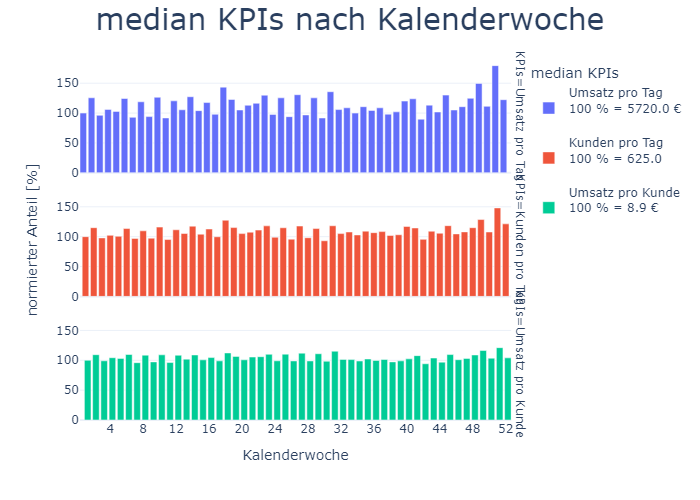

In [71]:
df_tempos = df_daily.copy()
df_tempos = df_tempos.groupby(["Kalenderwoche"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).sort_index().reset_index()


# normieren auf ersten wert
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100, 2)


# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Kalenderwoche"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")

# plotten
fig = px.bar(df_tempos_melt, x="Kalenderwoche", y="Anteil", color="KPIs", barmode="group", facet_row="KPIs")

fig.update_layout(title_text="median KPIs nach Kalenderwoche", title_font_size=30, title_x=0.5, template="plotly_white",
                  xaxis1_title="Kalenderwoche", yaxis1_title="",
                  yaxis3_title="", yaxis2_title="normierter Anteil [%]",
                  legend_title="median KPIs")

fig.update_traces(width=0.8)
fig.update_xaxes(dtick=4)
# Variablen in der Legende umbenennen
fig.for_each_trace(lambda trace: trace.update(name=trace.name.replace("Umsatz pro Tag", f"Umsatz pro Tag<br>100 % = {df_tempos.Umsatz_pro_Tag.iloc[0]} €<br>")
                                              .replace("Kunden pro Tag", f"Kunden pro Tag<br>100 % = {df_tempos.Kunden_pro_Tag.iloc[0]} <br>")
                                              .replace("Umsatz pro Kunde", f"Umsatz pro Kunde<br>100 % = {df_tempos.Umsatz_pro_Kunde.iloc[0]} €<br>")
                                              ))   
 
fig.show()


Die KPIs sind in der 51ten Woche am Maximum. Das zweite Maximum liegt in Woche 18 (ungefähr zur Osterzeit). Das Minimum liegt in der 42ten Woche.  

### 4.2.2. <a id='toc4_2_2_'></a>KPIs nach Tagen [&#9650;](#toc0_)

Um Trends innerhalb eines Monats und einer Kalenderwoche zu untersuchen, schauen wir und die KPIS nochmals im Detail an.

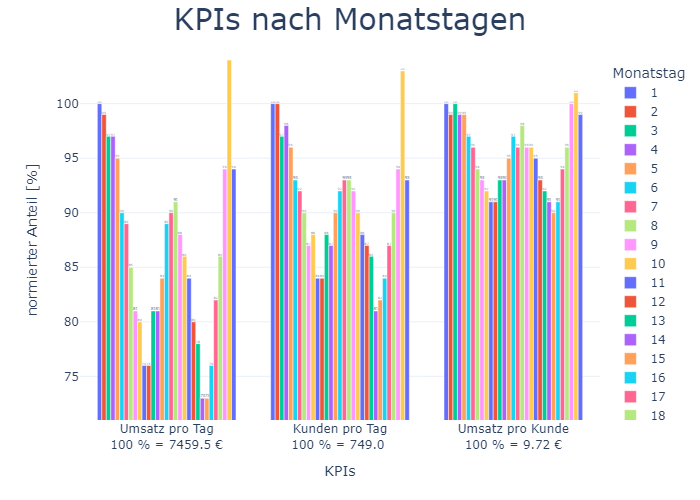

In [72]:
df_tempos = df_daily.copy()
df_tempos = df_tempos.groupby(["Monatstag"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).sort_index().reset_index()


# normieren auf ersten wert
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100)


# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Monatstag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_tempos_melt.Monatstag = df_tempos_melt.Monatstag.astype("str")

# Plotten
fig= px.bar(df_tempos_melt, x="KPIs", y="Anteil", color="Monatstag", barmode="group", text_auto=True)

# Variablen in der Legende umbenennen
fig.update_layout(title_text="KPIs nach Monatstagen", title_font_size=30, title_x=0.5, template="plotly_white",
                  yaxis1_title="normierter Anteil [%]",
                  yaxis1=dict(range=[71, 104]))

    
fig.update_xaxes(ticktext=[f"Umsatz pro Tag<br>100 % = {df_tempos.Umsatz_pro_Tag.iloc[0]} €<br>",
                           f"Kunden pro Tag<br>100 % = {df_tempos.Kunden_pro_Tag.iloc[0]} <br>",
                           f"Umsatz pro Kunde<br>100 % = {df_tempos.Umsatz_pro_Kunde.iloc[0]} €<br>"],
                 tickvals=["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"])
fig.show()

Der Monat beginnt hoch und fällt bis zum 12ten steil runter. Am 18ten gibt es einen niedrigeren Peak als am Anfang des Monats. Der 30te ist der verkaufsstärkste Tag. Auf Quartalsebene sieht dies etwas anders aus.

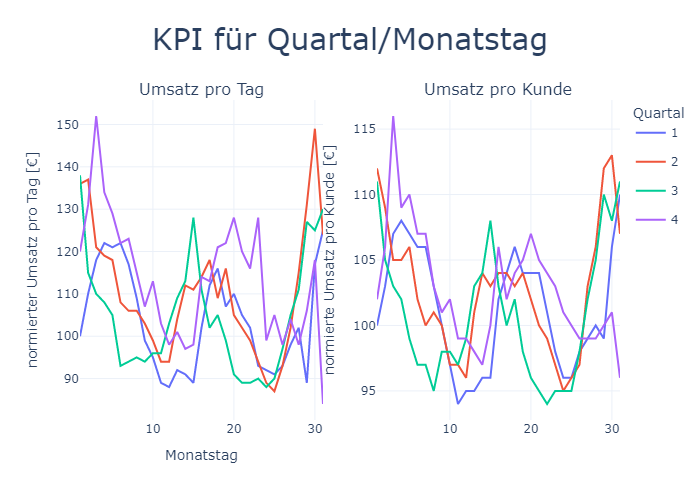

In [73]:
df_tempos = df_daily.copy()
df_tempos = df_tempos.groupby(["Quartal", "Monatstag"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).sort_index().reset_index()


# normieren auf ersten wert
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100)


# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Quartal", "Monatstag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_tempos_melt.Monatstag = df_tempos_melt.Monatstag.astype("str")

# Daten neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Quartal", "Monatstag"], value_name="Prozent", value_vars=metriken_normiert, var_name="KPI")

# Subplots erstellen
fig = make_subplots(rows=1, cols=2, subplot_titles=("Umsatz pro Tag", "Umsatz pro Kunde"))

df_tempos.Quartal = df_tempos.Quartal.astype("str")
fig1= px.line(df_tempos, x="Monatstag", y="Umsatz pro Tag", color="Quartal")
for trace in fig1["data"]:
    trace["showlegend"]=False
    fig.add_trace(trace, row=1, col=1)

fig2= px.line(df_tempos, x="Monatstag", y="Umsatz pro Kunde", color="Quartal")
for trace in fig2["data"]:
    fig.add_trace(trace, row=1, col=2)
    
# Layout anpassen
fig.update_layout(title_text="KPI für Quartal/Monatstag", title_font_size=30, title_x=0.5, template="plotly_white",
                  xaxis1_title="Monatstag", yaxis1_title="normierter Umsatz pro Tag [€]",
                  xaxis2_title="", yaxis2_title="normierte Umsatz pro Kunde [€]",
                  legend_title="Quartal")



Der Peak in der Mitte des Monats hält ein paar Tage länger im virten Quartal. Quartal 4 hat außerdem von allen Quartalen den höchsten Umsatz am Anfang des Monats. Das Ende des Monats sieht für Quartal 2 am besten aus. Im Weiteren schauen wir uns die KPIS auf Wochenebene an.  

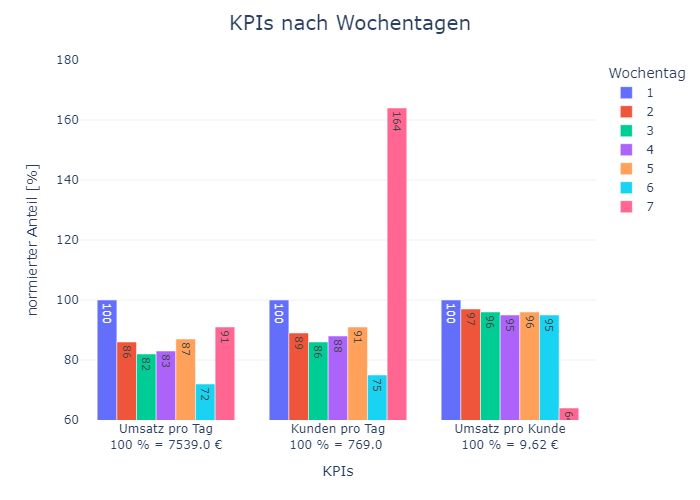

In [74]:
df_tempos = df_daily.copy()
df_tempos = df_tempos.groupby(["Wochentag"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).sort_index().reset_index()


# normieren auf ersten wert
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100)


# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Wochentag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_tempos_melt.Wochentag = df_tempos_melt.Wochentag.astype("str")

# Plotten
fig= px.bar(df_tempos_melt, x="KPIs", y="Anteil", color="Wochentag", barmode="group", text_auto=True)

# Variablen in der Legende umbenennen
fig.update_layout(title_text="KPIs nach Wochentagen", title_font_size=20, title_x=0.5, template="plotly_white",
                  yaxis1_title="normierter Anteil [%]",
                  yaxis1=dict(range=[60, 180]))

    
fig.update_xaxes(ticktext=[f"Umsatz pro Tag<br>100 % = {df_tempos.Umsatz_pro_Tag.iloc[0]} €<br>",
                           f"Kunden pro Tag<br>100 % = {df_tempos.Kunden_pro_Tag.iloc[0]} <br>",
                           f"Umsatz pro Kunde<br>100 % = {df_tempos.Umsatz_pro_Kunde.iloc[0]} €<br>"],
                 tickvals=["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"])
fig.show()

Die meisten Kunden gehen Sonntags zu Rossmann, jedoch ist der Verkaufsstärkste Tag Montag  

### 4.2.3. <a id='toc4_2_3_'></a>Irreguläre Tage [&#9650;](#toc0_)

Wir betrachten die Feiertage ohne Promo und Promo2.

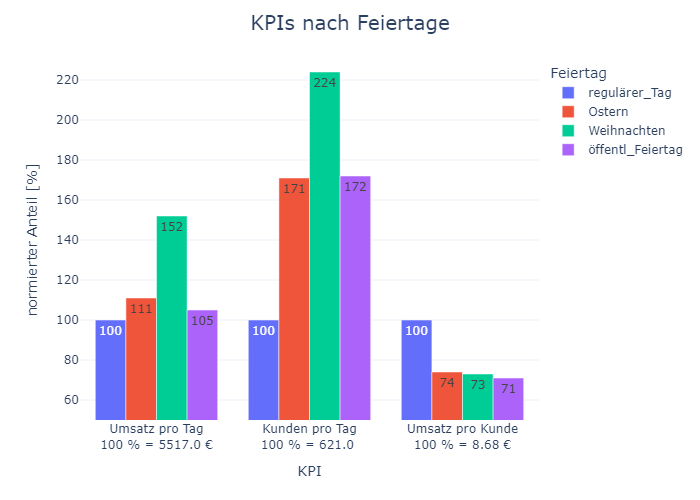

In [75]:
df_tempos = df_daily.copy()
df_tempos = df_tempos[(df_tempos.ist_Promo2 == 0) & (df_tempos.Promo == 0)]
df_tempos['Feiertag'] = df_tempos[["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]].idxmax(axis=1)
# Kategorien in der gewünschten Reihenfolge definieren
categories = ["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]
df_tempos['Feiertag'] = pd.Categorical(df_tempos['Feiertag'], categories=categories, ordered=True)

df_tempos = df_tempos.groupby(["Feiertag"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()



# normieren auf ersten wert
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100)

# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Feiertag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")

fig = px.bar(df_tempos_melt, x="KPIs", y="Anteil", color="Feiertag", barmode="group", text_auto="all")

# Variablen in der Legende umbenennen
fig.update_xaxes(ticktext=[f"Umsatz pro Tag<br>100 % = {df_tempos.Umsatz_pro_Tag.iloc[0]} €<br>",
                           f"Kunden pro Tag<br>100 % = {df_tempos.Kunden_pro_Tag.iloc[0]} <br>",
                           f"Umsatz pro Kunde<br>100 % = {df_tempos.Umsatz_pro_Kunde.iloc[0]} €<br>"],
                 tickvals=["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"])
fig.update_layout(title_text="KPIs nach Feiertage", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis_title="KPI", yaxis1_title="normierter Anteil [%]",
                  yaxis1=dict(range=[50, 230]))
    
fig.show()

An Weihnachten steigt der Umsatz um 52% und die Kundenzahl steigt mehr als doppelt so hoch wie an einem regulären Tag. Dafür fällt der Umsatz pro Kunde mit einem Tief an öffetlichen Feiertagen. 
Im Vergleich dazu sehen wir unten die Wirkung von Schulferien ohne Promo2 und Promo.  

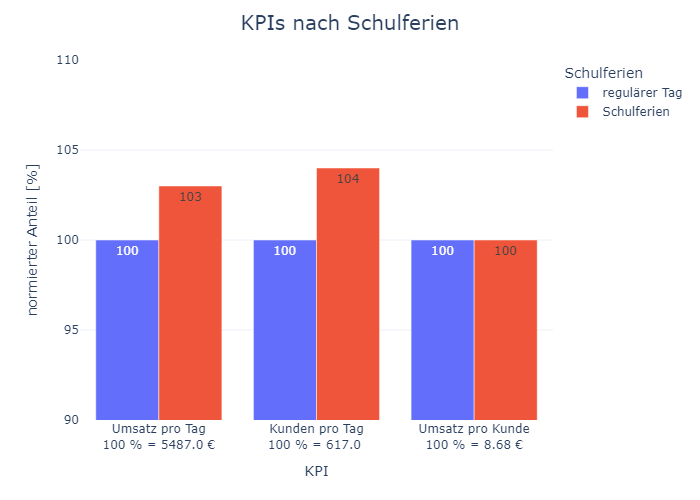

In [76]:
df_tempos = df_daily.copy()
df_tempos = df_tempos[(df_tempos.ist_Promo2 == 0) & (df_tempos.Promo == 0)]

df_tempos = df_tempos.groupby(["Schulferien"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_tempos["Umsatz_pro_Kunde"] = round(df_tempos["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_tempos[metriken_normiert] = round(df_tempos[metriken].div(df_tempos[metriken].iloc[0].values) * 100)

# df neu auslegen
df_tempos_melt = pd.melt(df_tempos, id_vars=["Schulferien"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_tempos_melt.Schulferien = df_tempos_melt.Schulferien.replace({0: "regulärer Tag", 1: "Schulferien"})

# Plotten
fig = px.bar(df_tempos_melt, x="KPIs", y="Anteil", color="Schulferien", barmode="group", text_auto="all")

# Variablen in der Legende umbenennen

fig.update_layout(title_text="KPIs nach Schulferien", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis_title="KPI", yaxis1_title="normierter Anteil [%]",
                  yaxis1=dict(range=[90, 110]))

fig.update_xaxes(ticktext=[f"Umsatz pro Tag<br>100 % = {df_tempos.Umsatz_pro_Tag.iloc[0]} €<br>",
                           f"Kunden pro Tag<br>100 % = {df_tempos.Kunden_pro_Tag.iloc[0]} <br>",
                           f"Umsatz pro Kunde<br>100 % = {df_tempos.Umsatz_pro_Kunde.iloc[0]} €<br>"],
                 tickvals=["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"])
    
fig.show()



KPIs steigen nur minimal während der Schulferien.  

## 4.3. <a id='toc4_3_'></a>Promo [&#9650;](#toc0_)

### 4.3.1. <a id='toc4_3_1_'></a>Korrelationen von Promo [&#9650;](#toc0_)

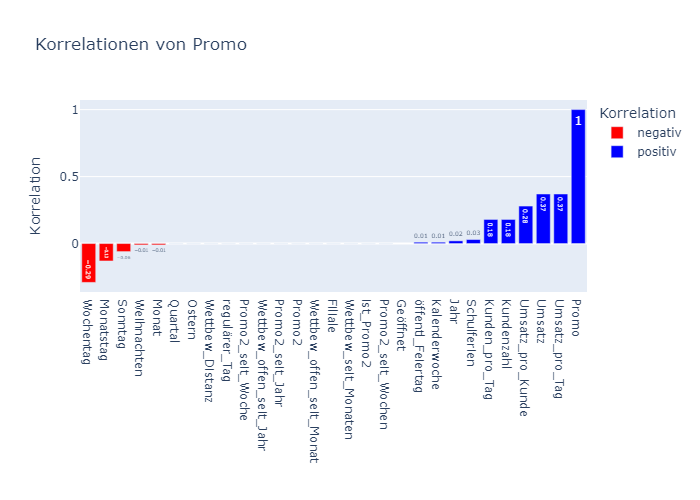

In [77]:
# Korrelation
df_corr=numeric.corr()

# Korrelation berechnen für den Einfluss der Faktoren auf SalesPerDay
df_corr = round(df_corr["Promo"].sort_values().reset_index(), 2)

# Farben basierend auf den Werten zuweisen
df_corr['Korrelation'] = df_corr['Promo'].apply(lambda x: 'positiv' if x > 0 else 'negativ')

# Balkendiagramm erstellen
fig = px.bar(df_corr, 
             x='index', 
             y='Promo', 
             title='Korrelationen von Promo',
             color='Korrelation',
             color_discrete_map={'positiv': 'blue', 'negativ': 'red'},
             text_auto=True)
fig.update_layout(xaxis_title='', yaxis_title="Korrelation")

# Diagramm anzeigen
fig.show()


Promo korrelirt nur wenig mit Kundenzahl und Umsatz_pro_Kunde und mittel mit Umsatz. Eine negative mittlere Korrelation ist bei Wochentag sichtbar.  

### 4.3.2. <a id='toc4_3_2_'></a>Jahresverlauf [&#9650;](#toc0_)

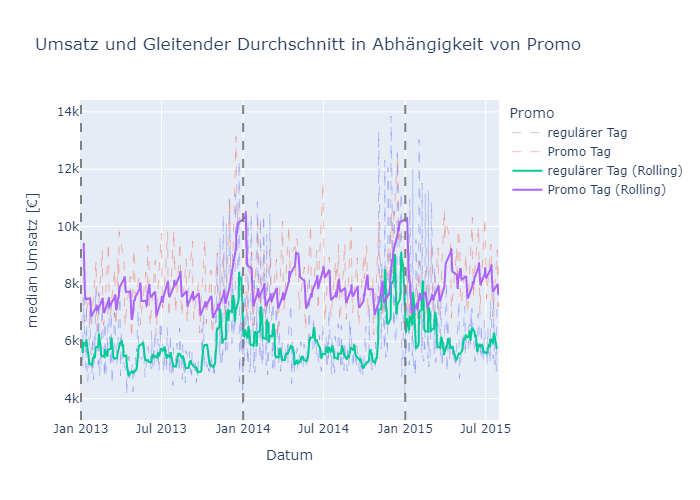

In [78]:
df_promo = df_daily.copy()
df_promo.set_index("Datum", inplace=True)
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.ist_Promo2 == 0)]
df_promo = df_promo.groupby(["Datum", "Promo"])["Umsatz"].median().reset_index()

# Gleitenden Durchschnitt berechnen
df_promo['Umsatz_rolling'] = df_promo.groupby('Promo')['Umsatz'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())
df_promo.Promo = df_promo.Promo.replace({0: "regulärer Tag", 1: "Promo Tag"})

# Liniendiagramm für Umsatz erstellen
fig = px.line(df_promo, x="Datum", y="Umsatz", color="Promo",
              title="Umsatz und Gleitender Durchschnitt in Abhängigkeit von Promo", labels={"Umsatz": "median Umsatz [€]"})

# Linien von px.line gestrichelt machen
for trace in fig.data:
    trace.update(line=dict(dash='dash', width=1), opacity=0.4)

# Gleitenden Durchschnitt als durchgängige Linie hinzufügen
for promo in df_promo['Promo'].unique():
    df_promo_promo = df_promo[df_promo['Promo'] == promo]
    fig.add_trace(go.Scatter(x=df_promo_promo['Datum'], y=df_promo_promo['Umsatz_rolling'], mode='lines', name=f'{promo} (Rolling)', line=dict(dash='solid')))

# Vertikale gestrichelte Linien zu Beginn jedes Jahres hinzufügen
years = pd.to_datetime(df_promo['Datum']).dt.year.unique()
for year in years:
    fig.add_vline(x=pd.Timestamp(f'{year}-01-01'), line=dict(dash='dash', color='gray'))

# Diagramm anzeigen
fig.show()
fig.write_image("..\\Ausgewählte_Plots\\Umsatz_und_Gleitender_Durchschnitt_in_Abhängig_von_Promo.png")

Während Promo läuft ist der Umsatz konsequent höher. Auch Promo weist saisonale Trends auf, besonders zur Weihanchts- und Osternzeit ist der Umsatz höher. Dies wird auf wöchentlicher sicht nochmal deutlicher.  

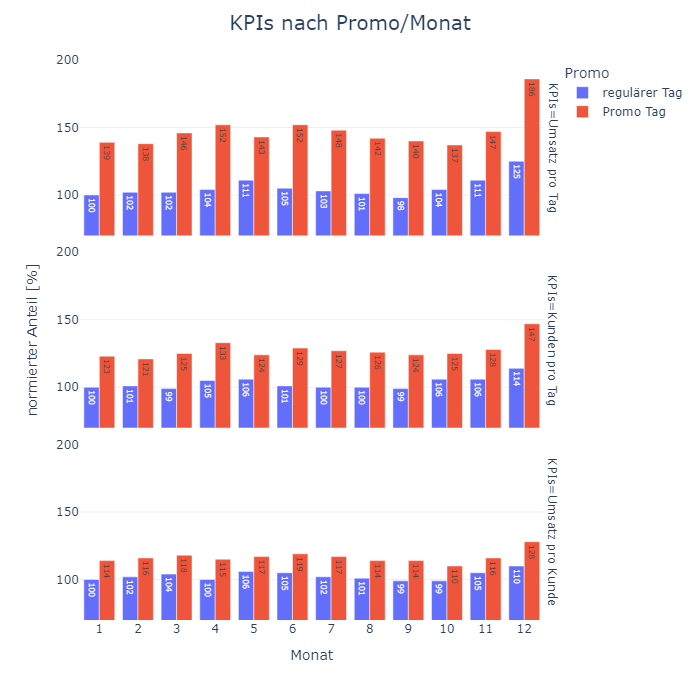

In [79]:
# Nur reguläre Tage
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.ist_Promo2 == 0)]

df_promo = df_promo.groupby(["Promo", "Monat"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["Promo", "Monat"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.Promo = df_promo_melt.Promo.replace({0: "regulärer Tag", 1: "Promo Tag"})
df_promo_melt.Monat = df_promo_melt.Monat.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Monat", y="Anteil", color="Promo", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Promo/Monat", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[70, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Alle KPIs sind erhöht während Promo läuft. Am meisten Profitiert Umsatz pro Tag. Die Stärkste Wirkung erzielt Promo im Dezember und Juni und April.  

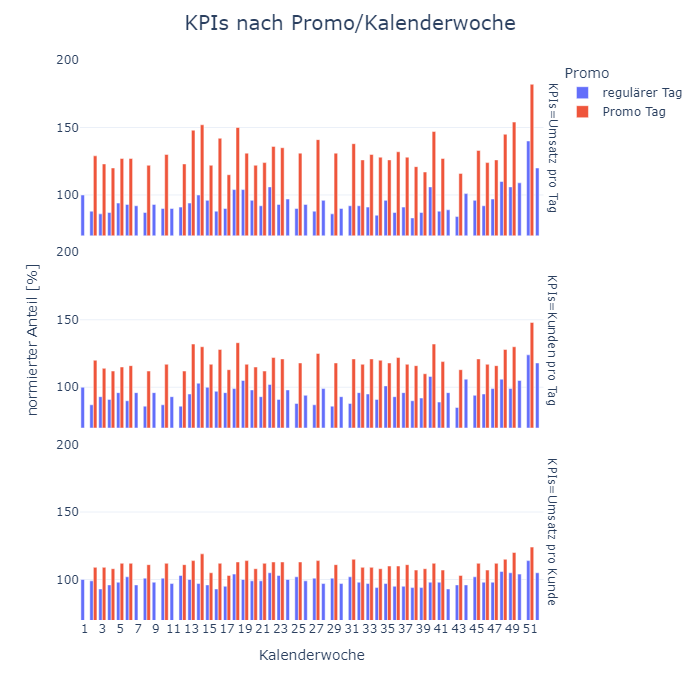

In [80]:
# Nur reguläre Tage und keine Schulferien
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.ist_Promo2 == 0)]

df_promo = df_promo.groupby(["Promo", "Kalenderwoche"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["Promo", "Kalenderwoche"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.Promo = df_promo_melt.Promo.replace({0: "regulärer Tag", 1: "Promo Tag"})
df_promo_melt.Kalenderwoche = df_promo_melt.Kalenderwoche.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Kalenderwoche", y="Anteil", color="Promo", barmode="group", facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Promo/Kalenderwoche", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[70, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Woche 14 und 51 profitieren am Meisten von der Promo, wobei der Anstieg in Woche 13 am höchsten ist.  
Folgende Wochen haben kein Promo: 1, 7, 9, 11, 24, 26, 28, 30, 31, 32, 42, 44, 50  

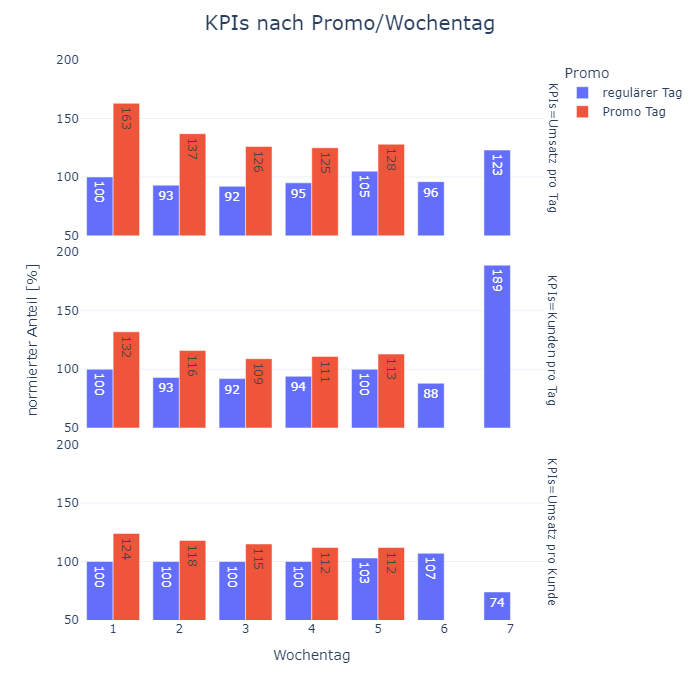

In [81]:
# Nur reguläre Tage 
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.ist_Promo2 == 0)]


df_promo = df_promo.groupby(["Promo", "Wochentag"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["Promo", "Wochentag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.Promo = df_promo_melt.Promo.replace({0: "regulärer Tag", 1: "Promo Tag"})
df_promo_melt.Wochentag = df_promo_melt.Wochentag.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Wochentag", y="Anteil", color="Promo", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Promo/Wochentag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[50, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Innerhalb der Woche ist zu erkennen, dass Promo nur in der Woche läuft und Montags am Besten.  

### 4.3.3. <a id='toc4_3_3_'></a>Irreguläre Tage [&#9650;](#toc0_)

Hier schauen wir uns an wie Promo auf Feiertage und Schulferien auswirkt. Zunächst auf die Feiertage ohne Promo2.

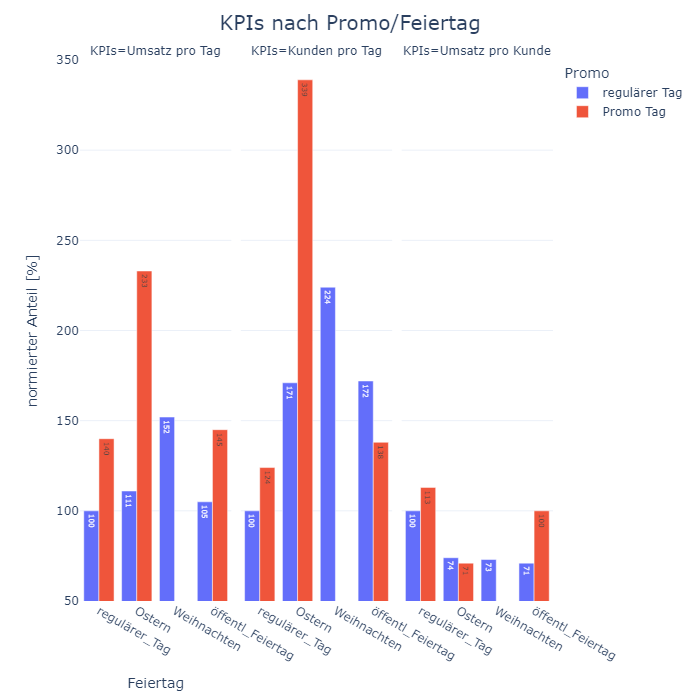

In [82]:

# Nur reguläre Tage und keine Schulferien
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.ist_Promo2 == 0)]

df_promo['Feiertag'] = df_promo[["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]].idxmax(axis=1)
# Kategorien in der gewünschten Reihenfolge definieren
categories = ["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]
df_promo['Feiertag'] = pd.Categorical(df_promo['Feiertag'], categories=categories, ordered=True)

df_promo = df_promo.groupby(["Promo", "Feiertag"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["Promo", "Feiertag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.Promo = df_promo_melt.Promo.replace({0: "regulärer Tag", 1: "Promo Tag"})
df_promo_melt.Feiertag = df_promo_melt.Feiertag.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Feiertag", y="Anteil", color="Promo", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach Promo/Feiertag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[50, 350]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




Promo bewirkt eine Steigerung des Umsatzes von 122 % an Ostern und 40% an Feiertagen. An Weihnachten läuft keine Promo.  
Nun schauen wir uns das gleiche in den Schulferien an.  

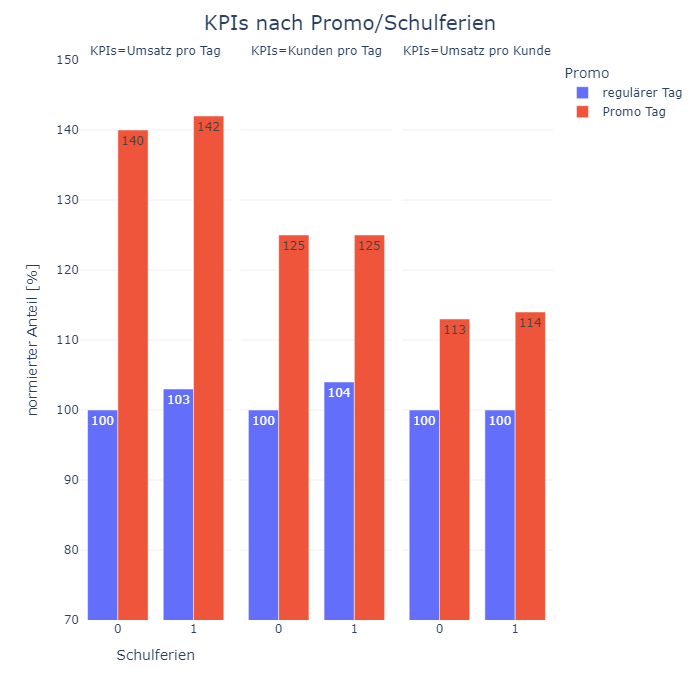

In [83]:

# Nur reguläre Tage und keine Schulferien
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.ist_Promo2 == 0)]

df_promo = df_promo.groupby(["Promo", "Schulferien"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["Promo", "Schulferien"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.Promo = df_promo_melt.Promo.replace({0: "regulärer Tag", 1: "Promo Tag"})
df_promo_melt.Schulferien = df_promo_melt.Schulferien.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Schulferien", y="Anteil", color="Promo", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach Promo/Schulferien", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[70, 150]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




Promo wirkt sich auch auf die Schulferien deutlich aus.  


## 4.4. <a id='toc4_4_'></a>Promo2 [&#9650;](#toc0_)

### 4.4.1. <a id='toc4_4_1_'></a>Korrelationen von Promo2 [&#9650;](#toc0_)

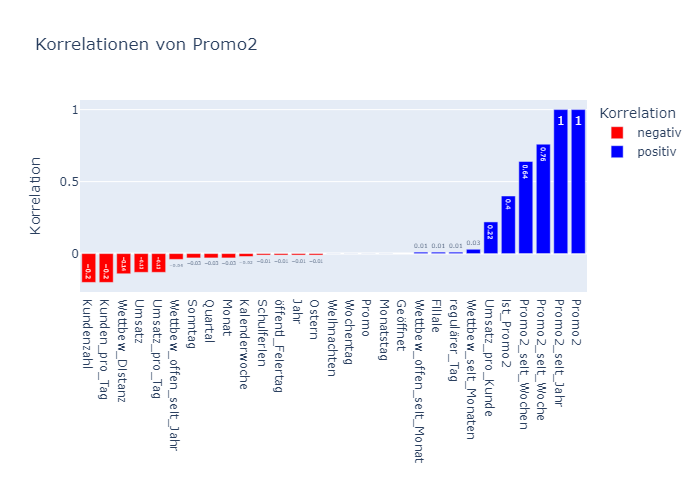

In [84]:
# Korrelation
df_corr=numeric.corr()

# Korrelation berechnen für den Einfluss der Faktoren auf SalesPerDay
df_corr = round(df_corr["Promo2"].sort_values().reset_index(), 2)

# Farben basierend auf den Werten zuweisen
df_corr['Korrelation'] = df_corr['Promo2'].apply(lambda x: 'positiv' if x > 0 else 'negativ')

# Balkendiagramm erstellen
fig = px.bar(df_corr, x='index', y='Promo2', color='Korrelation', text_auto=True,
             title='Korrelationen von Promo2', 
             color_discrete_map={'positiv': 'blue', 'negativ': 'red'})
fig.update_layout(xaxis_title='', yaxis_title="Korrelation")

# Diagramm anzeigen
fig.show()


Promo 2 koreliert stark mit Promo2_seit_Jahr, _seit_Woche und _seit_Wochen. Mittlere Korrelation zeigt ist_Promo2 und niedrige Korerlation mit Umsatz_pro-Kunde. Promo2 korreliert wenig negativ mit Umsatz, Wettbew_Distanz und Kundenzahl.  

### 4.4.2. <a id='toc4_4_2_'></a>Jahresverlauf [&#9650;](#toc0_)

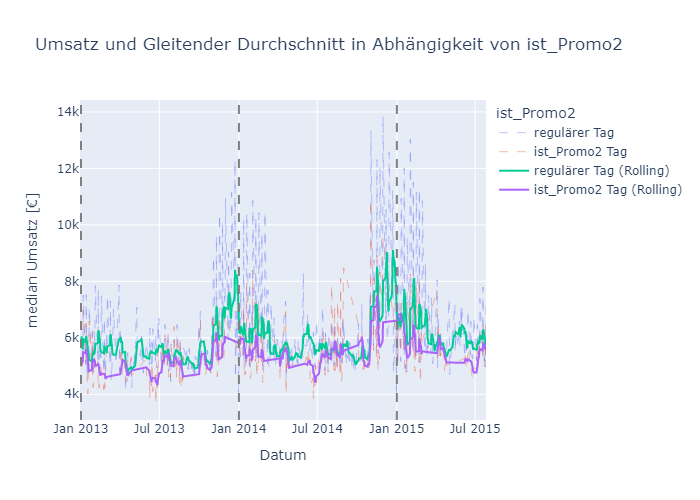

In [85]:
df_promo = df_daily.copy()
df_promo.set_index("Datum", inplace=True)
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.Promo == 0)]
df_promo = df_promo.groupby(["Datum", "ist_Promo2"])["Umsatz"].median().reset_index()

# Gleitenden Durchschnitt berechnen
df_promo['Umsatz_rolling'] = df_promo.groupby('ist_Promo2')['Umsatz'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())
df_promo.ist_Promo2 = df_promo.ist_Promo2.replace({0: "regulärer Tag", 1: "ist_Promo2 Tag"})

# Liniendiagramm für Umsatz erstellen
fig = px.line(df_promo, x="Datum", y="Umsatz", color="ist_Promo2",
              title="Umsatz und Gleitender Durchschnitt in Abhängigkeit von ist_Promo2", labels={"Umsatz": "median Umsatz [€]"})

# Linien von px.line gestrichelt machen
for trace in fig.data:
    trace.update(line=dict(dash='dash', width=1), opacity=0.4)

# Gleitenden Durchschnitt als durchgängige Linie hinzufügen
for ist_Promo2 in df_promo['ist_Promo2'].unique():
    df_promo_ist_Promo2 = df_promo[df_promo['ist_Promo2'] == ist_Promo2]
    fig.add_trace(go.Scatter(x=df_promo_ist_Promo2['Datum'], y=df_promo_ist_Promo2['Umsatz_rolling'], mode='lines', name=f'{ist_Promo2} (Rolling)', line=dict(dash='solid')))

# Vertikale gestrichelte Linien zu Beginn jedes Jahres hinzufügen
years = pd.to_datetime(df_promo['Datum']).dt.year.unique()
for year in years:
    fig.add_vline(x=pd.Timestamp(f'{year}-01-01'), line=dict(dash='dash', color='gray'))

# Diagramm anzeigen
fig.show()

Während Promo2 läuft ist der Umsatz konsequent niedriger. Promo2 weist nur leichte saisonale Trends auf, besonders zur Weihanchtszeit. Dies wird auf wöchentlicher sicht nochmal deutlicher. Die Korrelation zeigt aber, dass Umsatz_pro_Kunde für Promo2 wichtiger ist. Daher hier dieser Verlauf.  

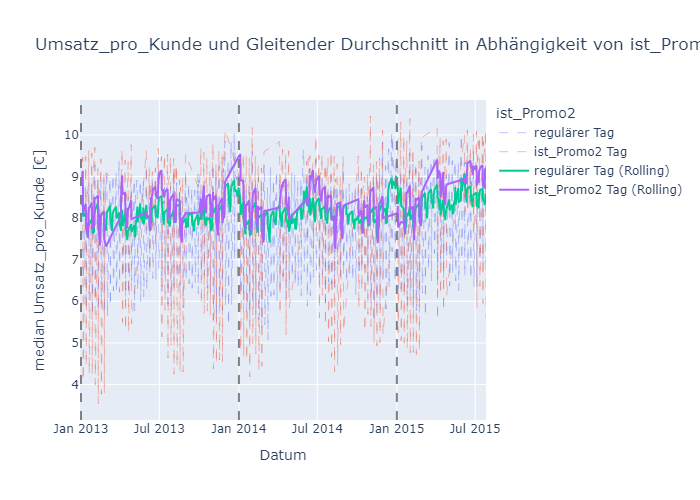

In [86]:
df_promo = df_daily.copy()
df_promo.set_index("Datum", inplace=True)
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.Promo == 0)]
df_promo = df_promo.groupby(["Datum", "ist_Promo2"])["Umsatz_pro_Kunde"].median().reset_index()

# Gleitenden Durchschnitt berechnen
df_promo['Umsatz_pro_Kunde_rolling'] = df_promo.groupby('ist_Promo2')['Umsatz_pro_Kunde'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())
df_promo.ist_Promo2 = df_promo.ist_Promo2.replace({0: "regulärer Tag", 1: "ist_Promo2 Tag"})

# Liniendiagramm für Umsatz_pro_Kunde erstellen
fig = px.line(df_promo, x="Datum", y="Umsatz_pro_Kunde", color="ist_Promo2",
              title="Umsatz_pro_Kunde und Gleitender Durchschnitt in Abhängigkeit von ist_Promo2", labels={"Umsatz_pro_Kunde": "median Umsatz_pro_Kunde [€]"})

# Linien von px.line gestrichelt machen
for trace in fig.data:
    trace.update(line=dict(dash='dash', width=1), opacity=0.4)

# Gleitenden Durchschnitt als durchgängige Linie hinzufügen
for ist_Promo2 in df_promo['ist_Promo2'].unique():
    df_promo_ist_Promo2 = df_promo[df_promo['ist_Promo2'] == ist_Promo2]
    fig.add_trace(go.Scatter(x=df_promo_ist_Promo2['Datum'], y=df_promo_ist_Promo2['Umsatz_pro_Kunde_rolling'], mode='lines', name=f'{ist_Promo2} (Rolling)', line=dict(dash='solid')))

# Vertikale gestrichelte Linien zu Beginn jedes Jahres hinzufügen
years = pd.to_datetime(df_promo['Datum']).dt.year.unique()
for year in years:
    fig.add_vline(x=pd.Timestamp(f'{year}-01-01'), line=dict(dash='dash', color='gray'))

# Diagramm anzeigen
fig.show()

Wie erwartet zeigt Promo2 einen Anstieg am Umsatz pro Kunden.  
Als nächstes kommt die Monatsübersicht.  

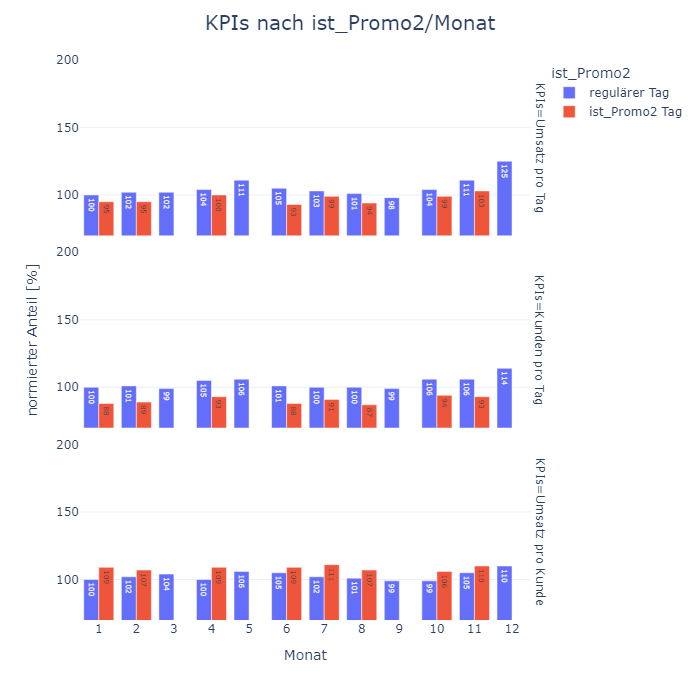

In [87]:
# Nur reguläre Tage und keine Schulferien
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.Promo == 0)]

df_promo = df_promo.groupby(["ist_Promo2", "Monat"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["ist_Promo2", "Monat"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.ist_Promo2 = df_promo_melt.ist_Promo2.replace({0: "regulärer Tag", 1: "ist_Promo2 Tag"})
df_promo_melt.Monat = df_promo_melt.Monat.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Monat", y="Anteil", color="ist_Promo2", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach ist_Promo2/Monat", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[70, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Im März, Mai, September und Dezember läuft keine Promo2. In den Monaten Januar, April, und Juli steigert Promo2 den Umsatz pro Kunden um 9 %.  

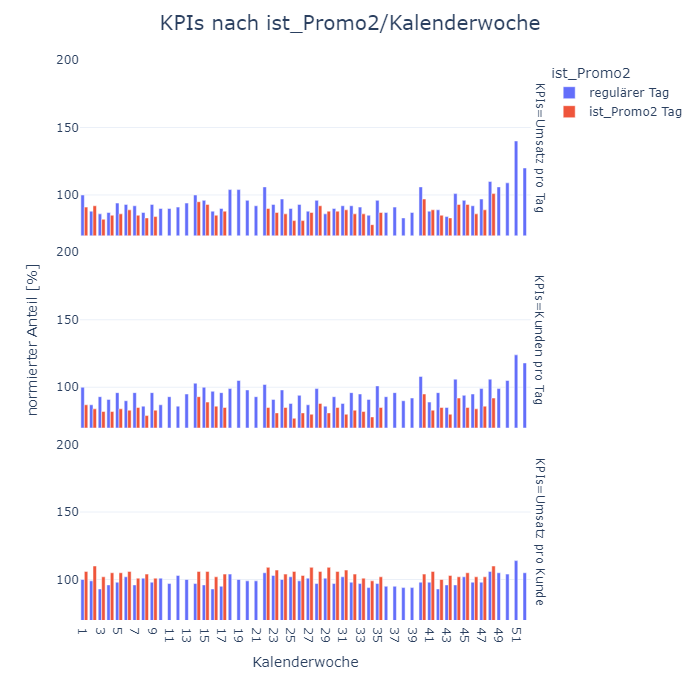

In [88]:
# Nur reguläre Tage und keine Schulferien
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.Promo == 0)]

df_promo = df_promo.groupby(["ist_Promo2", "Kalenderwoche"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["ist_Promo2", "Kalenderwoche"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.ist_Promo2 = df_promo_melt.ist_Promo2.replace({0: "regulärer Tag", 1: "ist_Promo2 Tag"})
df_promo_melt.Kalenderwoche = df_promo_melt.Kalenderwoche.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Kalenderwoche", y="Anteil", color="ist_Promo2", barmode="group", facet_row="KPIs")

fig.update_layout(title_text="KPIs nach ist_Promo2/Kalenderwoche", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[70, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Keine besonderen Trends für Promo2 innerhalb Kalenderwoche. 

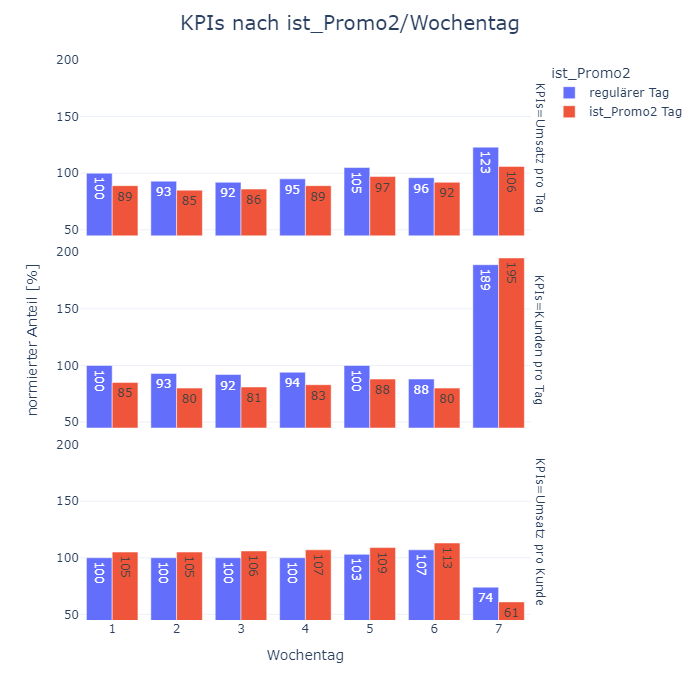

In [89]:
# Nur reguläre Tage und keine Schulferien
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.regulärer_Tag == 1) & (df_promo.Promo == 0)]

df_promo = df_promo.groupby(["ist_Promo2", "Wochentag"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["ist_Promo2", "Wochentag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.ist_Promo2 = df_promo_melt.ist_Promo2.replace({0: "regulärer Tag", 1: "ist_Promo2 Tag"})
df_promo_melt.Wochentag = df_promo_melt.Wochentag.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Wochentag", y="Anteil", color="ist_Promo2", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach ist_Promo2/Wochentag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[45, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Promo2 läuft jeden Tag, und erhöht Umsatz_pro_Kunden ungefähr gleich. Außer am Sonntag.  

### 4.4.3. <a id='toc4_4_3_'></a>Irreguläre Tage [&#9650;](#toc0_)

Hier schauen wir uns an wie Promo2 auf Feiertage und Schulferien auswirkt. Zunächst auf die Feiertage ohne Promo.

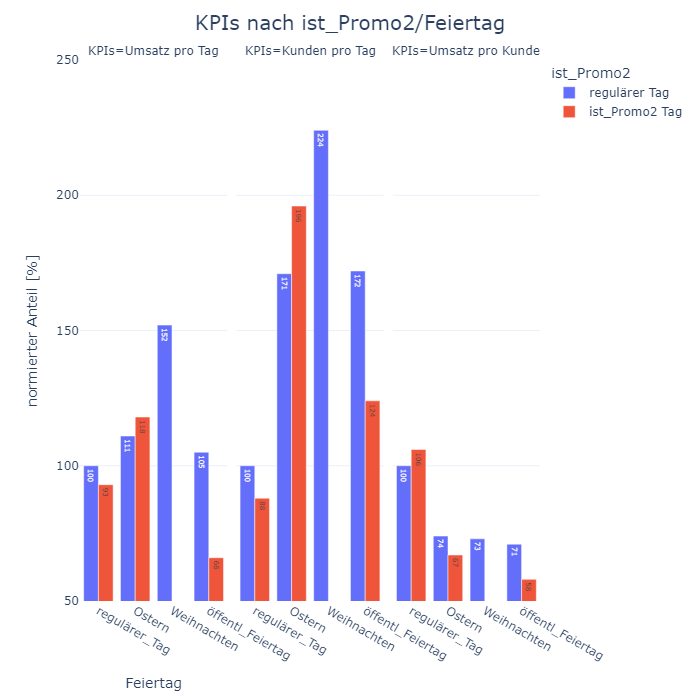

In [90]:


df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.Promo == 0)]

df_promo['Feiertag'] = df_promo[["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]].idxmax(axis=1)
# Kategorien in der gewünschten Reihenfolge definieren
categories = ["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]
df_promo['Feiertag'] = pd.Categorical(df_promo['Feiertag'], categories=categories, ordered=True)

df_promo = df_promo.groupby(["ist_Promo2", "Feiertag"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["ist_Promo2", "Feiertag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.ist_Promo2 = df_promo_melt.ist_Promo2.replace({0: "regulärer Tag", 1: "ist_Promo2 Tag"})
df_promo_melt.Feiertag = df_promo_melt.Feiertag.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Feiertag", y="Anteil", color="ist_Promo2", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach ist_Promo2/Feiertag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[50, 250]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




Promo2 läuft nicht an Weihnachten. An Ostern führt es zu einem Anstieg des Umsatzes. Ansonsten schadet Promo2 an Feiertagen.
Nun schauen wir uns das gleiche in den Schulferien an.  


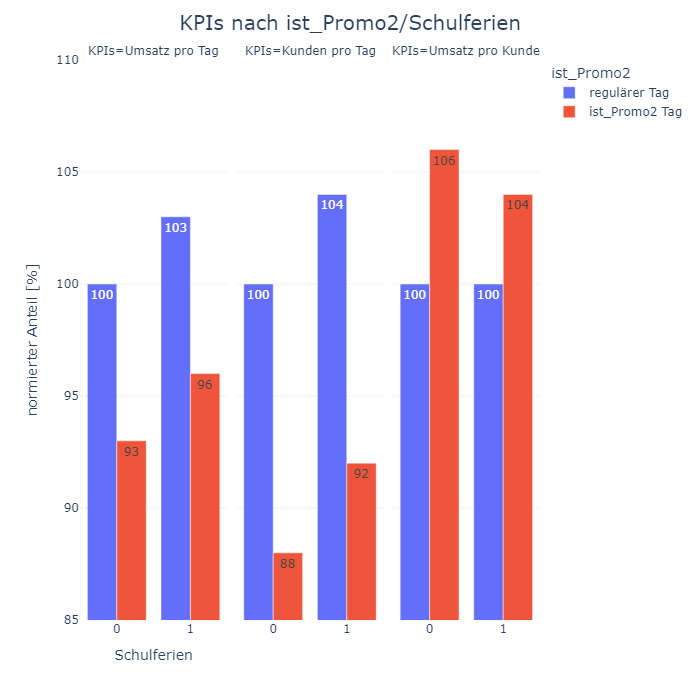

In [91]:

# Nur reguläre Tage und keine Schulferien
df_promo = df_daily.copy()
df_promo = df_promo[(df_promo.Promo == 0)]

df_promo = df_promo.groupby(["ist_Promo2", "Schulferien"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df neu auslegen
df_promo_melt = pd.melt(df_promo, id_vars=["ist_Promo2", "Schulferien"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_promo_melt.ist_Promo2 = df_promo_melt.ist_Promo2.replace({0: "regulärer Tag", 1: "ist_Promo2 Tag"})
df_promo_melt.Schulferien = df_promo_melt.Schulferien.astype("str")


#Plotten
fig = px.bar(df_promo_melt, x="Schulferien", y="Anteil", color="ist_Promo2", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach ist_Promo2/Schulferien", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[85, 110]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




Promo2 wirkt sich leicht auf die Schulferien aus. 

### 4.4.4. <a id='toc4_4_4_'></a>Promo2 Intervalle [&#9650;](#toc0_)

Promo2 läuft je nach Filiale in einem anderen Rhytmus.

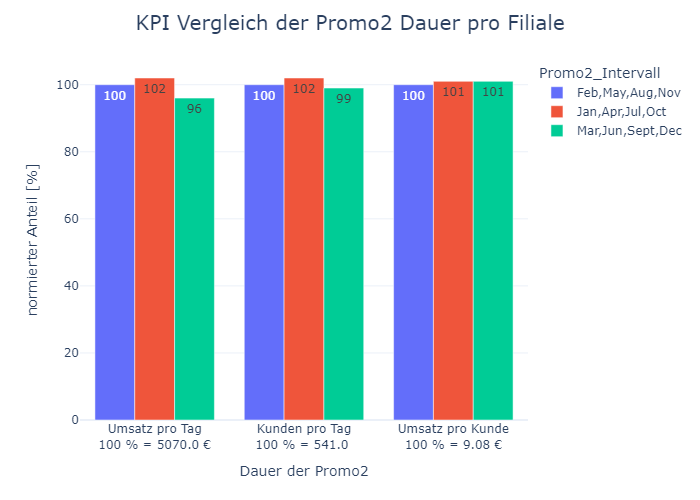

In [92]:
# Nur reguläre Tage ohne Schulferien ohne Promo
df_promo = df_daily[(df_daily.regulärer_Tag == 1) & (df_daily.Promo == 0)].copy()
df_promo = df_promo[df_promo.ist_Promo2 == 1]

df_promo = df_promo.groupby(["Promo2_Intervall"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# weitere spalten täglicher Umsatz, Kunden pro Tag, Umsatz pro Kunde, 
df_promo["Umsatz_pro_Kunde"] = round(df_promo["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo[metriken_normiert] = round(df_promo[metriken].div(df_promo[metriken].iloc[0].values) * 100)

# df_promo neu definieren

df_promo_melt = pd.melt(df_promo, id_vars=["Promo2_Intervall"], value_name="Prozent", value_vars=metriken_normiert, var_name="KPI")

# Plotten
fig = px.bar(df_promo_melt, x="KPI", y="Prozent", color="Promo2_Intervall", barmode="group", text_auto=True)

# Layout anpassen
fig.update_layout(title_text="KPI Vergleich der Promo2 Dauer pro Filiale  ", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis_title="Dauer der Promo2", yaxis_title="normierter Anteil [%]")

fig.update_xaxes(ticktext=[f"Umsatz pro Tag<br>100 % = {df_promo.Umsatz_pro_Tag.iloc[0]} €<br>",
                           f"Kunden pro Tag<br>100 % = {df_promo.Kunden_pro_Tag.iloc[0]} <br>",
                           f"Umsatz pro Kunde<br>100 % = {df_promo.Umsatz_pro_Kunde.iloc[0]} €<br>"],
                 tickvals=["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"])

fig.show()



Jan,Apr,Jul,Oct Intervall ist in allen KPIs am Besten, jedoch nur leicht. 

### 4.4.5. <a id='toc4_4_5_'></a>Dauer Promo2 [&#9650;](#toc0_)

Promo2 läuft seit unterschiedlich vielen Wochen und könnte einen Einfluss auf die KPIs haben.

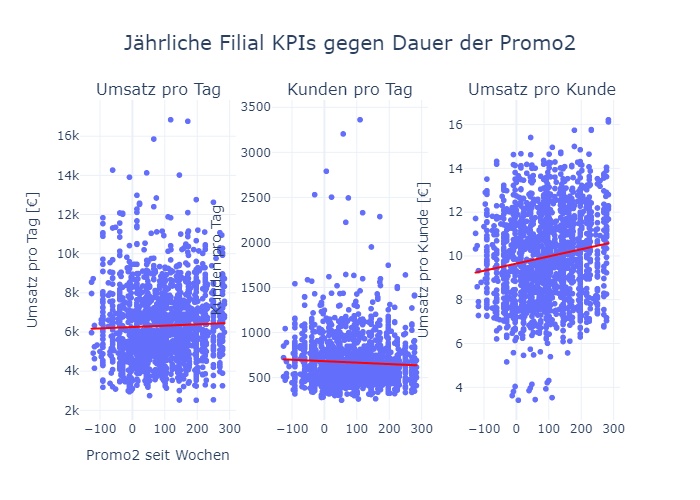

In [93]:
df_promo2 = df_daily.copy()
df_promo2 = df_promo2[df_promo2.Promo2 == 1]

df_promo2 = df_promo2.groupby(["Filiale", "Jahr"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median", "Promo2_seit_Wochen": "last"}).reset_index()

# weitere spalten täglicher Umsatz, Kunden pro Tag, Umsatz pro Kunde, 
df_promo2["Umsatz_pro_Kunde"] = round(df_promo2["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo2[metriken_normiert] = round(df_promo2[metriken].div(df_promo2[metriken].iloc[0].values) * 100)

# Plotten
fig = make_subplots(rows=1, cols=3, subplot_titles=("Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"))

# Umsatz pro Tag
fig1 = px.scatter(df_promo2, x="Promo2_seit_Wochen", y="Umsatz_pro_Tag", trendline="ols")
for trace in fig1["data"]:
    trace["line"]["color"] = "red"
    fig.add_trace(trace, 1, 1)

# Kunden pro Tag
fig2 = px.scatter(df_promo2, x="Promo2_seit_Wochen", y="Kunden_pro_Tag", trendline="ols")
for trace in fig2["data"]:
    trace["line"]["color"] = "red"
    fig.add_trace(trace, 1, 2)

# Umsatz pro Kunde
fig3 = px.scatter(df_promo2, x="Promo2_seit_Wochen", y="Umsatz_pro_Kunde", trendline="ols")
for trace in fig3["data"]:
    trace["line"]["color"] = "red"
    fig.add_trace(trace, 1, 3)

# Layout anpassen
fig.update_layout(title_text="Jährliche Filial KPIs gegen Dauer der Promo2", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis_title="Promo2 seit Wochen", yaxis_title="Umsatz pro Tag [€]", yaxis2_title="Kunden pro Tag", yaxis3_title="Umsatz pro Kunde [€]")

fig.show()



Mit der Dauer der Promo2 steigt Umsatz pro Tag geringfügig und Umsatz pro Kunde moderat.  

### 4.4.6. <a id='toc4_4_6_'></a>Promo2 gegen Promo [&#9650;](#toc0_)

Hier untersuchen wir, wie sich Promo2 auf Promo auswirkt.

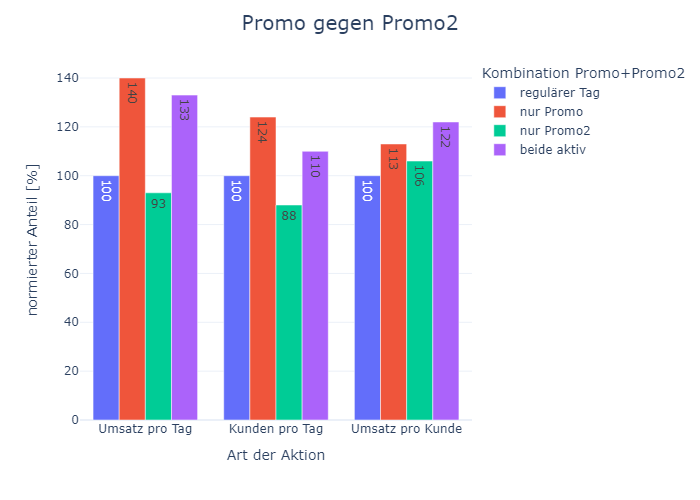

In [94]:
# Nur Umsätze mit Weihnachten
df_promo2 = df_daily.copy()
df_promo2 = df_promo2[(df_promo2.regulärer_Tag == 1)]

df_promo2 = df_promo2.groupby(["ist_Promo2", "Promo"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# weitere spalten täglicher Umsatz, Kunden pro Tag, Umsatz pro Kunde, 
df_promo2["Umsatz_pro_Kunde"] = round(df_promo2["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_promo2[metriken_normiert] = round(df_promo2[metriken].div(df_promo2[metriken].iloc[0].values) * 100)


# Kombination von Promo und Promo2, sowie umbennen
df_promo2.ist_Promo2 = df_promo2.ist_Promo2.astype("str") 
df_promo2.Promo = df_promo2.Promo.astype("str") 
df_promo2["Kombination Promo+Promo2"] = df_promo2.Promo + " " + df_promo2.ist_Promo2
df_promo2["Kombination Promo+Promo2"] = df_promo2["Kombination Promo+Promo2"].replace({"0 0": "regulärer Tag", "1 0": "nur Promo", "0 1": "nur Promo2", "1 1": "beide aktiv"})

df_promo2_melt = pd.melt(df_promo2, id_vars=["Kombination Promo+Promo2"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.bar(df_promo2_melt, color="Kombination Promo+Promo2", y="normierter Anteil [%]", barmode="group", text_auto=True, x="KPI")

fig.update_layout(title_text="Promo gegen Promo2", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis_title="Art der Aktion",
                  showlegend=True)


Promo2 und Promo beeinflussen sich gegenseitig. Zusammen reduzieren sie die KPIs im Vergleich zu Promo, außer Umsatz pro Kunde.

## 4.5. <a id='toc4_5_'></a>Wettbewerber [&#9650;](#toc0_)

### 4.5.1. <a id='toc4_5_1_'></a>Korrelationen von Wettbewerber Distanz [&#9650;](#toc0_)

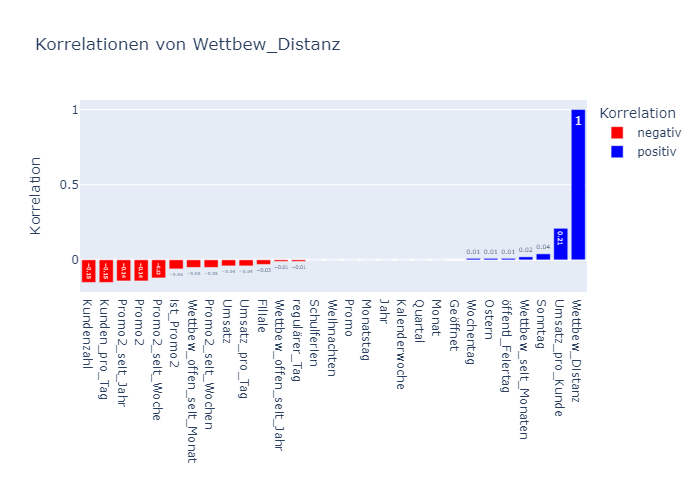

In [95]:
# Korrelation
df_corr=numeric.corr()

# Korrelation berechnen für den Einfluss der Faktoren auf SalesPerDay
df_corr = round(df_corr["Wettbew_Distanz"].sort_values().reset_index(), 2)

# Farben basierend auf den Werten zuweisen
df_corr['Korrelation'] = df_corr['Wettbew_Distanz'].apply(lambda x: 'positiv' if x > 0 else 'negativ')

# Balkendiagramm erstellen
fig = px.bar(df_corr, 
             x='index', 
             y='Wettbew_Distanz', 
             title='Korrelationen von Wettbew_Distanz',
             color='Korrelation',
             color_discrete_map={'positiv': 'blue', 'negativ': 'red'},
             text_auto=True)
fig.update_layout(xaxis_title='', yaxis_title="Korrelation")

# Diagramm anzeigen
fig.show()


Wettbewerber korrelirt leicht mit Umsatz pro Kunde. Auf der negativen Seite korreliert es leicht mit Promo2 und Kundenzahl, sprich wenn die Wettbewerber Distanz hoch ist, gibt es weniger Promo2.  

### 4.5.2. <a id='toc4_5_2_'></a>Einfluss auf KPIs [&#9650;](#toc0_)

In [96]:
df_agg.columns

Index(['Filiale', 'Umsatz', 'Kundenzahl', 'Umsatz_pro_Tag', 'Umsatz_pro_Kunde',
       'Kunden_pro_Tag', 'Geöffnet', 'Promo', 'ist_Promo2', 'Schulferien',
       'Ostern', 'Weihnachten', 'öffentl_Feiertag', 'regulärer_Tag', 'Sonntag',
       'Geschäftstyp', 'Sortiment', 'Bundesland', 'Wettbew_Distanz',
       'Wettbew_seit_Monaten', 'Wettbew_offen_seit_Monat',
       'Wettbew_offen_seit_Jahr', 'Promo2', 'Promo2_Intervall',
       'Promo2_seit_Wochen', 'Promo2_seit_Woche', 'Promo2_seit_Jahr',
       'Gruppe'],
      dtype='object')

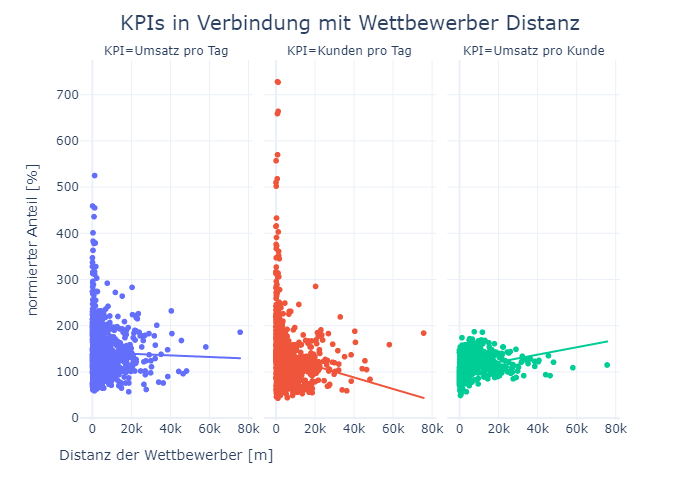

In [97]:
df_distanz = df_agg.copy()

# normieren auf ersten wert
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_distanz[metriken_normiert] = round(df_distanz[metriken].div(df_distanz[metriken].iloc[0].values) * 100)

df_distanz_melt = pd.melt(df_distanz, id_vars=["Wettbew_Distanz"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.scatter(df_distanz_melt, x="Wettbew_Distanz", y="normierter Anteil [%]", facet_col="KPI", trendline="ols", color="KPI")
fig.update_layout(title_text="KPIs in Verbindung mit Wettbewerber Distanz ", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis1_title="Distanz der Wettbewerber [m]",xaxis2_title="", xaxis3_title="",
                  showlegend=False)
fig.show()
fig.write_image("..\\Ausgewählte_Plots\\Einfluss_der_Wettbewerber_Distanz_auf_KPIs.png")

Je weiter Wettbewerber entfernt sind, umso niedriger fällt Umsatz pro Tag und Kunden pro Tag aus, wobei Umsatz pro Kunde steigt  

### 4.5.3. <a id='toc4_5_3_'></a>Umsatz in Abhängigkeit seit der Öffnung von Wettbwerbern [&#9650;](#toc0_)

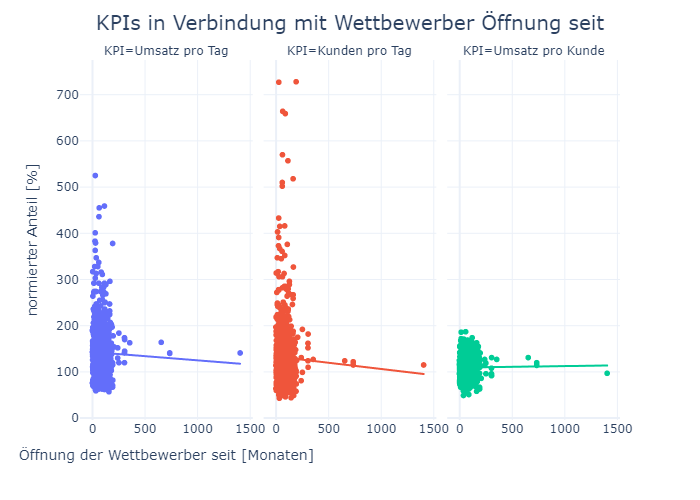

In [98]:
df_distanz = df_agg.copy()

# normieren auf ersten wert
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_distanz[metriken_normiert] = round(df_distanz[metriken].div(df_distanz[metriken].iloc[0].values) * 100)

df_distanz_melt = pd.melt(df_distanz, id_vars=["Wettbew_seit_Monaten"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.scatter(df_distanz_melt, x="Wettbew_seit_Monaten", y="normierter Anteil [%]", facet_col="KPI", trendline="ols", color="KPI")
fig.update_layout(title_text="KPIs in Verbindung mit Wettbewerber Öffnung seit ", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis1_title="Öffnung der Wettbewerber seit [Monaten]",xaxis2_title="", xaxis3_title="",
                  showlegend=False)
fig.show()

Je länger Wettbewerber geöffnet haben, umso höher ist der Umsatz pro Kunde aber umso niedriger der Umsatz pro Tag. Ähnlich zu Wettbewerber Distanz aber milder  

### 4.5.4. <a id='toc4_5_4_'></a>Wettbew Distanz und Promo [&#9650;](#toc0_)

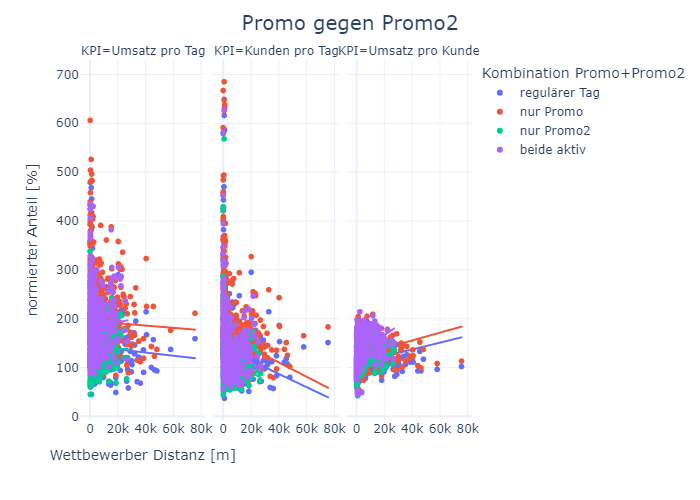

In [99]:

df_distanz = df_daily.copy()
df_distanz = df_distanz[(df_distanz.regulärer_Tag == 1)]

df_distanz = df_distanz.groupby(["Filiale", "ist_Promo2", "Promo"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median", "Wettbew_Distanz": "last"}).reset_index().sort_index()

# normieren 
df_distanz["Umsatz_pro_Kunde"] = round(df_distanz["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_distanz[metriken_normiert] = round(df_distanz[metriken].div(df_distanz[metriken].iloc[0].values) * 100)

# Kombination von Promo und Promo2, sowie umbennen
df_distanz.ist_Promo2 = df_distanz.ist_Promo2.astype("str") 
df_distanz.Promo = df_distanz.Promo.astype("str") 
df_distanz["Kombination Promo+Promo2"] = df_distanz.Promo + " " + df_distanz.ist_Promo2
df_distanz["Kombination Promo+Promo2"] = df_distanz["Kombination Promo+Promo2"].replace({"0 0": "regulärer Tag", "1 0": "nur Promo", "0 1": "nur Promo2", "1 1": "beide aktiv"})

df_distanz_melt = pd.melt(df_distanz, id_vars=["Kombination Promo+Promo2", "Wettbew_Distanz"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.scatter(df_distanz_melt, x="Wettbew_Distanz", color="Kombination Promo+Promo2", y="normierter Anteil [%]", facet_col="KPI", trendline="ols")

fig.update_layout(title_text="Promo gegen Promo2", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis1_title="Wettbewerber Distanz [m]",xaxis2_title="", xaxis3_title="",
                  showlegend=True)
fig.show()

Umsatz und Kunden pro Tag fällt mit der Distanz von Wettbwerbern in Promos. Nur Promo2 führt mit höhere Distanz zu einem höheren Umsatz pro Tag, und überholt einen regulären Tag mit höherer Distanz. Promo2 gibt es nicht in Filialen die ca. 25000 m entfernt liegen.  

## 4.6. <a id='toc4_6_'></a>Sortiment [&#9650;](#toc0_)

### 4.6.1. <a id='toc4_6_1_'></a>Jahresverlauf [&#9650;](#toc0_)

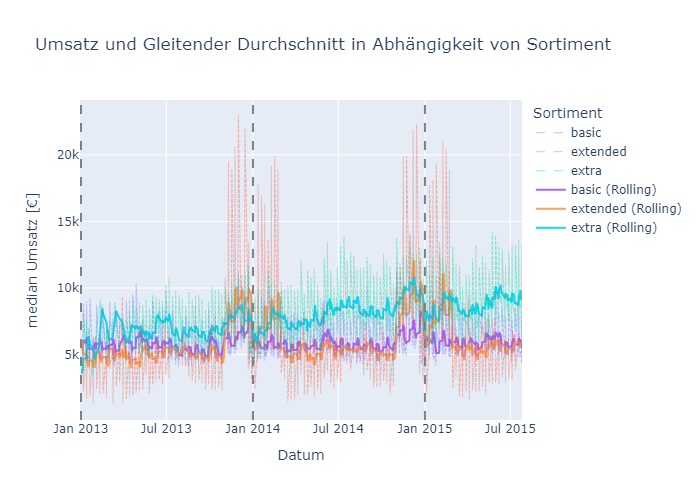

In [100]:
df_assort = df_daily.copy()
df_assort.set_index("Datum", inplace=True)
df_assort = df_assort[(df_assort.regulärer_Tag == 1) & (df_assort.ist_Promo2 == 0) & (df_assort.Promo == 0)]
df_assort = df_assort.groupby(["Datum", "Sortiment"])["Umsatz"].median().reset_index()

# Gleitenden Durchschnitt berechnen
df_assort['Umsatz_rolling'] = df_assort.groupby('Sortiment')['Umsatz'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())

# Liniendiagramm für Umsatz erstellen
fig = px.line(df_assort, x="Datum", y="Umsatz", color="Sortiment",
              title="Umsatz und Gleitender Durchschnitt in Abhängigkeit von Sortiment", labels={"Umsatz": "median Umsatz [€]"})

# Linien von px.line gestrichelt machen
for trace in fig.data:
    trace.update(line=dict(dash='dash', width=1), opacity=0.4)

# Gleitenden Durchschnitt als durchgängige Linie hinzufügen
for Sortiment in df_assort['Sortiment'].unique():
    df_assort_Sortiment = df_assort[df_assort['Sortiment'] == Sortiment]
    fig.add_trace(go.Scatter(x=df_assort_Sortiment['Datum'], y=df_assort_Sortiment['Umsatz_rolling'], mode='lines', name=f'{Sortiment} (Rolling)', line=dict(dash='solid')))

# Vertikale gestrichelte Linien zu Beginn jedes Jahres hinzufügen
years = pd.to_datetime(df_assort['Datum']).dt.year.unique()
for year in years:
    fig.add_vline(x=pd.Timestamp(f'{year}-01-01'), line=dict(dash='dash', color='gray'))

# Diagramm anzeigen
fig.show()

Das Sortiment extra weist den höchsten median Umsatz auf und zeigt den Stärksten Trend.  

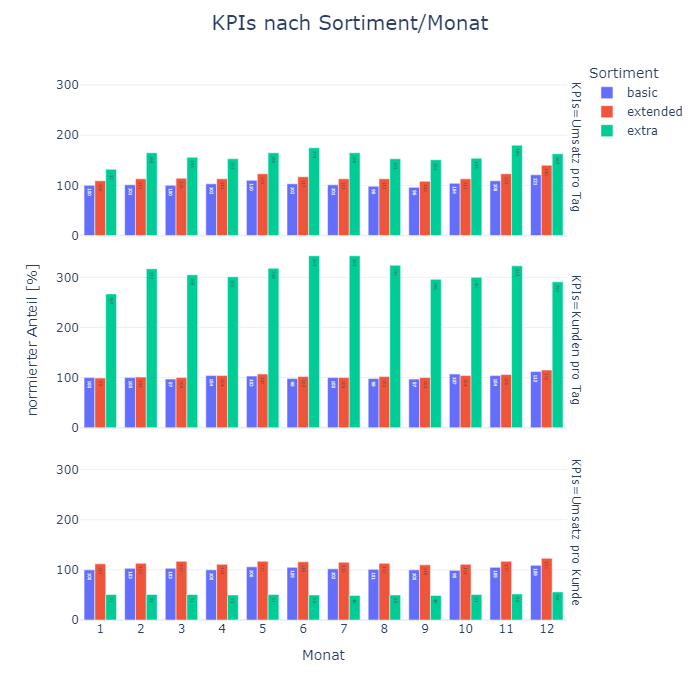

In [101]:
# Nur reguläre Tage
df_assort = df_daily.copy()
df_assort = df_assort[(df_assort.regulärer_Tag == 1) & (df_assort.ist_Promo2 == 0) & (df_assort.Promo == 0)]

df_assort = df_assort.groupby(["Sortiment", "Monat"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_assort["Umsatz_pro_Kunde"] = round(df_assort["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_assort[metriken_normiert] = round(df_assort[metriken].div(df_assort[metriken].iloc[0].values) * 100)

# df neu auslegen
df_assort_melt = pd.melt(df_assort, id_vars=["Sortiment", "Monat"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_assort_melt.Sortiment = df_assort_melt.Sortiment.replace({0: "regulärer Tag", 1: "Sortiment Tag"})
df_assort_melt.Monat = df_assort_melt.Monat.astype("str")


#Plotten
fig = px.bar(df_assort_melt, x="Monat", y="Anteil", color="Sortiment", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Sortiment/Monat", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[0, 350]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Sortiment hat den größten Umsatz pro Tag in Juni und November und ca. 3mal soviele Kunden wie die anderen Sortiment Typen. Sortiment extended schneidet besser ab als basic.  

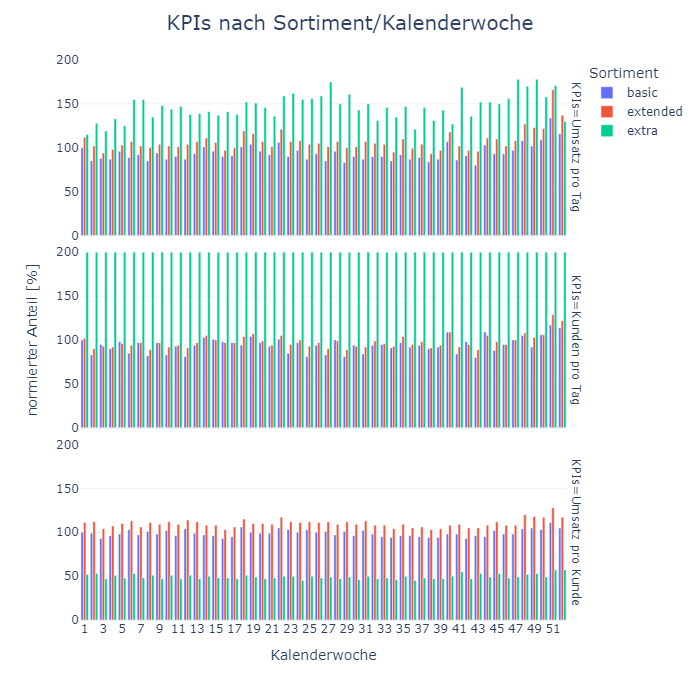

In [102]:
# Nur reguläre Tage und keine Schulferien
df_assort = df_daily.copy()
df_assort = df_assort[(df_assort.regulärer_Tag == 1) & (df_assort.ist_Promo2 == 0) & (df_assort.Promo == 0)]

df_assort = df_assort.groupby(["Sortiment", "Kalenderwoche"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_assort["Umsatz_pro_Kunde"] = round(df_assort["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_assort[metriken_normiert] = round(df_assort[metriken].div(df_assort[metriken].iloc[0].values) * 100)

# df neu auslegen
df_assort_melt = pd.melt(df_assort, id_vars=["Sortiment", "Kalenderwoche"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_assort_melt.Sortiment = df_assort_melt.Sortiment.replace({0: "regulärer Tag", 1: "Sortiment Tag"})
df_assort_melt.Kalenderwoche = df_assort_melt.Kalenderwoche.astype("str")


#Plotten
fig = px.bar(df_assort_melt, x="Kalenderwoche", y="Anteil", color="Sortiment", barmode="group", facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Sortiment/Kalenderwoche", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[0, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Wochen 49 und 47 bringen den meisten Umsatz für Sortiment extra. In Woche 51 erreicht extended fast den Umsatz von extra.  

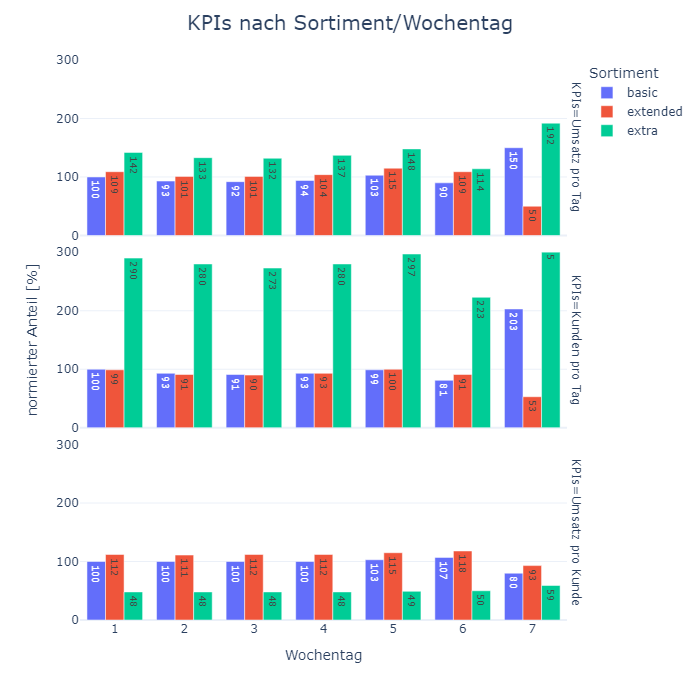

In [103]:
# Nur reguläre Tage 
df_assort = df_daily.copy()
df_assort = df_assort[(df_assort.regulärer_Tag == 1) & (df_assort.ist_Promo2 == 0) & (df_assort.Promo == 0)]


df_assort = df_assort.groupby(["Sortiment", "Wochentag"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_assort["Umsatz_pro_Kunde"] = round(df_assort["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_assort[metriken_normiert] = round(df_assort[metriken].div(df_assort[metriken].iloc[0].values) * 100)

# df neu auslegen
df_assort_melt = pd.melt(df_assort, id_vars=["Sortiment", "Wochentag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_assort_melt.Sortiment = df_assort_melt.Sortiment.replace({0: "regulärer Tag", 1: "Sortiment Tag"})
df_assort_melt.Wochentag = df_assort_melt.Wochentag.astype("str")


#Plotten
fig = px.bar(df_assort_melt, x="Wochentag", y="Anteil", color="Sortiment", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Sortiment/Wochentag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[0, 300]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Sonntags läuft basic und extra am Besten. Sonst ist Freitag der beste Tag für alle Sortimente. Extended erzielt nur niedrige Einnahmen am Sonntag.  

### 4.6.2. <a id='toc4_6_2_'></a>Irreguläre Tage [&#9650;](#toc0_)

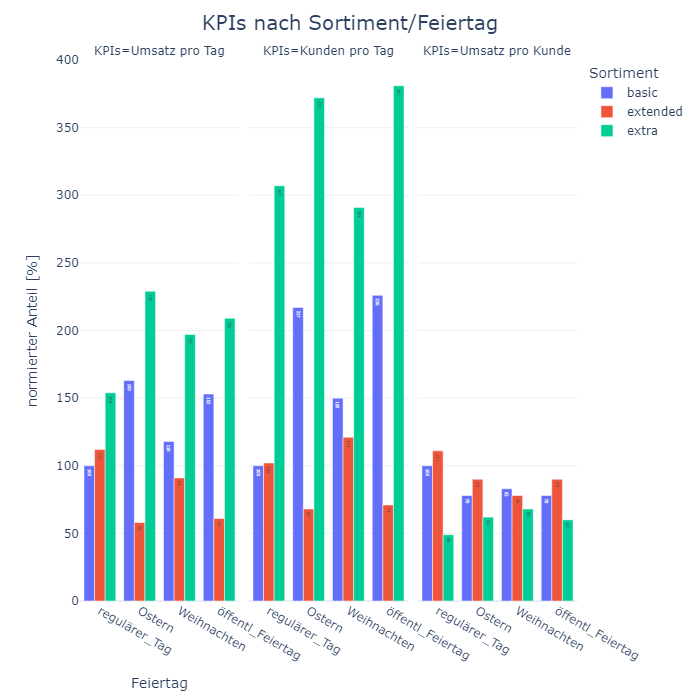

In [104]:

# Nur reguläre Tage und keine Schulferien
df_assort = df_daily.copy()
df_assort = df_assort[(df_assort.ist_Promo2 == 0) & (df_assort.Promo == 0)]

df_assort['Feiertag'] = df_assort[["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]].idxmax(axis=1)
# Kategorien in der gewünschten Reihenfolge definieren
categories = ["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]
df_assort['Feiertag'] = pd.Categorical(df_assort['Feiertag'], categories=categories, ordered=True)

df_assort = df_assort.groupby(["Sortiment", "Feiertag"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_assort["Umsatz_pro_Kunde"] = round(df_assort["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_assort[metriken_normiert] = round(df_assort[metriken].div(df_assort[metriken].iloc[0].values) * 100)

# df neu auslegen
df_assort_melt = pd.melt(df_assort, id_vars=["Sortiment", "Feiertag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_assort_melt.Sortiment = df_assort_melt.Sortiment.replace({0: "regulärer Tag", 1: "Sortiment Tag"})
df_assort_melt.Feiertag = df_assort_melt.Feiertag.astype("str")


#Plotten
fig = px.bar(df_assort_melt, x="Feiertag", y="Anteil", color="Sortiment", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach Sortiment/Feiertag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[0, 400]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




basic schneidet an Feiertagen besser ab als extended, während extra sehr stark von den Feiertagen profitiert.  

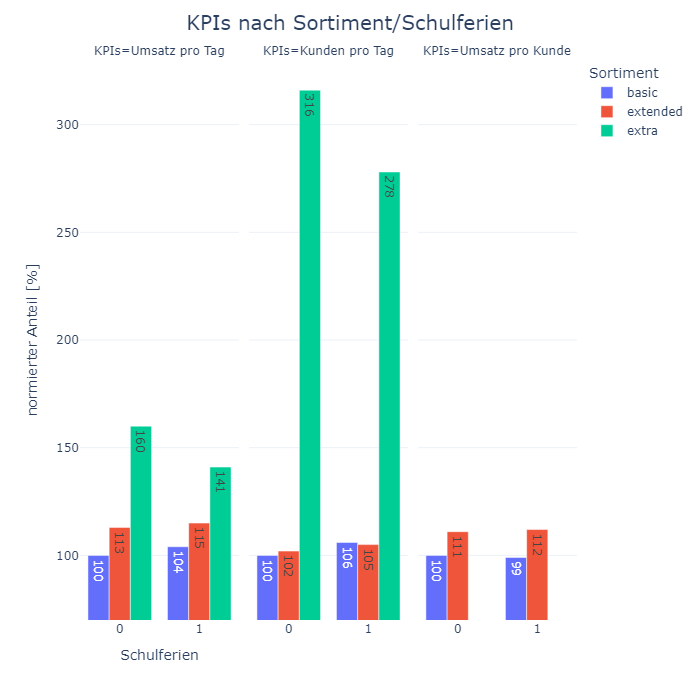

In [105]:

# Nur reguläre Tage und keine Schulferien
df_assort = df_daily.copy()
df_assort = df_assort[(df_assort.ist_Promo2 == 0) & (df_assort.Promo == 0)]

df_assort = df_assort.groupby(["Sortiment", "Schulferien"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_assort["Umsatz_pro_Kunde"] = round(df_assort["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_assort[metriken_normiert] = round(df_assort[metriken].div(df_assort[metriken].iloc[0].values) * 100)

# df neu auslegen
df_assort_melt = pd.melt(df_assort, id_vars=["Sortiment", "Schulferien"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_assort_melt.Sortiment = df_assort_melt.Sortiment.replace({0: "regulärer Tag", 1: "Sortiment Tag"})
df_assort_melt.Schulferien = df_assort_melt.Schulferien.astype("str")


#Plotten
fig = px.bar(df_assort_melt, x="Schulferien", y="Anteil", color="Sortiment", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach Sortiment/Schulferien", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[70, 330]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




extra läuft in Schulferien schlechter, während die anderen beiden eine leichte Verbesserung sehen.  

### 4.6.3. <a id='toc4_6_3_'></a>Promo [&#9650;](#toc0_)

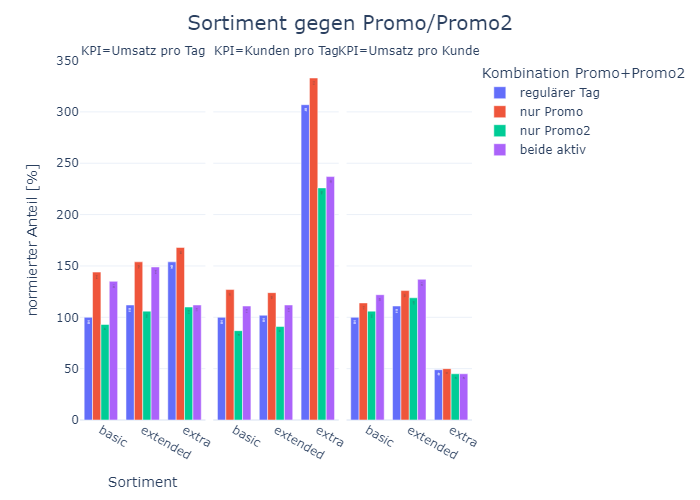

In [106]:

df_assort = df_daily.copy()
df_assort = df_assort[(df_assort.regulärer_Tag == 1)]

df_assort = df_assort.groupby(["Sortiment", "ist_Promo2", "Promo"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index().sort_index()

# normieren 
df_assort["Umsatz_pro_Kunde"] = round(df_assort["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_assort[metriken_normiert] = round(df_assort[metriken].div(df_assort[metriken].iloc[0].values) * 100)

# Kombination von Promo und Promo2, sowie umbennen
df_assort.ist_Promo2 = df_assort.ist_Promo2.astype("str") 
df_assort.Promo = df_assort.Promo.astype("str") 
df_assort["Kombination Promo+Promo2"] = df_assort.Promo + " " + df_assort.ist_Promo2
df_assort["Kombination Promo+Promo2"] = df_assort["Kombination Promo+Promo2"].replace({"0 0": "regulärer Tag", "1 0": "nur Promo", "0 1": "nur Promo2", "1 1": "beide aktiv"})


df_assort_melt = pd.melt(df_assort, id_vars=["Kombination Promo+Promo2", "Sortiment"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.bar(df_assort_melt, x="Sortiment", y="normierter Anteil [%]", color="Kombination Promo+Promo2", barmode="group", text_auto=True, facet_col="KPI")


fig.update_layout(title_text="Sortiment gegen Promo/Promo2", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis1_title="Sortiment",xaxis2_title="", xaxis3_title="",
                  showlegend=True)


Basic und extended profitieren am meisten von den promotions. Während Promo extra verbessert, aber in Kombination mit Promo2 stark versagt.  

## 4.7. <a id='toc4_7_'></a>Geschäftstyp [&#9650;](#toc0_)

### 4.7.1. <a id='toc4_7_1_'></a>Jahresverlauf [&#9650;](#toc0_)

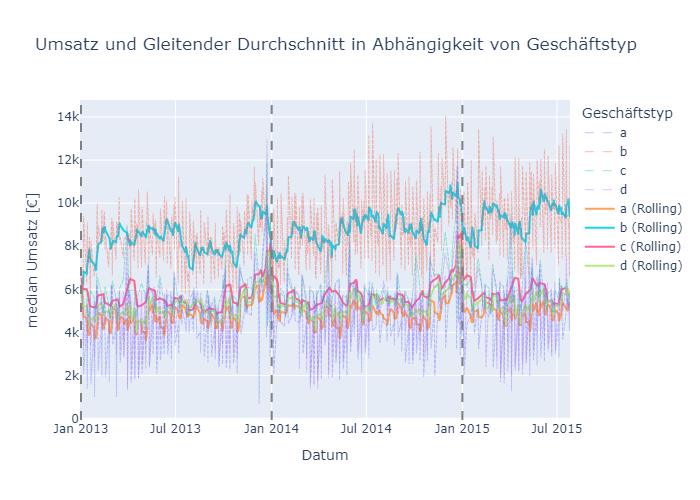

In [107]:
df_type = df_daily.copy()
df_type.set_index("Datum", inplace=True)
df_type = df_type[(df_type.regulärer_Tag == 1) & (df_type.ist_Promo2 == 0) & (df_type.Promo == 0)]
df_type = df_type.groupby(["Datum", "Geschäftstyp"])["Umsatz"].median().reset_index()

# Gleitenden Durchschnitt berechnen
df_type['Umsatz_rolling'] = df_type.groupby('Geschäftstyp')['Umsatz'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())

# Liniendiagramm für Umsatz erstellen
fig = px.line(df_type, x="Datum", y="Umsatz", color="Geschäftstyp",
              title="Umsatz und Gleitender Durchschnitt in Abhängigkeit von Geschäftstyp", labels={"Umsatz": "median Umsatz [€]"})

# Linien von px.line gestrichelt machen
for trace in fig.data:
    trace.update(line=dict(dash='dash', width=1), opacity=0.4)

# Gleitenden Durchschnitt als durchgängige Linie hinzufügen
for Geschäftstyp in df_type['Geschäftstyp'].unique():
    df_type_Geschäftstyp = df_type[df_type['Geschäftstyp'] == Geschäftstyp]
    fig.add_trace(go.Scatter(x=df_type_Geschäftstyp['Datum'], y=df_type_Geschäftstyp['Umsatz_rolling'], mode='lines', name=f'{Geschäftstyp} (Rolling)', line=dict(dash='solid')))

# Vertikale gestrichelte Linien zu Beginn jedes Jahres hinzufügen
years = pd.to_datetime(df_type['Datum']).dt.year.unique()
for year in years:
    fig.add_vline(x=pd.Timestamp(f'{year}-01-01'), line=dict(dash='dash', color='gray'))

# Diagramm anzeigen
fig.show()

Typ b läuft meisten gegenteilig zu den anderen Filialen, also invertierte Maxima und Minima. Typ b hat außerdem den höchsten median Umsatz. 

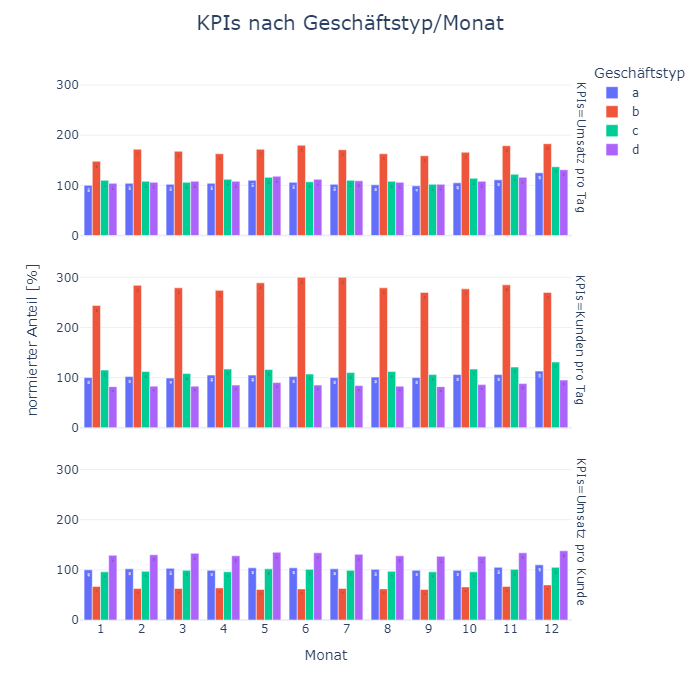

In [108]:
# Nur reguläre Tage
df_type = df_daily.copy()
df_type = df_type[(df_type.regulärer_Tag == 1) & (df_type.ist_Promo2 == 0) & (df_type.Promo == 0)]

df_type = df_type.groupby(["Geschäftstyp", "Monat"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# df neu auslegen
df_type_melt = pd.melt(df_type, id_vars=["Geschäftstyp", "Monat"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_type_melt.Geschäftstyp = df_type_melt.Geschäftstyp.replace({0: "regulärer Tag", 1: "Geschäftstyp Tag"})
df_type_melt.Monat = df_type_melt.Monat.astype("str")


#Plotten
fig = px.bar(df_type_melt, x="Monat", y="Anteil", color="Geschäftstyp", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Geschäftstyp/Monat", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[0, 350]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Während Typ b den höchsten Umsatz und Kunden pro Tag hat, hat Typ d den höchsten Umsatz pro Kunden.  

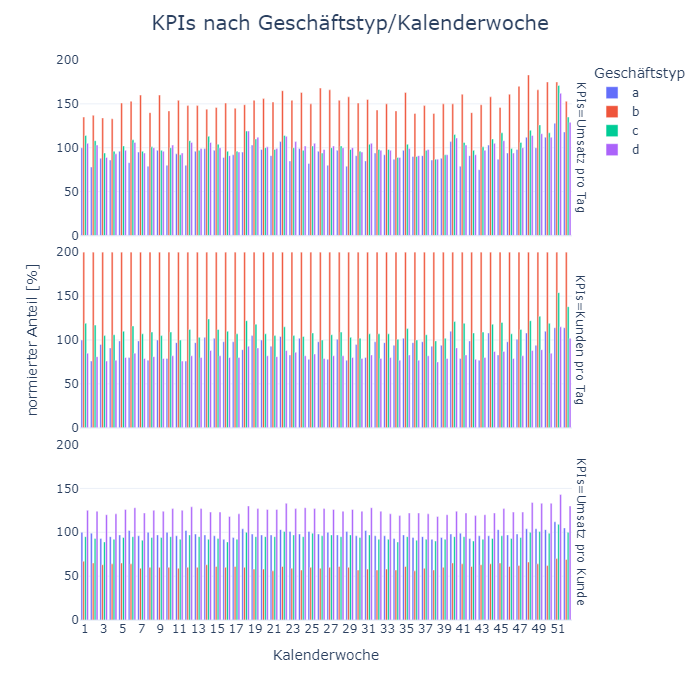

In [109]:
# Nur reguläre Tage und keine Schulferien
df_type = df_daily.copy()
df_type = df_type[(df_type.regulärer_Tag == 1) & (df_type.ist_Promo2 == 0) & (df_type.Promo == 0)]

df_type = df_type.groupby(["Geschäftstyp", "Kalenderwoche"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# df neu auslegen
df_type_melt = pd.melt(df_type, id_vars=["Geschäftstyp", "Kalenderwoche"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_type_melt.Geschäftstyp = df_type_melt.Geschäftstyp.replace({0: "regulärer Tag", 1: "Geschäftstyp Tag"})
df_type_melt.Kalenderwoche = df_type_melt.Kalenderwoche.astype("str")


#Plotten
fig = px.bar(df_type_melt, x="Kalenderwoche", y="Anteil", color="Geschäftstyp", barmode="group", facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Geschäftstyp/Kalenderwoche", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[0, 200]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Typ b hat sein maximum in Kalenderwoche 48, während die anderen ihr Maximum in KW 51 haben. Trotzdem sind sie niedriger als b.  

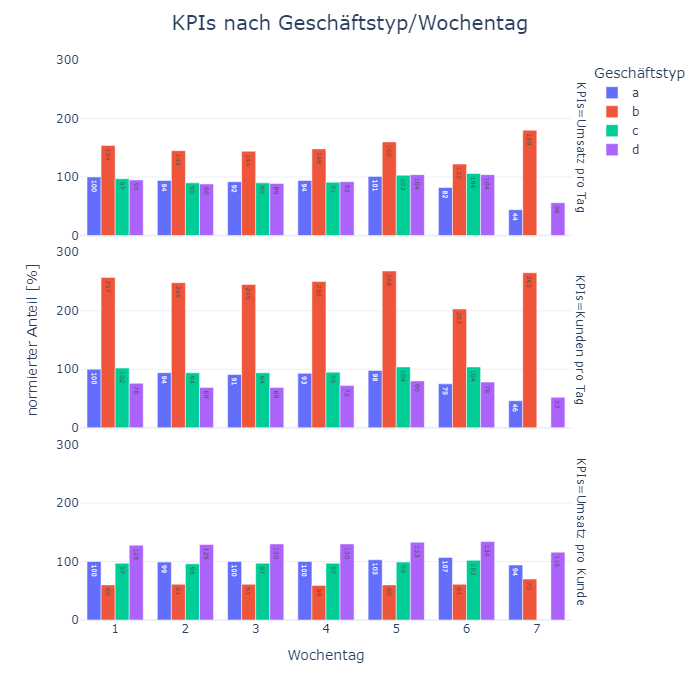

In [110]:
# Nur reguläre Tage 
df_type = df_daily.copy()
df_type = df_type[(df_type.regulärer_Tag == 1) & (df_type.ist_Promo2 == 0) & (df_type.Promo == 0)]


df_type = df_type.groupby(["Geschäftstyp", "Wochentag"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# df neu auslegen
df_type_melt = pd.melt(df_type, id_vars=["Geschäftstyp", "Wochentag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_type_melt.Geschäftstyp = df_type_melt.Geschäftstyp.replace({0: "regulärer Tag", 1: "Geschäftstyp Tag"})
df_type_melt.Wochentag = df_type_melt.Wochentag.astype("str")


#Plotten
fig = px.bar(df_type_melt, x="Wochentag", y="Anteil", color="Geschäftstyp", barmode="group", text_auto=True, facet_row="KPIs")

fig.update_layout(title_text="KPIs nach Geschäftstyp/Wochentag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  yaxis1_title="", yaxis=dict(range=[0, 300]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")



fig.show()

Typ c hat als einziger Sonntags geschlossen und a sowie d erzielen Sonntag nur ca. die Hälfte. Sonntag ist der erfolgreichste Tag für b.  

### 4.7.2. <a id='toc4_7_2_'></a>Irreguläre Tage [&#9650;](#toc0_)

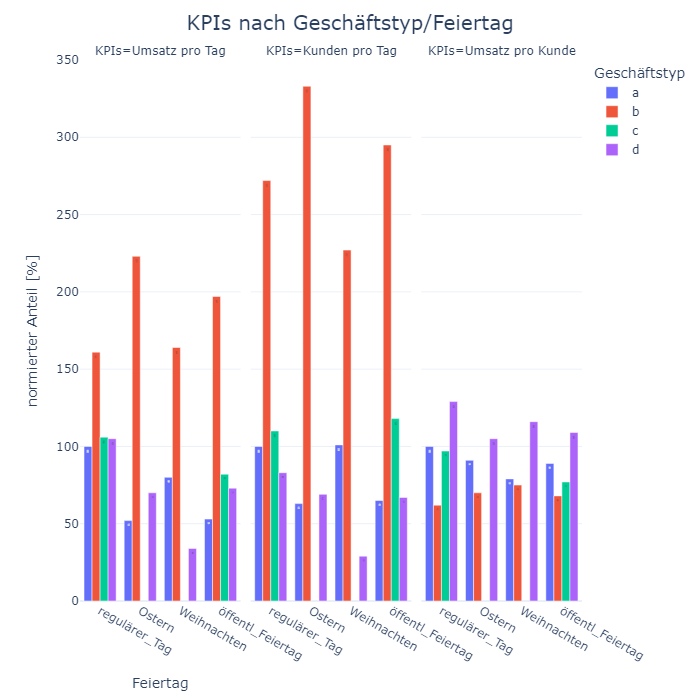

In [111]:

# Nur reguläre Tage und keine Schulferien
df_type = df_daily.copy()
df_type = df_type[(df_type.ist_Promo2 == 0) & (df_type.Promo == 0)]

df_type['Feiertag'] = df_type[["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]].idxmax(axis=1)
# Kategorien in der gewünschten Reihenfolge definieren
categories = ["regulärer_Tag", "Ostern", "Weihnachten", "öffentl_Feiertag"]
df_type['Feiertag'] = pd.Categorical(df_type['Feiertag'], categories=categories, ordered=True)

df_type = df_type.groupby(["Geschäftstyp", "Feiertag"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# df neu auslegen
df_type_melt = pd.melt(df_type, id_vars=["Geschäftstyp", "Feiertag"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_type_melt.Geschäftstyp = df_type_melt.Geschäftstyp.replace({0: "regulärer Tag", 1: "Geschäftstyp Tag"})
df_type_melt.Feiertag = df_type_melt.Feiertag.astype("str")


#Plotten
fig = px.bar(df_type_melt, x="Feiertag", y="Anteil", color="Geschäftstyp", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach Geschäftstyp/Feiertag", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[0, 350]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




Typ c hat auch an Ostern und Weihnachten geschlossen. Während a und d unter den Feiertagen leiden, steigt der Umsatz in b stark an. Typ d hat jedoch den höchsten Umsatz pro Kunden, welcher an den Feiertagen fällt.  

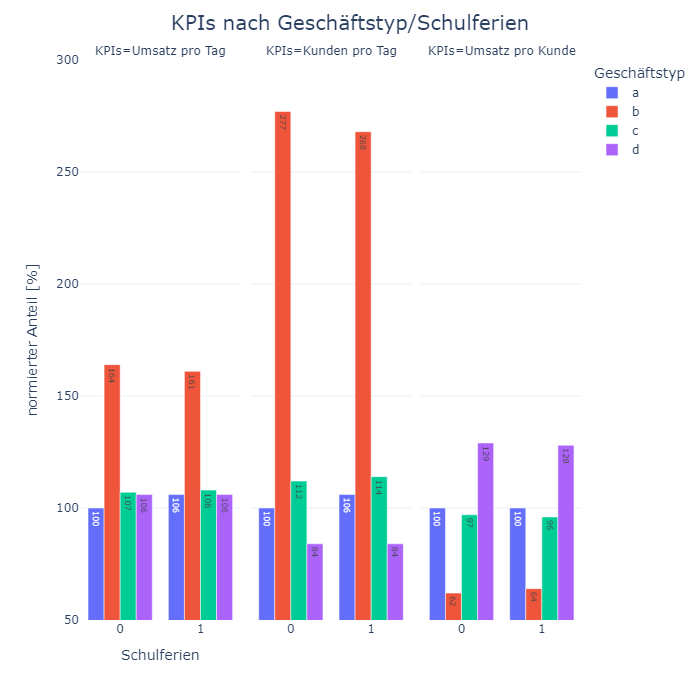

In [112]:

# Nur reguläre Tage und keine Schulferien
df_type = df_daily.copy()
df_type = df_type[(df_type.ist_Promo2 == 0) & (df_type.Promo == 0)]

df_type = df_type.groupby(["Geschäftstyp", "Schulferien"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# df neu auslegen
df_type_melt = pd.melt(df_type, id_vars=["Geschäftstyp", "Schulferien"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
df_type_melt.Geschäftstyp = df_type_melt.Geschäftstyp.replace({0: "regulärer Tag", 1: "Geschäftstyp Tag"})
df_type_melt.Schulferien = df_type_melt.Schulferien.astype("str")


#Plotten
fig = px.bar(df_type_melt, x="Schulferien", y="Anteil", color="Geschäftstyp", barmode="group", text_auto=True, facet_col="KPIs")

fig.update_layout(title_text="KPIs nach Geschäftstyp/Schulferien", title_font_size=20, title_x=0.5, template="plotly_white", height=700,
                  xaxis2_title="", yaxis=dict(range=[50, 300]),
                  yaxis1_title="normierter Anteil [%]", xaxis3_title="")




Schulferien hat kaum einen Einfluss auf den Geschäftstyp  

### 4.7.3. <a id='toc4_7_3_'></a>Promo [&#9650;](#toc0_)

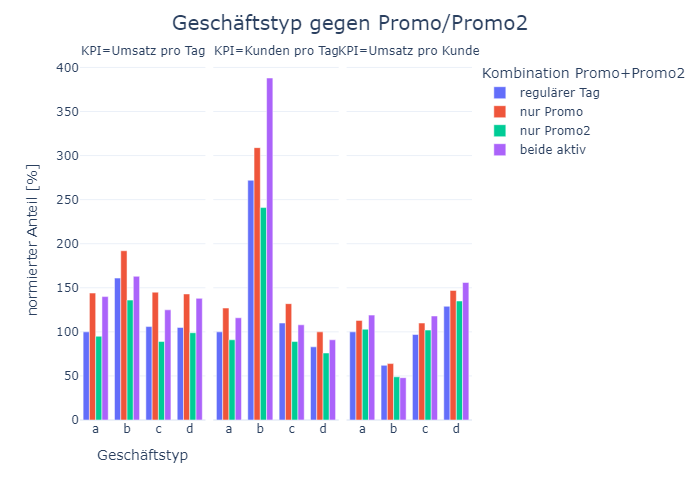

In [113]:

df_type = df_daily.copy()
df_type = df_type[(df_type.regulärer_Tag == 1)]

df_type = df_type.groupby(["Geschäftstyp", "ist_Promo2", "Promo"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index().sort_index()

# normieren 
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# Kombination von Promo und Promo2, sowie umbennen
df_type.ist_Promo2 = df_type.ist_Promo2.astype("str") 
df_type.Promo = df_type.Promo.astype("str") 
df_type["Kombination Promo+Promo2"] = df_type.Promo + " " + df_type.ist_Promo2
df_type["Kombination Promo+Promo2"] = df_type["Kombination Promo+Promo2"].replace({"0 0": "regulärer Tag", "1 0": "nur Promo", "0 1": "nur Promo2", "1 1": "beide aktiv"})


df_type_melt = pd.melt(df_type, id_vars=["Kombination Promo+Promo2", "Geschäftstyp"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.bar(df_type_melt, x="Geschäftstyp", y="normierter Anteil [%]", color="Kombination Promo+Promo2", barmode="group", text_auto=True, facet_col="KPI")


fig.update_layout(title_text="Geschäftstyp gegen Promo/Promo2", title_font_size=20, title_x=0.5, template="plotly_white",
                  xaxis1_title="Geschäftstyp",xaxis2_title="", xaxis3_title="",
                  showlegend=True)
fig.write_image("..\\Ausgewählte_Plots\\KPIs_für_Geschäftstyp_und_Promos.png")
fig.show()

Promo verhält sich realtiv gesehen gleich zum allgemeinen Trend von Promo

### 4.7.4. <a id='toc4_7_4_'></a>Sortiment [&#9650;](#toc0_)

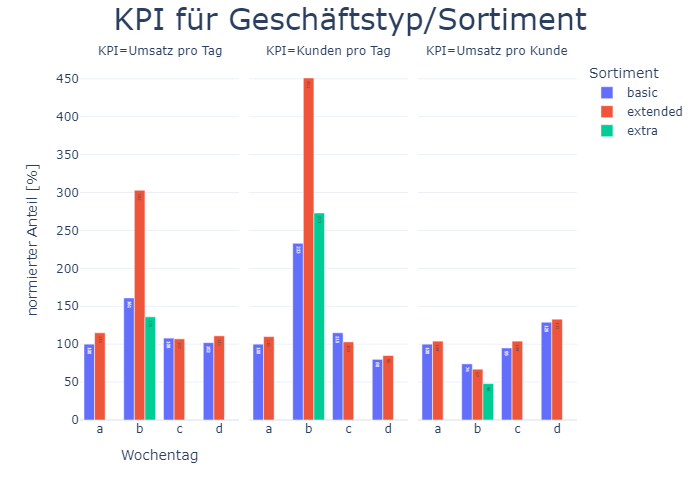

In [114]:
df_type = df_daily.copy()
df_type = df_type.groupby(["Geschäftstyp", "Sortiment"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren 
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)


# df neu auslegen
df_type_melt = pd.melt(df_type, id_vars=["Geschäftstyp", "Sortiment"], value_name="Prozent", value_vars=metriken_normiert, var_name="KPI")
df_type_melt.Sortiment = df_type_melt.Sortiment.replace({0: "regulärer Tag", 1: "Promo2 Tag"})

fig= px.bar(df_type_melt, x="Geschäftstyp", y="Prozent", color="Sortiment", barmode="group", facet_col="KPI",
            text_auto=True)
 
 # Layout anpassen
fig.update_layout(title_text="KPI für Geschäftstyp/Sortiment", title_font_size=30, title_x=0.5, template="plotly_white",
                  xaxis1_title="Wochentag", xaxis2_title="", xaxis3_title="", yaxis1_title="normierter Anteil [%]",
                  legend_title="Sortiment")


fig.show()


extended erhöht für alle Geschäftstypen den Umsatz, aber am stärksten bei b. extra gibt es nur bei  b, aber hier führt es zur Verschlechterung. a und d basic sind ungefähr gleich. typ d extended hat den höchsten Umsatz pro Kunden  

### 4.7.5. <a id='toc4_7_5_'></a>Sortiment und Promo [&#9650;](#toc0_)

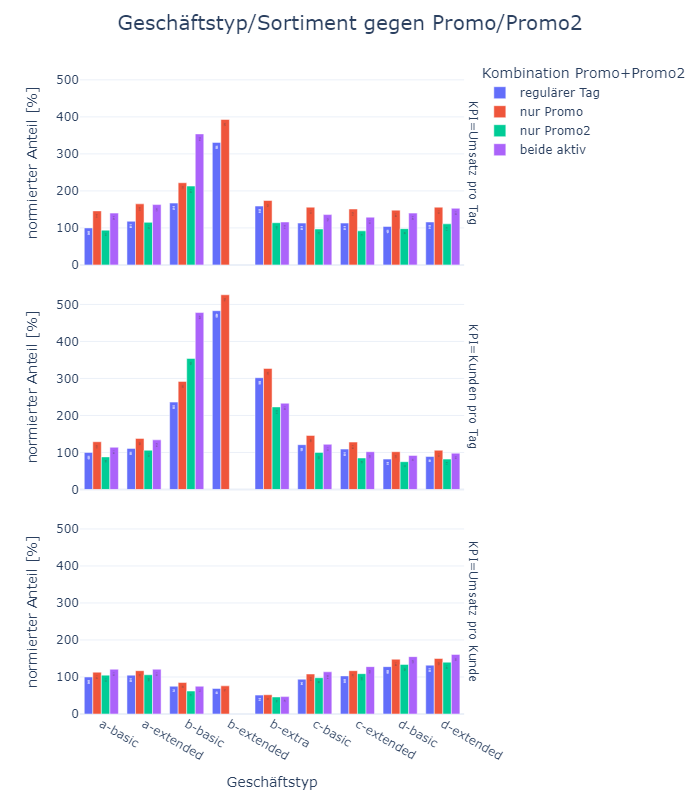

In [115]:

df_type = df_daily.copy()
df_type = df_type[(df_type.regulärer_Tag == 1)]

df_type = df_type.groupby(["Geschäftstyp", "Sortiment", "ist_Promo2", "Promo"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index().sort_index()

# normieren 
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# Kombination von Promo und Promo2, sowie umbennen
df_type.ist_Promo2 = df_type.ist_Promo2.astype("str") 
df_type.Promo = df_type.Promo.astype("str") 
df_type["Kombination Promo+Promo2"] = df_type.Promo + " " + df_type.ist_Promo2
df_type["Kombination Promo+Promo2"] = df_type["Kombination Promo+Promo2"].replace({"0 0": "regulärer Tag", "1 0": "nur Promo", "0 1": "nur Promo2", "1 1": "beide aktiv"})
df_type["Kombination Typ+Sortiment"] = df_type.Geschäftstyp + "-" + df_type.Sortiment


df_type_melt = pd.melt(df_type, id_vars=["Kombination Promo+Promo2", "Kombination Typ+Sortiment"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.bar(df_type_melt, x="Kombination Typ+Sortiment", y="normierter Anteil [%]", color="Kombination Promo+Promo2", barmode="group", text_auto=True, facet_row="KPI")


fig.update_layout(title_text="Geschäftstyp/Sortiment gegen Promo/Promo2", title_font_size=20, title_x=0.5, template="plotly_white", height=800,
                  xaxis1_title="Geschäftstyp",xaxis2_title="", xaxis3_title="",
                  showlegend=True)
fig.write_image("..\\Ausgewählte_Plots\\Wirkung_der_Promos_auf_Geschäftstyp_und_Sortiment.png")
fig.show()

in b-extended läuft keine Promo2. Außerdem erzielt dieser den meisten Umsatz an einem regulären Tag und während Promo läuft. Die größten Anstieg erfährt b-basic wenn Promo und Promo2 zusammen laufen.
b-extra leider an Promo2 und beiden zusammen, während Promo eine Erhöhung bringt.  
d_extended hat den höchsten Umsatz pro Kunden für alle Promo Kombinationen.  

## 4.8. <a id='toc4_8_'></a>Bundesländer [&#9650;](#toc0_)

### 4.8.1. <a id='toc4_8_1_'></a>KPIs [&#9650;](#toc0_)

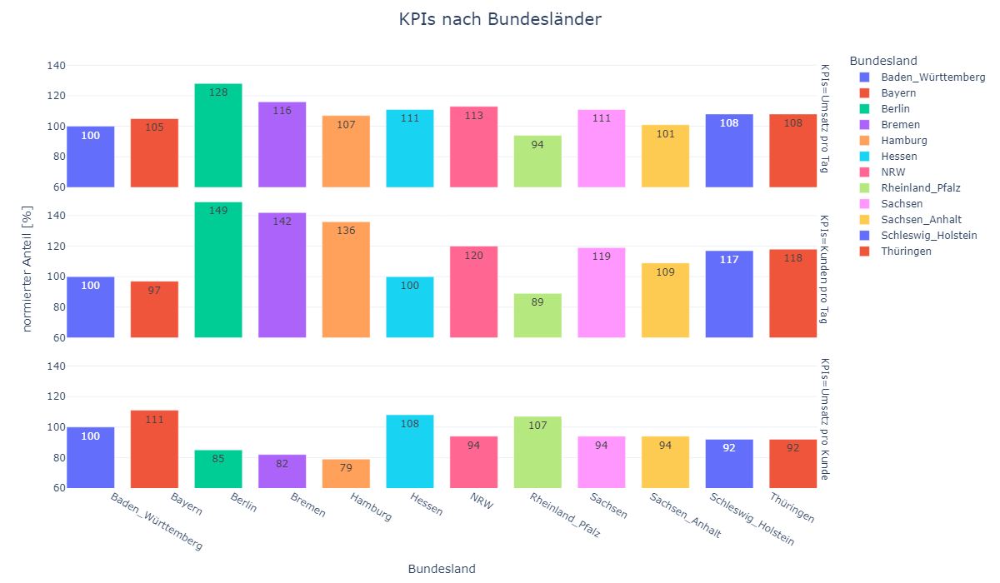

In [116]:
# Nur reguläre Tage
df_länder = df_daily.copy()

df_länder = df_länder.groupby(["Bundesland"]).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_länder["Umsatz_pro_Kunde"] = round(df_länder["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_länder[metriken_normiert] = round(df_länder[metriken].div(df_länder[metriken].iloc[0].values) * 100)

# df neu auslegen
df_länder_melt = pd.melt(df_länder, id_vars=["Bundesland"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")

#Plotten
fig = px.bar(df_länder_melt, x="Bundesland", y="Anteil", color="Bundesland", barmode="group", text_auto=True, facet_row="KPIs")
fig.update_traces(width=0.8)
fig.update_layout(title_text="KPIs nach Bundesländer", title_font_size=20, title_x=0.5, template="plotly_white", height=700, width=1200,
                  yaxis1_title="", yaxis=dict(range=[60, 150]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")

fig.show()

Der Höchste Umsatz pro Tag ist in Berlin, jedoch hat Bayern den Höchsten Umsatz pro Kunden. Am schlechtesten schneidet Rheinland Pfalz beim Umsatz pro Tag ab, während Hamburg den niedrigsten Umsatz pro Kunden hat.

### 4.8.2. <a id='toc4_8_2_'></a>Geschäftstyp und Sortiment [&#9650;](#toc0_)

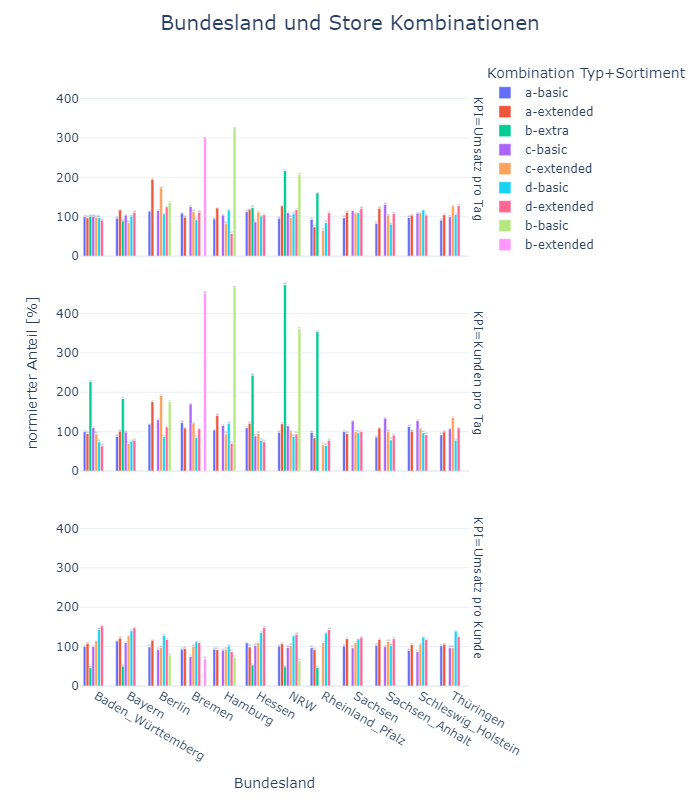

In [117]:

df_type = df_daily.copy()

df_type = df_type.groupby(["Bundesland", "Geschäftstyp", "Sortiment"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index().sort_index()

# normieren 
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# Kombination von Typ+Sortiment
df_type["Kombination Typ+Sortiment"] = df_type.Geschäftstyp + "-" + df_type.Sortiment


df_type_melt = pd.melt(df_type, id_vars=["Bundesland", "Kombination Typ+Sortiment"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.bar(df_type_melt, x="Bundesland", y="normierter Anteil [%]", color="Kombination Typ+Sortiment", barmode="group", text_auto=True, facet_row="KPI")


fig.update_layout(title_text="Bundesland und Store Kombinationen", title_font_size=20, title_x=0.5, template="plotly_white", height=800,
                  xaxis1_title="Bundesland",yaxis2_title="normierter Anteil [%]", yaxis3_title="", yaxis1_title="",
                  showlegend=True)


Keines der Bundesländer hat alle 9 Kombinationen. Die meisten Kombinationen mit 8 liegen in NRW. B-extendend gibt es nur in Bremen. b-basic in Hambrug hat den höchsten Umsatz pro Tag.  

### 4.8.3. <a id='toc4_8_3_'></a>Anzahl Filialen pro Bundesland [&#9650;](#toc0_)

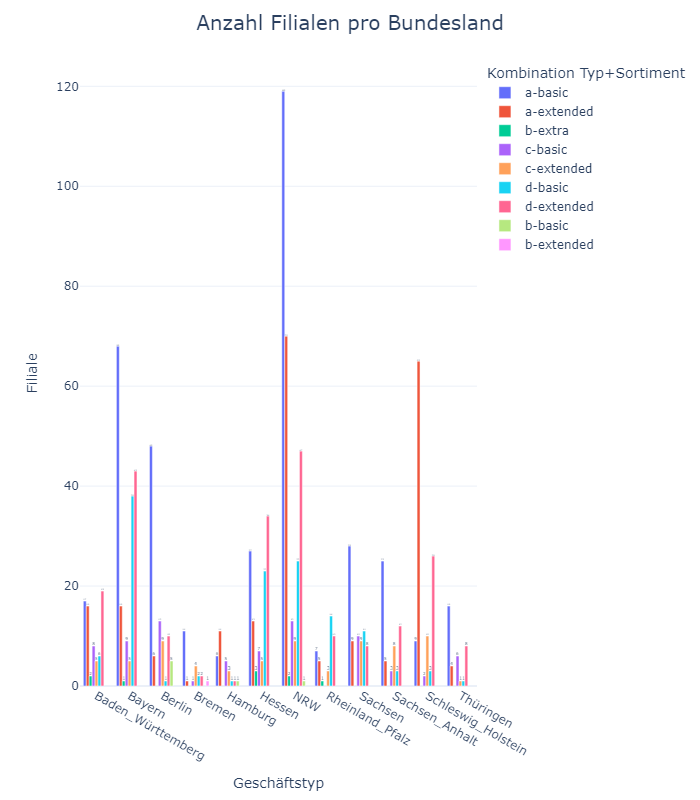

In [118]:

df_type = df_agg.copy()

# Kombination von Typ+Sortiment
df_type["Kombination Typ+Sortiment"] = df_type.Geschäftstyp + "-" + df_type.Sortiment

df_type = df_type.groupby(["Bundesland", "Kombination Typ+Sortiment"]).agg({"Filiale": "count"}).reset_index()

fig = px.bar(df_type, x="Bundesland", y="Filiale", color="Kombination Typ+Sortiment", barmode="group", text_auto=True)


fig.update_layout(title_text="Anzahl Filialen pro Bundesland", title_font_size=20, title_x=0.5, template="plotly_white", height=800,
                  xaxis1_title="Geschäftstyp",
                  showlegend=True)


Die meisten Filialen sind in NRW. a-basic ist generell in jedem Bundesland am meisten vertreten, außer Hamburg mit a-extended, Rheinland-Pfalz mit d-basic und Schleswig Holstein mit a-extended.  

## 4.9. <a id='toc4_9_'></a>Gruppierung [&#9650;](#toc0_)

### 4.9.1. <a id='toc4_9_1_'></a>KPIs [&#9650;](#toc0_)

Die Gruppierung erfolgte nach Umsatz pro Tag wlche als die besten klassifiziert wurden.  

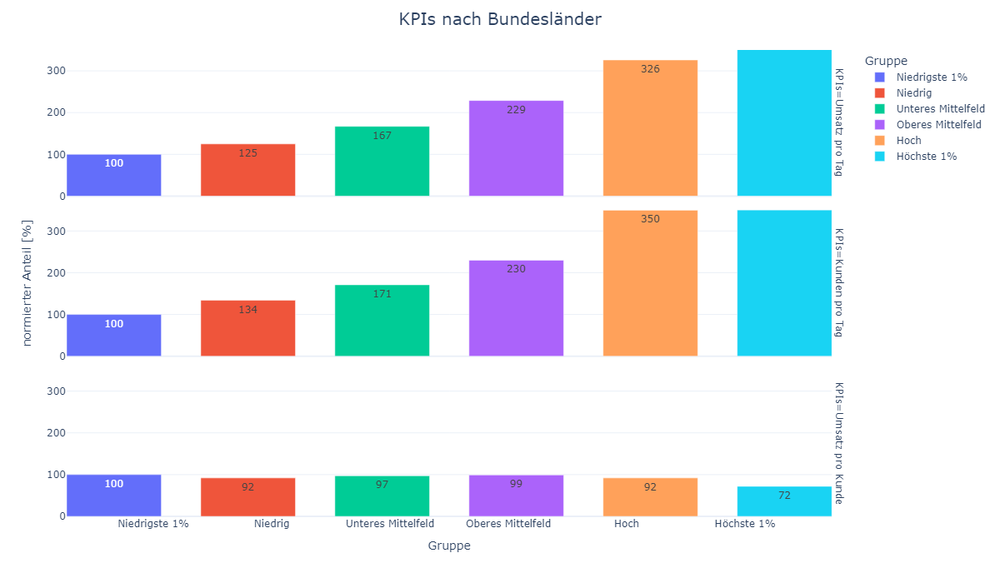

In [119]:
# Nur reguläre Tage
df_länder = df_daily.copy()

df_länder = df_länder.groupby(["Gruppe"], observed=False).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index()

# normieren auf ersten wert
df_länder["Umsatz_pro_Kunde"] = round(df_länder["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_länder[metriken_normiert] = round(df_länder[metriken].div(df_länder[metriken].iloc[0].values) * 100)

# df neu auslegen
df_länder_melt = pd.melt(df_länder, id_vars=["Gruppe"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")

#Plotten
fig = px.bar(df_länder_melt, x="Gruppe", y="Anteil", color="Gruppe", barmode="group", text_auto=True, facet_row="KPIs")
fig.update_traces(width=0.8)
fig.update_layout(title_text="KPIs nach Bundesländer", title_font_size=20, title_x=0.5, template="plotly_white", height=700, width=1200,
                  yaxis1_title="", yaxis=dict(range=[0, 350]),
                  yaxis2_title="normierter Anteil [%]", yaxis3_title="")

fig.show()

### 4.9.2. <a id='toc4_9_2_'></a>Geschäftstyp und Sortiment [&#9650;](#toc0_)

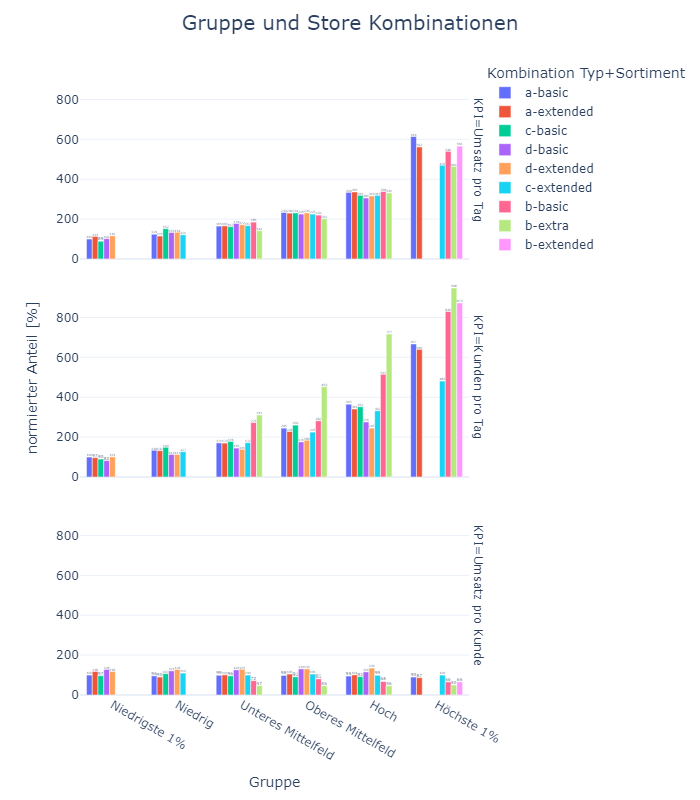

In [120]:

df_type = df_daily.copy()

df_type = df_type.groupby(["Gruppe", "Geschäftstyp", "Sortiment"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index().sort_index()

# normieren 
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)

# Kombination von Typ+Sortiment
df_type["Kombination Typ+Sortiment"] = df_type.Geschäftstyp + "-" + df_type.Sortiment


df_type_melt = pd.melt(df_type, id_vars=["Gruppe", "Kombination Typ+Sortiment"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.bar(df_type_melt, x="Gruppe", y="normierter Anteil [%]", color="Kombination Typ+Sortiment", barmode="group", text_auto=True, facet_row="KPI")


fig.update_layout(title_text="Gruppe und Store Kombinationen", title_font_size=20, title_x=0.5, template="plotly_white", height=800,
                  xaxis1_title="Gruppe",yaxis2_title="normierter Anteil [%]", yaxis3_title="", yaxis1_title="",
                  showlegend=True)


Ein klarer Trend von der Verteilung der Kombinationen ist ersichtlich. Die Top Filialen haben nur d-basic und d-extended, während die schlechstesten a-basic, b-extra und c-basic haben.  

### 4.9.3. <a id='toc4_9_3_'></a>Anzahl Filialen pro Bundesland [&#9650;](#toc0_)

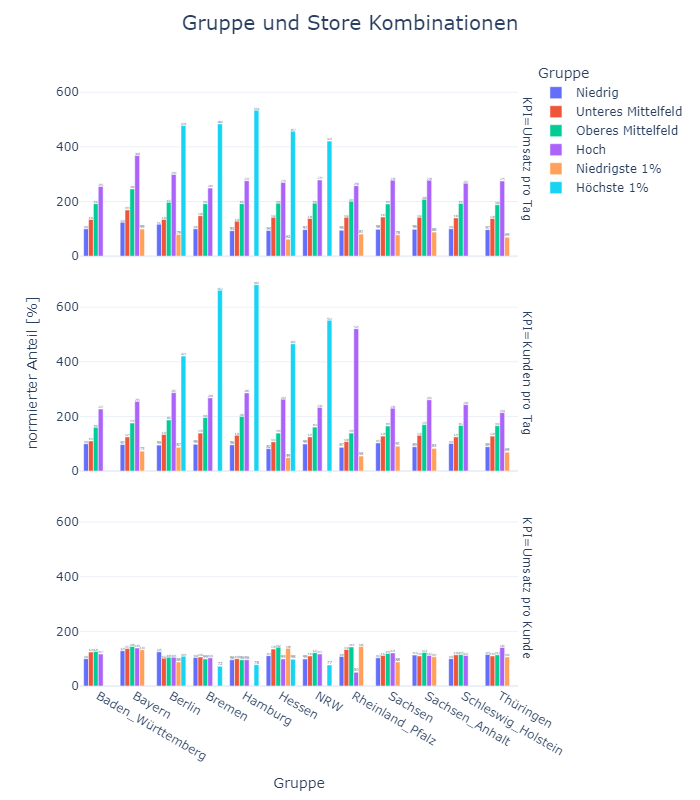

In [121]:

df_type = df_daily.copy()

df_type = df_type.groupby(["Bundesland", "Gruppe"], observed=True).agg({"Umsatz_pro_Tag": "median", "Kunden_pro_Tag": "median", "Umsatz_pro_Kunde": "median"}).reset_index().sort_index()

# normieren 
df_type["Umsatz_pro_Kunde"] = round(df_type["Umsatz_pro_Kunde"], 2)
metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
df_type[metriken_normiert] = round(df_type[metriken].div(df_type[metriken].iloc[0].values) * 100)


df_type_melt = pd.melt(df_type, id_vars=["Bundesland", "Gruppe"], value_name="normierter Anteil [%]", value_vars=metriken_normiert, var_name="KPI")

fig = px.bar(df_type_melt, x="Bundesland", y="normierter Anteil [%]", color="Gruppe", barmode="group", text_auto=True, facet_row="KPI")


fig.update_layout(title_text="Gruppe und Store Kombinationen", title_font_size=20, title_x=0.5, template="plotly_white", height=800,
                  xaxis1_title="Gruppe",yaxis2_title="normierter Anteil [%]", yaxis3_title="", yaxis1_title="",
                  showlegend=True)


Die Top Filialen sind in Baden Württemberg, Hessen, Rheinland Pfalz und Sachsen-Anhalt. Die schlechtesten sind in Baden Württemberg, Bayern, Hessen, NRW und Rheinland-Pfalz.  

## 4.10. <a id='toc4_10_'></a>Zusammenfassung der EDA [&#9650;](#toc0_)

- Top-Filialen: Baden-Württemberg, Hessen, Rheinland-Pfalz, Sachsen-Anhalt.
- Schlechteste Filialen: Baden-Württemberg, Bayern, Hessen, NRW, Rheinland-Pfalz.
- Top-Filialen haben nur d-basic und d-extended.
- Schlechteste Filialen haben a-basic, b-extra und c-basic.
- Meiste Filialen in NRW
- Höchster Umsatz pro Tag in Berlin, höchster Umsatz pro Kunde in Bayern.
- b-extended hat keine Promo2, erzielt höchsten Umsatz an regulären Tagen und während Promo.
- d-extended hat höchsten Umsatz pro Kunde für alle Promo-Kombinationen.
- Schulferien haben kaum Einfluss auf Umsatz
- Typ b hat höchsten Umsatz und Kunden pro Tag, Typ d höchsten Umsatz pro Kunde.
- Basic und extended profitieren am meisten von Promotions.
- Umsatz und Kunden pro Tag fallen mit der Distanz zu Wettbewerbern
- Promo2 läuft nicht an Weihnachten, erhöht Umsatz an Ostern.
- Umsatz steigt bis Mai, fällt bis September und erreicht Maximum im Dezember.

**Zukünftige Implikationen:**
Regionale Strategien:  
    - Top-Filialen: Fokussierung auf die Optimierung und Erweiterung von d-basic und d-extended Filialen in Baden-Württemberg, Hessen, Rheinland-Pfalz und Sachsen-Anhalt.  
    - Schlechteste Filialen: Analyse und Verbesserung der a-basic, b-extra und c-basic Filialen in den betroffenen Regionen, insbesondere in Bayern und NRW.   
    
Promotionsmanagement:  
    - Saisonale Trends: Anpassung der Promotionsstrategien basierend auf saisonalen Umsatztrends, um den Umsatzrückgang von September bis November zu minimieren.  

Kundensegmentierung:  
    - Typ b und d: Entwicklung gezielter Marketingkampagnen für Typ b (höchster Umsatz und Kunden pro Tag) und Typ d (höchster Umsatz pro Kunde), um deren Stärken weiter zu nutzen.  


**Zukünftige Features für die EDA:**  
Regionale Umsatzanalyse:  
    - Erweiterte Analyse der Umsatzdaten nach Regionen, um spezifische regionale Trends und Muster zu identifizieren.   

Kundenverhaltensanalyse:  
    - Erweiterte Analyse des Kundenverhaltens, um Einblicke in die Präferenzen und das Kaufverhalten verschiedener Kundensegmente zu gewinnen.  

Produktverkaufsanalsye:  
    - Erweiterte Analyse der gewinnbringenden Produkte


# 5. <a id='toc5_'></a>Datenpreprozessierung [&#9650;](#toc0_)

## 5.1. <a id='toc5_1_'></a>Dataframes laden und auf wöchentlich aggregieren [&#9650;](#toc0_)

In [122]:
# Dataframes laden
df_daily = pd.read_parquet("..\\Save_files\\df_daily.parquet", engine='pyarrow')
df_agg = pd.read_parquet("..\\Save_files\\df_agg.parquet", engine='pyarrow')


Zunächst die Daten auf wöchentliche Ebene aggregieren um Datenmenge zu reduzieren

In [123]:
df_weekly = df_daily.copy()
df_weekly.set_index("Datum", inplace=True)
# Listen mit Spaltennamen für Aggregationsfunktion erstellen 
to_sum = ['Umsatz', 'Kundenzahl', 'Geöffnet',
          'Promo', 'ist_Promo2', 'Schulferien', 
          'Ostern', 'Weihnachten', 'öffentl_Feiertag',
          'regulärer_Tag', "Sonntag"]

# zweite Liste für Aggregationsfunktion
to_last = ['Geschäftstyp', 'Sortiment', "Bundesland", "Gruppe",
           'Wettbew_Distanz', 'Wettbew_seit_Monaten',
           'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr',
           'Promo2', 'Promo2_Intervall', 'Promo2_seit_Wochen', 
           'Promo2_seit_Woche','Promo2_seit_Jahr',
           'Jahr', 'Quartal', 'Monat', 'Kalenderwoche']

# Aggregationsfunktionen für die Spalten
agg_funcs = {col: 'sum' for col in to_sum}
agg_funcs.update({col: 'last' for col in to_last})

df_weekly = df_weekly.groupby("Filiale").resample("W").agg(agg_funcs).reset_index()
df_weekly.dropna(inplace=True)

## 5.2. <a id='toc5_2_'></a>Transformieren [&#9650;](#toc0_)

In [124]:
df = df_weekly.copy().reset_index(drop=True)

# Zielvariable Umsatz logarithmieren
df.Umsatz = np.log(df.Umsatz)

# kategorische Variable Gruppe in numerisch umwandeln
df['Gruppe'] = df['Gruppe'].cat.codes

# OneHot Kodierung für ['Geschäftstyp', 'Sortiment', 'Bundesland']
to_encode = ['Geschäftstyp', 'Sortiment', 'Bundesland']
ohe = OneHotEncoder(sparse_output=False)
ohe.fit(df[to_encode].astype("str"))
# Für df
enc_columns = ohe.transform(df[to_encode].astype("str"))
# Dataframe with encoded columns
encoded_df = pd.DataFrame(enc_columns,
                        columns=ohe.get_feature_names_out(to_encode))
# adding encoded columns to train
df = pd.concat([df, encoded_df], axis=1).drop(columns=to_encode, axis=1)

# temporale Angaben zyklisieren
to_cyclic = ["Quartal", "Monat", "Kalenderwoche", "Jahr"]
# Quartal
df['Quartal_sin'] = df['Quartal'].apply(lambda x: np.sin(x*(2*np.pi/4)))
df['Quartal_cos'] = df['Quartal'].apply(lambda x: np.cos(x*(2*np.pi/4)))
# Monat
df['Monat_sin'] = df['Monat'].apply(lambda x: np.sin(x*(2*np.pi/12)))
df['Monat_cos'] = df['Monat'].apply(lambda x: np.cos(x*(2*np.pi/12)))
# Kalenderwoche (W)
df['Kalenderwoche_sin'] = df['Kalenderwoche'].apply(lambda x: np.sin(x*(2*np.pi/52)))
df['Kalenderwoche_cos'] = df['Kalenderwoche'].apply(lambda x: np.cos(x*(2*np.pi/52)))
# Jahr
df['Jahr_sin'] = df['Jahr'].apply(lambda x: np.sin(x*(2*np.pi/365)))
df['Jahr_cos'] = df['Jahr'].apply(lambda x: np.cos(x*(2*np.pi/365)))

# zu löschen
df.drop(columns=["Promo2_Intervall", "Kundenzahl"], inplace=True)
df.sort_values(["Datum", "Filiale"], inplace=True)

## 5.3. <a id='toc5_3_'></a>Splitten [&#9650;](#toc0_)

In [125]:
print(f"Datum min {df.Datum.min()}")
print(f"Datum max {df.Datum.max()}")

Datum min 2013-01-06 00:00:00
Datum max 2015-08-02 00:00:00


In [126]:
# Splitten
timestamp = pd.Timestamp(df["Datum"].sort_values().iloc[-1])
split_point = timestamp - pd.Timedelta(days=(7*8))
df_train_valid = df[df["Datum"] < split_point].reset_index(drop=True).copy()
df_test = df[df["Datum"] >= split_point].reset_index(drop=True).copy()

print(f"Train_Valid Datum min {df_train_valid.Datum.min()}")
print(f"Train_Valid Datum max {df_train_valid.Datum.max()}")
print(f"Test Datum min {df_test.Datum.min()}")
print(f"Test Datum max {df_test.Datum.max()}")

Train_Valid Datum min 2013-01-06 00:00:00
Train_Valid Datum max 2015-05-31 00:00:00
Test Datum min 2015-06-07 00:00:00
Test Datum max 2015-08-02 00:00:00


Split-Punkt des Datensatzes für test und train_valid

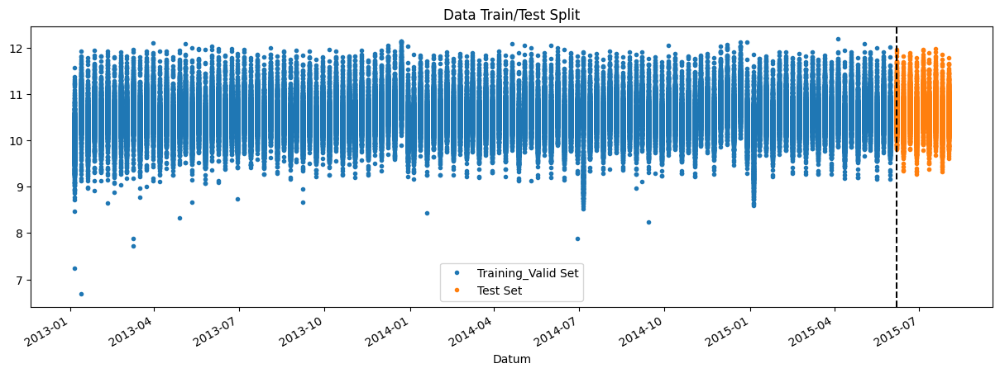

In [127]:
fig, ax = plt.subplots(figsize=(15,5))
df_train_valid.sort_values(["Umsatz","Datum"]).plot(ax=ax, x="Datum", y="Umsatz", label="Training Set", title="Data Train/Test Split", style=".")
df_test.sort_values(["Umsatz","Datum"]).plot(ax=ax, x="Datum", y="Umsatz", label="Test Set", style=".")
ax.axvline(split_point, color="black", ls="--")
ax.legend(["Training_Valid Set", "Test Set"])
plt.show()

df_train_valid in ebenfalls splitten

In [128]:
# Splitten
timestamp = pd.Timestamp(df_train_valid["Datum"].sort_values().iloc[-1])
split_point = timestamp - pd.Timedelta(days=(7*8))
df_train = df_train_valid[df_train_valid["Datum"] < split_point].reset_index(drop=True).copy()
df_valid = df_train_valid[df_train_valid["Datum"] >= split_point].reset_index(drop=True).copy()

print(f"Train Datum min {df_train.Datum.min()}")
print(f"Train Datum max {df_train.Datum.max()}")
print(f"Valid Datum min {df_valid.Datum.min()}")
print(f"Valid Datum max {df_valid.Datum.max()}")

Train Datum min 2013-01-06 00:00:00
Train Datum max 2015-03-29 00:00:00
Valid Datum min 2015-04-05 00:00:00
Valid Datum max 2015-05-31 00:00:00


Die Metriken zur Evaluation sind MAE, R2 und RMSE

In [129]:
def metriken(y_test, y_pred):
    # Berechne die Metriken
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    return mae, r2, rmse

Testen eines simplen Random Forest Regressionsmodell mit df_train und df_valid

In [130]:
# Train Daten
X_train = df_train.drop(["Umsatz", "Datum"], axis=1)
y_train = df_train['Umsatz']
# Test Daten
X_test = df_valid.drop(["Umsatz", "Datum"], axis=1)
y_test = df_valid['Umsatz']

rf = RandomForestRegressor(n_jobs=-1).fit(X_train, y_train)

# Vorhersage
y_pred = rf.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

results_transform = pd.DataFrame({"Features": ["alle"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
results = results_transform
results

,Features,MAE,R2,RMSE
0,alle,0.06763,0.940697,0.091413


Im nächsten Schritt suchen wir die besten Features aus um Overfitting und Rechenzeit zu reduzieren. Bei den Features wird Kundenzahl gelöscht, da dies keine statische Information ist.

# 6. <a id='toc6_'></a>Feature Selection [&#9650;](#toc0_)

Hier werden mittels 3 Ansätzem Features rausgesucht und am Ende verglichen. 

## 6.1. <a id='toc6_1_'></a>per Korrelation [&#9650;](#toc0_)

In [131]:
# Korrelation
df_corr=df.drop(columns=["Datum"]).corr()

# Korrelation berechnen für den Einfluss der Faktoren auf SalesPerDay
df_corr = round(df_corr["Umsatz"].sort_values().reset_index(), 2)
df_corr.columns = ["Feature", "Importance"]

# sortieren
df_corr = df_corr.sort_values(by="Importance", key=lambda x: abs(x), ascending=False)
# threshold von 0.1
df_corr = df_corr[df_corr.Importance.abs() >= 0.1]
np.array(df_corr.Feature)


array(['Umsatz', 'Gruppe', 'Promo', 'Geöffnet', 'regulärer_Tag',
       'Geschäftstyp_b', 'Sonntag', 'Promo2', 'Bundesland_Berlin',
       'Promo2_seit_Jahr', 'Sortiment_basic', 'Sortiment_extended'],
      dtype=object)

In [132]:
features_korr = ['Gruppe', 'Promo', 'Geöffnet', 'regulärer_Tag',
       'Geschäftstyp_b', 'Sonntag', 'Bundesland_Berlin',
       'Promo2_seit_Jahr', 'Promo2', 'Sortiment_basic',
       'Sortiment_extended']

def features_testen(features_list, df_train, df_valid):
       # Train Daten
       X_train = df_train[features_list]
       y_train = df_train['Umsatz']
       # Test Daten
       X_test = df_valid[features_list]
       y_test = df_valid['Umsatz']
       rf = RandomForestRegressor(n_jobs=-1).fit(X_train, y_train)
       # Vorhersage
       y_pred = rf.predict(X_test)
       # Metriken berechnen
       mae, r2, rmse = metriken(y_test, y_pred)
       return mae, r2, rmse

mae, r2, rmse = features_testen(features_korr, df_train, df_valid)
results_korr = pd.DataFrame({"Features": ["Korrelation"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
results = pd.concat([results_transform, results_korr])
results

,Features,MAE,R2,RMSE
0,alle,0.067630,0.940697,0.091413
0,Korrelation,0.126495,0.816317,0.160881


## 6.2. <a id='toc6_2_'></a>per RandomForestRegressor [&#9650;](#toc0_)

In [133]:
# beste Features mit RandomForest
# Daten
# Train Daten
X_train = df_train.drop(["Umsatz", "Datum"], axis=1)
y_train = df_train['Umsatz']
# Test Daten
X_test = df_valid.drop(["Umsatz", "Datum"], axis=1)
y_test = df_valid['Umsatz']

# RandomForestRegressor-Modell

# SelectFromModel
select = SelectFromModel(RandomForestRegressor(n_jobs=-1, random_state=42), threshold="median")
select.fit(X_train, y_train)
# Transformieren
X_train_l1 = select.transform(X_train)
y_pred = select.transform(X_test)

# Wichtigkeit der Features
feature_importances = select.estimator_.feature_importances_
# Erstellen eines DataFrames mit den Feature-Namen und ihrer Wichtigkeit
feature_names = X_train.columns
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances}).sort_values(by='Importance', ascending=False)

# Anzeigen der ausgewählten Features
selected_features = feature_importance_df[feature_importance_df['Importance'] >= select.threshold_]
features_rf = selected_features.Feature.to_list()
np.array(features_rf)

array(['Gruppe', 'Promo', 'Bundesland_Bayern', 'Wettbew_Distanz',
       'Kalenderwoche', 'Filiale', 'Geöffnet', 'Wettbew_seit_Monaten',
       'Wettbew_offen_seit_Monat', 'Promo2_seit_Wochen', 'regulärer_Tag',
       'Wettbew_offen_seit_Jahr', 'Kalenderwoche_cos',
       'Promo2_seit_Woche', 'Kalenderwoche_sin', 'Monat', 'Monat_cos',
       'Promo2_seit_Jahr', 'Schulferien', 'Geschäftstyp_a',
       'Sortiment_basic', 'Bundesland_Berlin', 'Geschäftstyp_d',
       'Bundesland_NRW', 'Sortiment_extended'], dtype='<U24')

In [134]:
features_rfr = ['Gruppe', 'Promo', 'Bundesland_Bayern', 'Wettbew_Distanz',
       'Kalenderwoche', 'Filiale', 'Geöffnet', 'Wettbew_seit_Monaten',
       'Wettbew_offen_seit_Monat', 'Promo2_seit_Wochen', 'regulärer_Tag',
       'Wettbew_offen_seit_Jahr', 'Kalenderwoche_cos',
       'Promo2_seit_Woche', 'Kalenderwoche_sin', 'Monat', 'Monat_cos',
       'Promo2_seit_Jahr', 'Schulferien', 'Geschäftstyp_a',
       'Sortiment_basic', 'Bundesland_Berlin', 'Geschäftstyp_d',
       'Bundesland_NRW', 'Sortiment_extended']

mae, r2, rmse = features_testen(features_rfr, df_train, df_valid)
results_rf = pd.DataFrame({"Features": ["RandomForestRegressor"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
results = pd.concat([results, results_rf])
results

,Features,MAE,R2,RMSE
0,alle,0.067630,0.940697,0.091413
0,Korrelation,0.126495,0.816317,0.160881
0,RandomForestRegressor,0.067894,0.937974,0.093488


## 6.3. <a id='toc6_3_'></a>Recursive Feature Elimination (RFE) [&#9650;](#toc0_)

In [135]:
# die slected features vom rfr werden noch mal gefitlert mit RFE, aber vorher löschen einiger Spalten
# zu löschen, "Geöffnet", "Schulferien", "regulärer Tag"
features_rfr = ['Gruppe', 'Promo', 'Bundesland_Bayern', 'Wettbew_Distanz',
       'Kalenderwoche', 'Filiale', 'Geöffnet', 'Wettbew_seit_Monaten',
       'Wettbew_offen_seit_Monat', 'Promo2_seit_Wochen', 'regulärer_Tag',
       'Wettbew_offen_seit_Jahr', 'Kalenderwoche_cos',
       'Promo2_seit_Woche', 'Kalenderwoche_sin', 'Monat', 'Monat_cos',
       'Promo2_seit_Jahr', 'Schulferien', 'Geschäftstyp_a',
       'Sortiment_basic', 'Bundesland_Berlin', 'Geschäftstyp_d',
       'Bundesland_NRW', 'Sortiment_extended']

# Train Daten
X_train = df_train[features_rfr]
y_train = df_train['Umsatz']
# Test Daten
X_test = df_valid[features_rfr]
y_test = df_valid['Umsatz']

# RFE fitten
select = RFE(RandomForestRegressor(n_jobs=-1, random_state=42, max_features="sqrt"))
select.fit(X_train, y_train)

X_train_rfe = select.transform(X_train)
X_test_rfe = select.transform(X_test)

# Wichtigkeit der Features
feature_importances = select.estimator_.feature_importances_

# Erstellen eines DataFrames mit den Feature-Namen und ihrer Wichtigkeit
feature_names = X_train.columns[select.support_]
selected_features = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})

# Sortieren nach Wichtigkeit
selected_features = selected_features.sort_values(by='Importance', ascending=False)

# Anzeigen der ausgewählten Features
features_rfe = selected_features.Feature.to_list()
np.array(features_rfe)

array(['Gruppe', 'Promo', 'Wettbew_Distanz', 'Filiale', 'Kalenderwoche',
       'Wettbew_seit_Monaten', 'Geöffnet', 'Promo2_seit_Woche',
       'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr',
       'regulärer_Tag', 'Kalenderwoche_cos'], dtype='<U24')

In [136]:
features_rfe = ['Gruppe', 'Promo', 'Wettbew_Distanz', 'Filiale', 'Kalenderwoche',
       'Wettbew_seit_Monaten', 'Wettbew_offen_seit_Monat',
       'Promo2_seit_Wochen', 'Promo2_seit_Woche',
       'Wettbew_offen_seit_Jahr', 'Kalenderwoche_cos']

mae, r2, rmse = features_testen(features_rfe, df_train, df_valid)
results_rfe = pd.DataFrame({"Features": ["Recursive Elimination"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
results = pd.concat([results, results_rfe])
results

,Features,MAE,R2,RMSE
0,alle,0.067630,0.940697,0.091413
0,Korrelation,0.126495,0.816317,0.160881
0,RandomForestRegressor,0.067894,0.937974,0.093488
0,Recursive Elimination,0.070916,0.931161,0.098489


Das beste Ergebnis kommt RandomForestRegressor. Die features aus den rfr wurden weiter reduziert (löschen von "Geöffnet", "Schulferien", "regulärer Tag") und mit rfe noch mal reduziert.
Die Feature sind die ausgewählten Features

## 6.4. <a id='toc6_4_'></a>Final Features [&#9650;](#toc0_)

In [137]:
selected_features= ['Gruppe', 'Promo', 'Wettbew_Distanz', 'Filiale', 'Kalenderwoche',
       'Wettbew_seit_Monaten', 'Wettbew_offen_seit_Monat',
       'Promo2_seit_Wochen', 'Promo2_seit_Woche',
       'Wettbew_offen_seit_Jahr', 'Kalenderwoche_cos']

# 7. <a id='toc7_'></a>Auswahl des Machine Learning Moduls [&#9650;](#toc0_)

In [138]:
# Train Daten
X_train = df_train[selected_features]
y_train = df_train['Umsatz']
# Test Daten
X_test = df_valid[selected_features]
y_test = df_valid['Umsatz']

## 7.1. <a id='toc7_1_'></a>Average Modell [&#9650;](#toc0_)

In [139]:
# Berechne den Durchschnitt der Trainingsdaten
mean_sales = np.mean(y_train)

# Verwende den Durchschnitt als Vorhersage für die Testdaten
y_pred = np.full_like(y_test, mean_sales)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

results_avg = pd.DataFrame({"Model": ["Average"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
results = results_avg
results

,Model,MAE,R2,RMSE
0,Average,0.297406,-0.004063,0.376141


## 7.2. <a id='toc7_2_'></a>Linear Regression [&#9650;](#toc0_)

In [140]:
# model 
lr = LinearRegression().fit(X_train, y_train)

# prediction
y_pred = lr.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

results = pd.concat([results, pd.DataFrame({"Model": ["Linear Regression"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})])
results

,Model,MAE,R2,RMSE
0,Average,0.297406,-0.004063,0.376141
0,Linear Regression,0.136100,0.786306,0.173527


## 7.3. <a id='toc7_3_'></a>Linear Regression Regularized Model - LASSO [&#9650;](#toc0_)

In [141]:
# model 
lasso = Lasso(alpha=0.1).fit(X_train, y_train)

# prediction
y_pred = lasso.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

results = pd.concat([results, pd.DataFrame({"Model": ["Lasso"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})])
results


,Model,MAE,R2,RMSE
0,Average,0.297406,-0.004063,0.376141
0,Linear Regression,0.136100,0.786306,0.173527
0,Lasso,0.165477,0.676529,0.213495


## 7.4. <a id='toc7_4_'></a>Linear Regression Regularized Model - Ridge [&#9650;](#toc0_)

In [142]:
# model 
ridge = Ridge().fit(X_train, y_train)

# prediction
y_pred = ridge.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

results = pd.concat([results, pd.DataFrame({"Model": ["Ridge"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})])
results


,Model,MAE,R2,RMSE
0,Average,0.297406,-0.004063,0.376141
0,Linear Regression,0.136100,0.786306,0.173527
0,Lasso,0.165477,0.676529,0.213495
0,Ridge,0.136099,0.786306,0.173527


## 7.5. <a id='toc7_5_'></a>k nearest neighbor (KNN) [&#9650;](#toc0_)

In [143]:
# Modell
knn = KNeighborsRegressor(n_neighbors=5).fit(X_train, y_train)

# Vorhersage
y_pred = knn.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

# Ergebnisse speichern
results = pd.concat([results, pd.DataFrame({"Model": ["K-Nearest Neighbors"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})])
results



,Model,MAE,R2,RMSE
0,Average,0.297406,-0.004063,0.376141
0,Linear Regression,0.136100,0.786306,0.173527
0,Lasso,0.165477,0.676529,0.213495
0,Ridge,0.136099,0.786306,0.173527
0,K-Nearest Neighbors,0.169748,0.746264,0.189087


## 7.6. <a id='toc7_6_'></a>Suport Vector Machines (SVM) [&#9650;](#toc0_)

Dieses Modul lädt zu lange weshalb es verworfen wird.

In [144]:
# takes too long
# # Modell
# svm = SVR(kernel='linear').fit(X_train, y_train)

# # Vorhersage
# y_pred = svm.predict(X_test)

# # Metriken berechnen
# mae, r2, rmse = metriken(y_test, y_pred)

# # Ergebnisse speichern
# results = pd.concat([results, pd.DataFrame({"Model": ["Support Vector Machine"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})])

# results


## 7.7. <a id='toc7_7_'></a>Random Forest Regressor [&#9650;](#toc0_)

In [145]:
# Modell
rf = RandomForestRegressor(n_jobs=-1).fit(X_train, y_train)

# Vorhersage
y_pred = rf.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

# Ergebnisse speichern
results = pd.concat([results, pd.DataFrame({"Model": ["Random Forest Regressor"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})])

results



,Model,MAE,R2,RMSE
0,Average,0.297406,-0.004063,0.376141
0,Linear Regression,0.136100,0.786306,0.173527
0,Lasso,0.165477,0.676529,0.213495
0,Ridge,0.136099,0.786306,0.173527
0,K-Nearest Neighbors,0.169748,0.746264,0.189087
0,Random Forest Regressor,0.070152,0.933144,0.097060


## 7.8. <a id='toc7_8_'></a>MLP Regressor (deep-Learning) [&#9650;](#toc0_)

In [146]:
# Modell
mlp = MLPRegressor(hidden_layer_sizes=(64, 32), max_iter=500, random_state=42).fit(X_train, y_train)

# Vorhersage
y_pred = mlp.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred)

# Ergebnisse speichern
results = pd.concat([results, pd.DataFrame({"Model": ["MLP Regressor"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})])
results


,Model,MAE,R2,RMSE
0,Average,0.297406,-0.004063,0.376141
0,Linear Regression,0.136100,0.786306,0.173527
0,Lasso,0.165477,0.676529,0.213495
0,Ridge,0.136099,0.786306,0.173527
0,K-Nearest Neighbors,0.169748,0.746264,0.189087
0,Random Forest Regressor,0.070152,0.933144,0.097060
0,MLP Regressor,0.281166,-0.186532,0.408893


Als bestes Modell wurde Random Forest Regressor ausgewählt. Im weiteren führen wir ein CrossValidierung durch und finden die besten Hyperparameter

# 8. <a id='toc8_'></a>CrossValidation und HyperParameter Tuning [&#9650;](#toc0_)

## 8.1. <a id='toc8_1_'></a>Cross Validation [&#9650;](#toc0_)

In [147]:

X = df_train_valid[selected_features]
y = df_train_valid['Umsatz']


Hier erstellen wir eine Funktion zum splitten der Daten. Bei Zeitreihen ist es wichtig, den BlockingTimeSeriesSplit zu verwenden, um Datenlecks zu vermeiden. Dies geschieht durch das Einfügen von Rändern an zwei Stellen:
1. **Zwischen Trainings- und Validierungsfalten**: Verhindert, dass das Modell Verzögerungswerte zweimal beobachtet, einmal als Regressor und einmal als Antwort.
2. **Zwischen den Falten jeder Iteration**: Verhindert, dass das Modell Muster von einer Iteration zur nächsten speichert.
Dadurch wird sichergestellt, dass das Modell keine zukünftigen Muster vorhersieht und die Ergebnisse realistischer sind. (Quelle: https://hub.packtpub.com/cross-validation-strategies-for-time-series-forecasting-tutorial/)

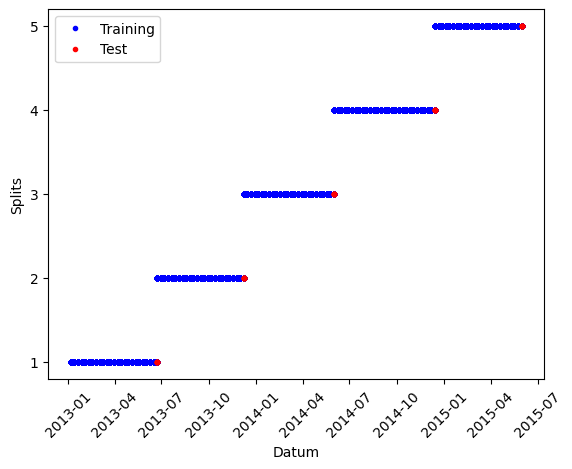

In [148]:
class BlockingTimeSeriesSplit():
    def __init__(self, n_splits, test_size=8):
        self.n_splits = n_splits
        self.test_size = test_size
    
    def get_n_splits(self, X, y=None, groups=None):
        return self.n_splits
    
    def split(self, X, y=None, groups=None):
        n_samples = len(X)
        k_fold_size = n_samples // self.n_splits
        indices = np.arange(n_samples)

        for i in range(self.n_splits):
            start = i * k_fold_size
            stop = start + k_fold_size
            mid = stop - self.test_size
            yield indices[start: mid], indices[mid: stop]

# Testen der splits
# Daten
data = df_train_valid.set_index("Datum").sort_index()

# Visualisierung der Splits, test size = 8 Wochen
btscv = BlockingTimeSeriesSplit(n_splits=5, test_size=8)
fig, ax = plt.subplots()

for i, (train_index, test_index) in enumerate(btscv.split(data)):
    ax.plot(data.index[train_index], [i + 1] * len(train_index), 'b.', label='Training' if i == 0 else "")
    ax.plot(data.index[test_index], [i + 1] * len(test_index), 'r.', label='Test' if i == 0 else "")

ax.set_xlabel('Datum')
ax.set_ylabel('Splits')
ax.set_yticks([1, 2, 3, 4, 5])
ax.legend()
plt.xticks(rotation=45)
plt.show()

Zunächst testen wir die Krossvalidierung mit 5 splits. Jedoch könnte es sein, dass die Trainingsdatensätze bei 5 splits zu klein ausfällt und der R2 drastisch fällt.

In [149]:
rf = RandomForestRegressor(n_jobs=-1)
btscv = BlockingTimeSeriesSplit(n_splits=5)
scores = cross_val_score(rf, X, y, cv=btscv, scoring="r2")
print("Loss: {0:.3f} (+/- {1:.3f})".format(scores.mean(), scores.std()))

Loss: 0.756 (+/- 0.219)


Wie erwartet ist der R2 Score gefallen, daher testen wir eine Splitanzahl von 3, damit die Trainingssätze größer sind.

In [150]:
rf = RandomForestRegressor(n_jobs=-1)
btscv = BlockingTimeSeriesSplit(n_splits=3)
scores = cross_val_score(rf, X, y, cv=btscv, scoring="r2")
print("Loss: {0:.3f} (+/- {1:.3f})".format(scores.mean(), scores.std()))

Loss: 0.950 (+/- 0.024)


Das Modell mit 3 splits schein recht stabil zu sein.

## 8.2. <a id='toc8_2_'></a>Hyperparameter Tuning [&#9650;](#toc0_)

Das Hyperparameter Tuning wird nach Zufall vollzogen. Folgende Paramter werden zufällig ausprobiert.  
1. n_estimators: Die Anzahl der Bäume im Wald. Mehr Bäume können die Genauigkeit verbessern, aber auch die Rechenzeit erhöhen.  

2. max_features: Die Anzahl der Merkmale, die für die Aufteilung eines Knotens in Betracht gezogen werden. Optionen sind:
    - 'sqrt': Wählt die Quadratwurzel der Gesamtzahl der Merkmale.
    - 'log2': Wählt den Logarithmus zur Basis 2 der Gesamtzahl der Merkmale.
3. max_depth: Die maximale Tiefe der Bäume. Eine größere Tiefe kann zu einer besseren Anpassung führen, aber auch das Risiko des Overfittings erhöhen. None bedeutet, dass die Knoten so lange erweitert werden, bis alle Blätter rein sind.  

4. min_samples_split: Die minimale Anzahl von Stichproben, die erforderlich sind, um einen internen Knoten zu teilen. Kleinere Werte können zu einer besseren Anpassung führen, aber auch das Risiko des Overfittings erhöhen.  

5. min_samples_leaf: Die minimale Anzahl von Stichproben, die in einem Blattknoten erforderlich sind. Kleinere Werte können zu einer besseren Anpassung führen, aber auch das Risiko des Overfittings erhöhen.  

6. bootstrap: Ob Bootstrap-Stichproben verwendet werden sollen, wenn Bäume gebaut werden. True bedeutet, dass Bootstrap-Stichproben verwendet werden, False bedeutet, dass die gesamte Stichprobe verwendet wird.

In [151]:
# Modell und Parameterbereich definieren
model = RandomForestRegressor(n_jobs=-1)
param_dist = {
    'n_estimators': randint(10, 150),
    'max_depth': randint(1, 20),
    'min_samples_split': randint(2, 12),
    'min_samples_leaf': randint(2, 12),
    'max_features': ['sqrt', 'log2'],
    'bootstrap': [True, False]}

btscv = BlockingTimeSeriesSplit(n_splits=5)

# RMSE Scorer definieren
rmse_scorer = make_scorer(mean_squared_error, greater_is_better=False, squared=False)

# RandomizedSearchCV einrichten mit RMSE als Scoring
random_search = RandomizedSearchCV(model, param_distributions=param_dist, n_iter=50, cv=btscv, n_jobs=-1, scoring=rmse_scorer)

# RandomizedSearchCV ausführen
random_search.fit(X, y)

# Ergebnisse sortieren und die Top 5 anzeigen
results = random_search.cv_results_
top5_indices = np.argsort(results['rank_test_score'])[:5]

print("Top 5 Parameterkombinationen und Scores:")
for idx in top5_indices:
    print(f"Parameter: {results['params'][idx]}, Score: {results['mean_test_score'][idx]}")


Top 5 Parameterkombinationen und Scores:
Parameter: {'bootstrap': True, 'max_depth': 17, 'max_features': 'sqrt', 'min_samples_leaf': 3, 'min_samples_split': 8, 'n_estimators': 110}, Score: -0.10892545237534235
Parameter: {'bootstrap': True, 'max_depth': 19, 'max_features': 'log2', 'min_samples_leaf': 4, 'min_samples_split': 11, 'n_estimators': 111}, Score: -0.10938112213775338
Parameter: {'bootstrap': False, 'max_depth': 17, 'max_features': 'log2', 'min_samples_leaf': 9, 'min_samples_split': 4, 'n_estimators': 122}, Score: -0.10977178545380624
Parameter: {'bootstrap': True, 'max_depth': 17, 'max_features': 'log2', 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 111}, Score: -0.11209094595029918
Parameter: {'bootstrap': True, 'max_depth': 14, 'max_features': 'log2', 'min_samples_leaf': 4, 'min_samples_split': 3, 'n_estimators': 28}, Score: -0.11278262191658839


In [152]:
# (n_estimators=51, max_features="sqrt", max_depth=16, min_samples_split=7, min_samples_leaf=4, bootstrap=True, n_jobs=-1)

Die Paramter werden unten in absteigender Reihenfolge auf Overfitting überprüft.

## 8.3. <a id='toc8_3_'></a>Paramater auf Overfitting testen [&#9650;](#toc0_)

Um auf Overfitting zu prüfen, werden die Metriken für das Tainings- und Test-set verglichen. Wenn der Fehler (RMSE) bei dem Testdatensatz deutlich niedriger ist, könnte das Modell overfittet sein.

In [153]:
# besten Parameter
# (n_estimators=51, max_features="sqrt", max_depth=16, min_samples_split=7, min_samples_leaf=4, bootstrap=True, n_jobs=-1)

In [154]:
# Train Daten
X_train = df_train[selected_features]
y_train = df_train['Umsatz']
# Test Daten
X_test = df_valid[selected_features]
y_test = df_valid['Umsatz']

# Modell fitten und prediction
rf = RandomForestRegressor(n_estimators=51, max_features="sqrt", max_depth=16, min_samples_split=7, min_samples_leaf=4, bootstrap=True).fit(X_train, y_train)
y_pred_train = rf.predict(X_train)
y_pred_test = rf.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred_test)
summary1 = pd.DataFrame({"Vergleich": "y_test&y_pred_test", "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
mae, r2, rmse = metriken(y_train, y_pred_train)
summary2 = pd.DataFrame({"Vergleich": "y_train&y_pred_train", "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
summary3 = pd.concat([summary1, summary2])
summary3


,Vergleich,MAE,R2,RMSE
0,y_test&y_pred_test,0.089065,0.904474,0.116019
0,y_train&y_pred_train,0.076746,0.926468,0.104901


Mit einer Differenz von ca. 0.01 (~ 10 %) RMSE auf Trainings- und Validierungs-Datensatz ist das Modell recht stabil und zeigt kein overfitting. Daher wird Modell auf den Trainings-Datensatz ausprobiert.

In [155]:
# Train Daten
X_train = df_train_valid[selected_features]
y_train = df_train_valid['Umsatz']
# Test Daten
X_test = df_test[selected_features]
y_test = df_test['Umsatz']

# Modell fitten und prediction
rf = RandomForestRegressor(n_estimators=51, max_features="sqrt", max_depth=16, min_samples_split=7, min_samples_leaf=4, bootstrap=True).fit(X_train, y_train)
y_pred_train = rf.predict(X_train)
y_pred_test = rf.predict(X_test)

# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred_test)
summary1 = pd.DataFrame({"Vergleich": "y_test&y_pred_test", "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
mae, r2, rmse = metriken(y_train, y_pred_train)
summary2 = pd.DataFrame({"Vergleich": "y_train&y_pred_train", "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
summary3 = pd.concat([summary1, summary2])
summary3


,Vergleich,MAE,R2,RMSE
0,y_test&y_pred_test,0.096566,0.878746,0.124481
0,y_train&y_pred_train,0.075351,0.929030,0.102848


Der RMSE ist etwas gefallen, aber trotzdem sehr gut.

# 9. <a id='toc9_'></a>ZukunftsDataframe erstellen [&#9650;](#toc0_)

## 9.1. <a id='toc9_1_'></a>Datenskelett aufbauen (letzen 8 Wochen der Daten) [&#9650;](#toc0_)

Zunächst wird ein Dataframe mit den selected features für die letzten 8 Wochen der Daten erstellt (2015-06-07 bis 2015-08-02). 

In [156]:
# Splitten
print(f"Train min {df_train_valid.Datum.min()}")
print(f"Train max {df_train_valid.Datum.max()}")
print(f"Test min {df_test.Datum.min()}")
print(f"Test max {df_test.Datum.max()}")
print(f"Test shape {df_test.shape}")

Train min 2013-01-06 00:00:00
Train max 2015-05-31 00:00:00
Test min 2015-06-07 00:00:00
Test max 2015-08-02 00:00:00
Test shape (10028, 52)


In [157]:
df_constructed = df_train_valid.copy().sort_values(["Datum", "Filiale"]).reset_index(drop=True)
df_constructed["isFuture"] = False

# Zu erstellender Datenbereich
timestamp = pd.Timestamp(df_weekly["Datum"].sort_values().iloc[-1])
split_point = timestamp - pd.Timedelta(days=(7*8))
# Datum für Skelett erzeugen
skelett_datum = pd.date_range(start=split_point, end=timestamp, freq="W")
skelett_datum = pd.DataFrame({"Datum": skelett_datum})
skelett_datum["isFuture"] = True
skelett_datum["isFuture"] = skelett_datum["isFuture"].astype(bool)

# Filiale in skelett einfügen
df_list = []
# Für jeden Filiale in future extra 8 wochen erzeugen
for Filiale in df_constructed['Filiale'].unique():
    # Füge die Filiale-Information zu future_df hinzu
    skelett_filiale = skelett_datum.copy()
    skelett_filiale['Filiale'] = Filiale
    # Füge den DataFrame zur Liste hinzu
    df_list.append(skelett_filiale)

# Skelett Filiale und Datum vereinigen    
skelett = pd.concat(df_list)
skelett = skelett.sort_values(["Datum", "Filiale"])

# zusätzliche Spalten i, selbst konstruierten dataframe finden 
extra_rows = skelett[~skelett.set_index(['Datum', 'Filiale']).index.isin(df_test.set_index(['Datum', 'Filiale']).index)]
# Entferne die zusätzlichen Zeilen
skelett = skelett[~skelett[['Datum', 'Filiale']].apply(tuple, axis=1).isin(extra_rows[['Datum', 'Filiale']].apply(tuple, axis=1))]

print(f"skelett min    {skelett.Datum.min()}")
print(f"skelett max    {skelett.Datum.max()}")
print(f"skelett shape  {skelett.shape}")

# Skelett an original df anfügen mit Feiertag bereits aufgespalten
df_constructed = pd.concat([df_constructed, skelett]).sort_values(["Filiale", "Datum"]).reset_index(drop=True)

skelett min    2015-06-07 00:00:00
skelett max    2015-08-02 00:00:00
skelett shape  (10028, 3)


Nachdem das Gerüst mit den Daten und Filialen nun steht, müssen die ausgewählten Features für das Zeitfenster imputiert werden.  

In [158]:
# statische Infos, einfach auffüllen
to_original = ['Filiale']
to_ffill = ['Gruppe',  'Promo2_seit_Woche',
            'Wettbew_offen_seit_Monat', 'Wettbew_offen_seit_Jahr', 'Wettbew_Distanz']
# mit Feature engineering erstellen
to_feature = ['Wettbew_seit_Monaten', 'Promo2_seit_Wochen']
# Vom Datum ableiten
to_datum = ['Kalenderwoche', 'Kalenderwoche_cos']
# Aus eda gewonnenen Erkenntnissen
to_manuell = ['Promo']

In [159]:
# Imputieren
# ffill methode
# Wettbew_Distanz
for feature in to_ffill:
    for i in df_constructed.Filiale.unique():
        df_constructed.loc[df_constructed['Filiale'] == i, feature] = \
            df_constructed.loc[df_constructed['Filiale'] == i, feature].ffill()

# Kalenderwoche
df_constructed['Kalenderwoche'] = df_constructed['Kalenderwoche'].fillna(df_constructed.Datum.dt.isocalendar().week)
df_constructed['Kalenderwoche_cos'] = df_constructed['Kalenderwoche'].apply(lambda x: np.cos(x*(2*np.pi/52)))

# Wettbew_offen_seit_Monaten
df_constructed.Wettbew_offen_seit_Jahr = df_constructed.Wettbew_offen_seit_Jahr.astype("float64")
df_constructed.Wettbew_offen_seit_Monat = df_constructed.Wettbew_offen_seit_Monat.astype("float64")
df_constructed['Wettbew_seit'] = df_constructed.apply(lambda x: datetime(year = int(x['Wettbew_offen_seit_Jahr']),
                                                                         month = int(x['Wettbew_offen_seit_Monat']),
                                                                         day = 1),
                                                      axis = 1)
df_constructed['Wettbew_seit_Monaten'] = ((df_constructed['Datum'] - df_constructed['Wettbew_seit']) / 30).apply(lambda x: x.days).astype(int)

# Promo2_seit_Wochen
# Promo2_seit_Jahr
for i in df_constructed.Filiale.unique():
    df_constructed.loc[df_constructed['Filiale'] == i, "Promo2_seit_Jahr"] = \
        df_constructed.loc[df_constructed['Filiale'] == i, "Promo2_seit_Jahr"].ffill()        
df_constructed['Promo2_seit'] = np.where(df_constructed['Promo2_seit_Jahr'] != 0,
                                   (df_constructed['Promo2_seit_Jahr']).astype(int).astype(str) + '-' + (df_constructed['Promo2_seit_Woche']).astype(int).astype(str),
                                   "2020-01")
df_constructed['Promo2_seit'] = df_constructed['Promo2_seit'].apply(lambda x: datetime.strptime(x + '-1', '%Y-%W-%w') - timedelta(days=7))
# Berechne Promo2_seit_Wochen --> Promo2_seit vom aktuellen Datum subtrahieren
df_constructed['Promo2_seit_Wochen'] = np.where(df_constructed['Promo2_seit'] != "2019-12-30",
                                          round((df_constructed['Datum'] - df_constructed['Promo2_seit']) / np.timedelta64(1, "W")).astype(int),
                                          0)


# Promo --> Fehler von 6.91 %
while df_constructed["Promo"].isna().any():
    for i in df_constructed.Filiale.unique():
        df_constructed["Promo"] = df_constructed["Promo"].fillna(df_constructed["Promo"].shift(2))

# Promo --> auf diese Weise Fehler von 17.94 %
# (Wochen: 1, 7, 9, 11, 24, 26, 28, 30, 31, 32, 42, 44, 50)
# df_constructed["Promo"] = np.where((df_constructed.Datum.dt.isocalendar().week == 1) | (df_constructed.Datum.dt.isocalendar().week == 7) | (df_constructed.Datum.dt.isocalendar().week == 9) |
#                                     (df_constructed.Datum.dt.isocalendar().week == 11) | (df_constructed.Datum.dt.isocalendar().week == 24) | (df_constructed.Datum.dt.isocalendar().week == 26) |
#                                     (df_constructed.Datum.dt.isocalendar().week == 28) | (df_constructed.Datum.dt.isocalendar().week == 30) | (df_constructed.Datum.dt.isocalendar().week == 31) | 
#                                     (df_constructed.Datum.dt.isocalendar().week == 32) | (df_constructed.Datum.dt.isocalendar().week == 42) | (df_constructed.Datum.dt.isocalendar().week == 44) | 
#                                     (df_constructed.Datum.dt.isocalendar().week == 50), 0, 5 )

df_constructed = df_constructed.loc[df_constructed["isFuture"] == True]
df_constructed = df_constructed[selected_features + ["Datum"]]
print(f"df_constructed shape: {df_constructed.shape}")
df_constructed.head()

df_constructed shape: (10028, 12)


,Gruppe,Promo,Wettbew_Distanz,Filiale,Kalenderwoche,Wettbew_seit_Monaten,Wettbew_offen_seit_Monat,Promo2_seit_Wochen,Promo2_seit_Woche,Wettbew_offen_seit_Jahr,Kalenderwoche_cos,Datum
126,2.0,5.0,1270.0,1,23,82,9.0,0,0.0,2008.0,-0.935016,2015-06-07
127,2.0,0.0,1270.0,1,24,82,9.0,0,0.0,2008.0,-0.970942,2015-06-14
128,2.0,5.0,1270.0,1,25,82,9.0,0,0.0,2008.0,-0.992709,2015-06-21
129,2.0,0.0,1270.0,1,26,83,9.0,0,0.0,2008.0,-1.000000,2015-06-28
130,2.0,5.0,1270.0,1,27,83,9.0,0,0.0,2008.0,-0.992709,2015-07-05


In [160]:
df_constructed.isna().any().sum()

0

Nun vergleichen wie gut df_test und df_constructed übereinstimmen

In [161]:
# Unterschiede in den einzelnen Spalten zwischen df_test und df_constructed
for feature in selected_features + ["Datum"]:   
    anzahl_unterschiede = []
    for filiale in df_constructed['Filiale'].unique():
        df1 = df_constructed.loc[df_constructed['Filiale'] == filiale, [feature]].reset_index(drop=True).sort_index(axis=1)
        df2 = df_test.loc[df_test['Filiale'] == filiale, [feature]].reset_index(drop=True).sort_index(axis=1)
        comparison = df1.compare(df2)
        if not comparison.empty:
            anzahl_unterschiede.append(comparison.shape[0])
    print(f"Anteil falscher Werte {feature} {round(np.sum(anzahl_unterschiede) / df_constructed.shape[0] * 100, 2)} %")

Anteil falscher Werte Gruppe 0.0 %
Anteil falscher Werte Promo 6.91 %
Anteil falscher Werte Wettbew_Distanz 0.0 %
Anteil falscher Werte Filiale 0.0 %
Anteil falscher Werte Kalenderwoche 0.0 %
Anteil falscher Werte Wettbew_seit_Monaten 3.78 %
Anteil falscher Werte Wettbew_offen_seit_Monat 0.0 %
Anteil falscher Werte Promo2_seit_Wochen 0.02 %
Anteil falscher Werte Promo2_seit_Woche 0.0 %
Anteil falscher Werte Wettbew_offen_seit_Jahr 0.0 %
Anteil falscher Werte Kalenderwoche_cos 0.0 %
Anteil falscher Werte Datum 0.0 %


Insgesamt wurden 6.91 %  Werte in Promo falsch imputiert.
Der Unterschied ist durch die Daten nicht erklärbar.

In [162]:
df_test[df_test.Promo == 4]

,Filiale,Datum,Umsatz,Geöffnet,Promo,ist_Promo2,Schulferien,Ostern,Weihnachten,öffentl_Feiertag,regulärer_Tag,Sonntag,Gruppe,Wettbew_Distanz,Wettbew_seit_Monaten,Wettbew_offen_seit_Monat,Wettbew_offen_seit_Jahr,Promo2,Promo2_seit_Wochen,Promo2_seit_Woche,Promo2_seit_Jahr,Jahr,Quartal,Monat,Kalenderwoche,Geschäftstyp_a,Geschäftstyp_b,Geschäftstyp_c,Geschäftstyp_d,Sortiment_basic,Sortiment_extended,Sortiment_extra,Bundesland_Baden_Württemberg,Bundesland_Bayern,Bundesland_Berlin,Bundesland_Bremen,Bundesland_Hamburg,Bundesland_Hessen,Bundesland_NRW,Bundesland_Rheinland_Pfalz,Bundesland_Sachsen,Bundesland_Sachsen_Anhalt,Bundesland_Schleswig_Holstein,Bundesland_Thüringen,Quartal_sin,Quartal_cos,Monat_sin,Monat_cos,Kalenderwoche_sin,Kalenderwoche_cos,Jahr_sin,Jahr_cos
0,1,2015-06-07,10.188666,5,4,0,0,0.0,0.0,0.0,5.0,0,2,1270.0,82.0,9.0,2008.0,0.0,0.0,0.0,0.0,2015.0,2.0,6.0,23,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
2,3,2015-06-07,10.735222,5,4,0,0,0.0,0.0,0.0,5.0,0,3,14130.0,103.0,12.0,2006.0,1.0,219.0,14.0,2011.0,2015.0,2.0,6.0,23,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
8,9,2015-06-07,10.807746,5,4,0,0,0.0,0.0,0.0,5.0,0,3,2030.0,180.0,8.0,2000.0,0.0,0.0,0.0,0.0,2015.0,2.0,6.0,23,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
12,13,2015-06-07,10.295057,5,4,0,4,0.0,0.0,0.0,5.0,0,1,310.0,146.0,6.0,2003.0,1.0,292.0,45.0,2009.0,2015.0,2.0,6.0,23,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
13,14,2015-06-07,10.403505,5,4,0,0,0.0,0.0,0.0,5.0,0,2,1300.0,15.0,3.0,2014.0,1.0,193.0,40.0,2011.0,2015.0,2.0,6.0,23,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1106,1107,2015-06-07,10.613148,5,4,0,4,0.0,0.0,0.0,5.0,0,2,1400.0,36.0,6.0,2012.0,1.0,272.0,13.0,2010.0,2015.0,2.0,6.0,23,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
1108,1109,2015-06-07,10.301928,5,4,0,4,0.0,0.0,0.0,5.0,0,1,3490.0,50.0,4.0,2011.0,1.0,159.0,22.0,2012.0,2015.0,2.0,6.0,23,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
1110,1111,2015-06-07,10.292078,5,4,0,0,0.0,0.0,0.0,5.0,0,2,1900.0,12.0,6.0,2014.0,1.0,97.0,31.0,2013.0,2015.0,2.0,6.0,23,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677
1111,1112,2015-06-07,11.066638,5,4,0,0,0.0,0.0,0.0,5.0,0,4,1880.0,111.0,4.0,2006.0,0.0,0.0,0.0,0.0,2015.0,2.0,6.0,23,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.224647e-16,-1.0,1.224647e-16,-1.0,0.354605,-0.935016,-0.128748,-0.991677


## 9.2. <a id='toc9_2_'></a>Datenskelett testen [&#9650;](#toc0_)

Zunächst den Transformer anpassen um auch df_constructed zu transformieren

In [163]:
print(f"df_train_valid min         {df_train_valid.Datum.min()}")
print(f"df_train_valid max         {df_train_valid.Datum.max()}")
print(f"df_train_valid shape       {df_train_valid.shape}")
print("")
print(f"df_test min          {df_test.Datum.min()}")
print(f"df_test max          {df_test.Datum.max()}")
print(f"df_test shape        {df_test.shape}")
print("")
print(f"df_constructed min   {df_constructed.Datum.min()}")
print(f"df_constructed max   {df_constructed.Datum.max()}")
print(f"df_constructed shape {df_constructed.shape}")

df_test.sort_values(["Datum", "Filiale"], inplace=True)
df_constructed.sort_values(["Datum", "Filiale"], inplace=True)
# Train Daten
X_train = df_train_valid[selected_features]
y_train = df_train_valid['Umsatz']
# Test Daten
X_test = df_test[selected_features]
y_test = df_test['Umsatz']
# Konstruierte Daten
X_test_constr = df_constructed[selected_features]

# Modell fitten und prediction
rf = RandomForestRegressor(n_estimators=51, max_features="sqrt", max_depth=16, min_samples_split=7, min_samples_leaf=4, bootstrap=True).fit(X_train, y_train)

# Vorhersage Testdaten
y_pred_test = rf.predict(X_test)
# Metriken berechnen
mae, r2, rmse = metriken(y_test, y_pred_test)
y_pred_test_results = pd.DataFrame({"Vergleich": ["y_test/y_pred_test"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})

# Vorhersage imputierte Daten
y_pred_constr = rf.predict(X_test_constr)
mae, r2, rmse = metriken(y_test, y_pred_constr)
y_pred_constr_results = pd.DataFrame({"Vergleich": ["y_test/y_pred_constr"], "MAE": [mae], "R2": [r2], "RMSE": [rmse]})
# Ergebnisse speichern
results_imputation = pd.concat([y_pred_test_results, y_pred_constr_results])
results_imputation.set_index("Vergleich")

df_train_valid min         2013-01-06 00:00:00
df_train_valid max         2015-05-31 00:00:00
df_train_valid shape       (135780, 52)

df_test min          2015-06-07 00:00:00
df_test max          2015-08-02 00:00:00
df_test shape        (10028, 52)

df_constructed min   2015-06-07 00:00:00
df_constructed max   2015-08-02 00:00:00
df_constructed shape (10028, 12)


,MAE,R2,RMSE
Vergleich,,,
y_test/y_pred_test,0.097844,0.875286,0.126245
y_test/y_pred_constr,0.098223,0.873359,0.127216


Das Modell sagt den Umsatz basierend auf einem konstruierten Dataframe sehr gut voraus.

# 10. <a id='toc10_'></a>Finales Modell und Zukunft [&#9650;](#toc0_)

## 10.1. <a id='toc10_1_'></a>Datenskelett aufbauen (zukunft) [&#9650;](#toc0_)

Zunächst wird ein Dataframe mit den selected features für die Zukunft erstellt (2015-08.03 bis 2015-09-27). 

In [164]:
df_constructed = df_train_valid.copy().sort_values(["Datum", "Filiale"]).reset_index(drop=True)
df_constructed["isFuture"] = False

# Zu erstellender Datenbereich
timestamp = pd.Timestamp(df["Datum"].sort_values().iloc[-1])
split_point = timestamp - pd.Timedelta(days=(7*8))
# Datum für Skelett erzeugen
skelett_datum = pd.date_range(start=split_point, end=timestamp, freq="W")
skelett_datum = pd.DataFrame({"Datum": skelett_datum})
skelett_datum["isFuture"] = True
skelett_datum["isFuture"] = skelett_datum["isFuture"].astype(bool)

# Filiale in skelett einfügen
df_list = []
# Für jeden Filiale in future extra 8 wochen erzeugen
for Filiale in df_constructed['Filiale'].unique():
    # Füge die Filiale-Information zu future_df hinzu
    skelett_filiale = skelett_datum.copy()
    skelett_filiale['Filiale'] = Filiale
    # Füge den DataFrame zur Liste hinzu
    df_list.append(skelett_filiale)

# Skelett Filiale und Datum vereinigen    
skelett = pd.concat(df_list)
skelett = skelett.sort_values(["Datum", "Filiale"])

# zusätzliche Spalten i, selbst konstruierten dataframe finden 
extra_rows = skelett[~skelett.set_index(['Datum', 'Filiale']).index.isin(df_test.set_index(['Datum', 'Filiale']).index)]
# Entferne die zusätzlichen Zeilen
skelett = skelett[~skelett[['Datum', 'Filiale']].apply(tuple, axis=1).isin(extra_rows[['Datum', 'Filiale']].apply(tuple, axis=1))]

print(f"skelett min    {skelett.Datum.min()}")
print(f"skelett max    {skelett.Datum.max()}")
print(f"skelett shape  {skelett.shape}")

# Skelett an original df anfügen mit Feiertag bereits aufgespalten
df_constructed = pd.concat([df_constructed, skelett]).sort_values(["Filiale", "Datum"]).reset_index(drop=True)

skelett min    2015-06-07 00:00:00
skelett max    2015-08-02 00:00:00
skelett shape  (10028, 3)


In [165]:
df_constructed = df.copy().sort_values(["Datum", "Filiale"]).reset_index(drop=True)
df_constructed["isFuture"] = False

# Zu erstellender Datenbereich
timestamp = pd.Timestamp(df["Datum"].sort_values().iloc[-1]) + pd.Timedelta(days=(1))
end_point = timestamp + pd.Timedelta(days=(7*8))
# Datum für Skelett erzeugen
skelett_datum = pd.date_range(start=timestamp, end=end_point, freq="W")
skelett_datum = pd.DataFrame({"Datum": skelett_datum})
skelett_datum["isFuture"] = True
skelett_datum["isFuture"] = skelett_datum["isFuture"].astype(bool)

# Filiale in skelett einfügen
df_list = []
# Für jeden Filiale in future extra 8 wochen erzeugen
for Filiale in df_constructed['Filiale'].unique():
    # Füge die Filiale-Information zu future_df hinzu
    skelett_filiale = skelett_datum.copy()
    skelett_filiale['Filiale'] = Filiale
    # Füge den DataFrame zur Liste hinzu
    df_list.append(skelett_filiale)

# Skelett Filiale und Datum vereinigen    
skelett = pd.concat(df_list)
skelett = skelett.sort_values(["Datum", "Filiale"])

print(f"skelett min    {skelett.Datum.min()}")
print(f"skelett max    {skelett.Datum.max()}")
print(f"skelett shape  {skelett.shape}")

# Skelett an original df anfügen mit Feiertag bereits aufgespalten
df_constructed = pd.concat([df_constructed, skelett]).sort_values(["Filiale", "Datum"]).reset_index(drop=True)

skelett min    2015-08-09 00:00:00
skelett max    2015-09-27 00:00:00
skelett shape  (8920, 3)


In [166]:
skelett_filiale

,Datum,isFuture,Filiale
0,2015-08-09,True,1081
1,2015-08-16,True,1081
2,2015-08-23,True,1081
3,2015-08-30,True,1081
4,2015-09-06,True,1081
5,2015-09-13,True,1081
6,2015-09-20,True,1081
7,2015-09-27,True,1081


Nachdem das Gerüst mit den Daten und Filialen nun steht, wird wieder imputiert

In [167]:
# Imputieren
# ffill methode
# Wettbew_Distanz
for feature in to_ffill:
    for i in df_constructed.Filiale.unique():
        df_constructed.loc[df_constructed['Filiale'] == i, feature] = \
            df_constructed.loc[df_constructed['Filiale'] == i, feature].ffill()

# Kalenderwoche
df_constructed['Kalenderwoche'] = df_constructed['Kalenderwoche'].fillna(df_constructed.Datum.dt.isocalendar().week)
df_constructed['Kalenderwoche_cos'] = df_constructed['Kalenderwoche'].apply(lambda x: np.cos(x*(2*np.pi/52)))

# Wettbew_offen_seit_Monaten
df_constructed.Wettbew_offen_seit_Jahr = df_constructed.Wettbew_offen_seit_Jahr.astype("float64")
df_constructed.Wettbew_offen_seit_Monat = df_constructed.Wettbew_offen_seit_Monat.astype("float64")
df_constructed['Wettbew_seit'] = df_constructed.apply(lambda x: datetime(year = int(x['Wettbew_offen_seit_Jahr']),
                                                                         month = int(x['Wettbew_offen_seit_Monat']),
                                                                         day = 1),
                                                      axis = 1)
df_constructed['Wettbew_seit_Monaten'] = ((df_constructed['Datum'] - df_constructed['Wettbew_seit']) / 30).apply(lambda x: x.days).astype(int)

# Promo2_seit_Wochen
# Promo2_seit_Jahr
for i in df_constructed.Filiale.unique():
    df_constructed.loc[df_constructed['Filiale'] == i, "Promo2_seit_Jahr"] = \
        df_constructed.loc[df_constructed['Filiale'] == i, "Promo2_seit_Jahr"].ffill()        
df_constructed['Promo2_seit'] = np.where(df_constructed['Promo2_seit_Jahr'] != 0,
                                   (df_constructed['Promo2_seit_Jahr']).astype(int).astype(str) + '-' + (df_constructed['Promo2_seit_Woche']).astype(int).astype(str),
                                   "2020-01")
df_constructed['Promo2_seit'] = df_constructed['Promo2_seit'].apply(lambda x: datetime.strptime(x + '-1', '%Y-%W-%w') - timedelta(days=7))
# Berechne Promo2_seit_Wochen --> Promo2_seit vom aktuellen Datum subtrahieren
df_constructed['Promo2_seit_Wochen'] = np.where(df_constructed['Promo2_seit'] != "2019-12-30",
                                          round((df_constructed['Datum'] - df_constructed['Promo2_seit']) / np.timedelta64(1, "W")).astype(int),
                                          0)


# Promo --> Fehler von 6.91 %
while df_constructed["Promo"].isna().any():
    for i in df_constructed.Filiale.unique():
        df_constructed["Promo"] = df_constructed["Promo"].fillna(df_constructed["Promo"].shift(2))

df_constructed = df_constructed.loc[df_constructed["isFuture"] == True]
df_constructed = df_constructed[selected_features + ["Datum"]]
print(f"df_constructed shape: {df_constructed.shape}")
df_constructed.head()

df_constructed shape: (8920, 12)


,Gruppe,Promo,Wettbew_Distanz,Filiale,Kalenderwoche,Wettbew_seit_Monaten,Wettbew_offen_seit_Monat,Promo2_seit_Wochen,Promo2_seit_Woche,Wettbew_offen_seit_Jahr,Kalenderwoche_cos,Datum
135,2.0,0.0,1270.0,1,32,84,9.0,0,0.0,2008.0,-0.748511,2015-08-09
136,2.0,5.0,1270.0,1,33,84,9.0,0,0.0,2008.0,-0.663123,2015-08-16
137,2.0,0.0,1270.0,1,34,84,9.0,0,0.0,2008.0,-0.568065,2015-08-23
138,2.0,5.0,1270.0,1,35,85,9.0,0,0.0,2008.0,-0.464723,2015-08-30
139,2.0,0.0,1270.0,1,36,85,9.0,0,0.0,2008.0,-0.354605,2015-09-06


In [168]:
df_constructed.isna().sum()

Gruppe                      0
Promo                       0
Wettbew_Distanz             0
Filiale                     0
Kalenderwoche               0
Wettbew_seit_Monaten        0
Wettbew_offen_seit_Monat    0
Promo2_seit_Wochen          0
Promo2_seit_Woche           0
Wettbew_offen_seit_Jahr     0
Kalenderwoche_cos           0
Datum                       0
dtype: int64

## 10.2. <a id='toc10_2_'></a>Zukunft vorhersagen [&#9650;](#toc0_)

Transformations-Funktion wird erneut angepasst

In [169]:
df.sort_values(["Datum", "Filiale"], inplace=True)
df_constructed.sort_values(["Datum", "Filiale"], inplace=True)
df_constructed.reset_index(inplace=True, drop=True)

# Train Daten
X_train = df[selected_features]
y_train = df['Umsatz']
# Test Daten
X_test = df_constructed[selected_features]

# Modell fitten und prediction
rf = RandomForestRegressor(n_estimators=51, max_features="sqrt", max_depth=16, min_samples_split=7, min_samples_leaf=4, bootstrap=True).fit(X_train, y_train)
y_pred = rf.predict(X_test)

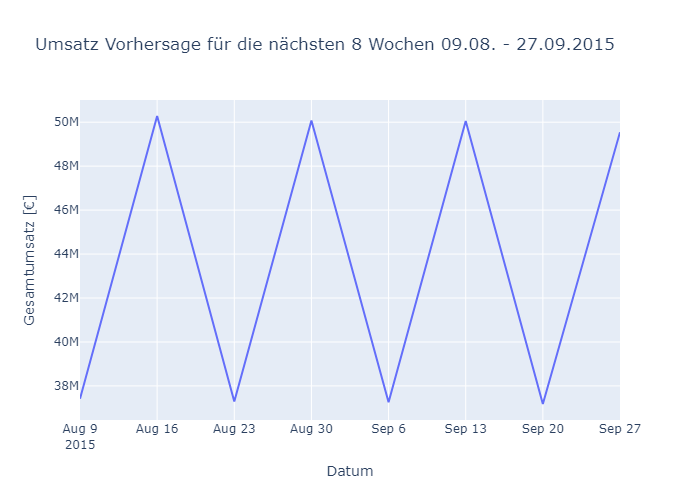

In [170]:
df_vorhersage = df_constructed[["Datum", "Filiale"]].copy()
df_vorhersage.sort_values(["Datum", "Filiale"], inplace=True)

# Rücktransformation der logarithmierten Werte
y_past = np.exp(y_train).astype(int).copy()
y_future = np.exp(y_pred).astype(int).copy()
y_rücktransformiert_df = pd.DataFrame({"Umsatz_pred": y_future})

df_vorhersage = pd.concat([df_vorhersage, y_rücktransformiert_df], axis=1)
df_vorhersage = df_vorhersage.groupby(["Datum"])["Umsatz_pred"].sum().reset_index()
# Plotly Express Plot
fig = px.line(df_vorhersage, x='Datum', y="Umsatz_pred",
              title='Umsatz Vorhersage für die nächsten 8 Wochen 09.08. - 27.09.2015', labels={"Umsatz_pred": "Gesamtumsatz [€]"})
fig.show()

für den Zeitraum 2015-08-02 bis 2015-09-20 wird 348.597.521 € vorhergesagt.

In [171]:
df_vorhersage.Umsatz_pred.sum()

349085414

In [172]:
# train unf future speichern
df_weekly.to_parquet("..\\Save_files\\df_data.parquet", engine='pyarrow')
df.to_parquet("..\\Save_files\\df_transformed_data.parquet", engine='pyarrow')
df_constructed.to_parquet("..\\Save_files\\df_future_construct.parquet", engine='pyarrow')
# Modell speichern
joblib.dump(rf,"..\\MachineLearning_Modell\\random_forest_model.joblib", compress=3)




['..\\MachineLearning_Modell\\random_forest_model.joblib']

# 11. <a id='toc11_'></a>Filialebericht-Generator [&#9650;](#toc0_)

Bitte führen die nächste Zelle aus, indem sie in die Zelle klicken und mit Strg+Enter bestätigen.  
Sie werden entweder ganz unten oder ganz oben (je nach verwendeter Software) nach der Eingabe Ihrer Filialnummer gefragt.  
Nummer eingeben, bestätigen und ganz unten den Bericht einsehen.

Bitte warten. Ihr Bericht wird generiert...


,Umsatz Prognose [€],Umsatz Gesamt [€],Kundenzahl Gesamt,Umsatz_pro_Tag [€],Kunden_pro_Tag,Umsatz_pro_Kunde[€],Leistung nach Umsatz pro Tag
9,253959,4365642,465661,4365642.0,465661.0,7316.216766,Unteres Mittelfeld


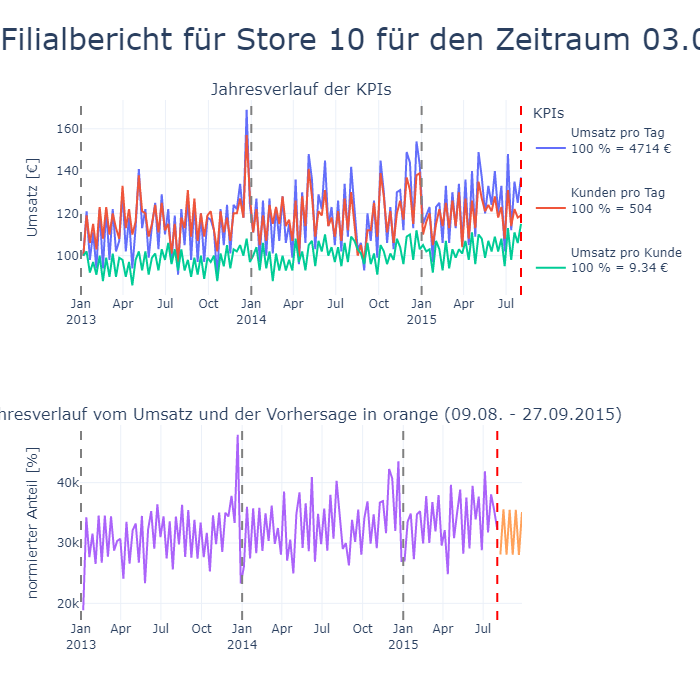

(None, None)

In [173]:

import warnings
warnings.filterwarnings("ignore", category=UserWarning)

selected_features= ['Gruppe', 'Promo', 'Wettbew_Distanz', 'Filiale', 'Kalenderwoche',
       'Wettbew_seit_Monaten', 'Wettbew_offen_seit_Monat',
       'Promo2_seit_Wochen', 'Promo2_seit_Woche',
       'Wettbew_offen_seit_Jahr', 'Kalenderwoche_cos']
def generiere_report(Filialennummer):
    print("Bitte warten. Ihr Bericht wird generiert...")
    time.sleep(2)  # Simuliert eine Verzögerung von 2 Sekunden
    # Dein bestehender Code für generiere_report
    pass
    # Daten laden
    rf = joblib.load("..\\MachineLearning_Modell\\random_forest_model.joblib")
    df = pd.read_parquet("..\\Save_files\\df_data.parquet", engine='pyarrow')
    df_agg = pd.read_parquet("..\\Save_files\\df_agg.parquet", engine='pyarrow')
    df_transformed = pd.read_parquet("..\\Save_files\\df_transformed_data.parquet", engine='pyarrow')
    df_constructed = pd.read_parquet("..\\Save_files\\df_future_construct.parquet", engine='pyarrow')
   
    # Daten sortieren und Filiale auswählen
    df = df[df.Filiale == Filialennummer].copy()
    df = df.sort_values(["Datum"]).reset_index(drop=True).copy()
    df["Umsatz_pro_Tag"] = df.Umsatz//df.Geöffnet.round(0)
    df["Kunden_pro_Tag"] = df.Kundenzahl//df.Geöffnet.round(0)
    df["Umsatz_pro_Kunde"] = df.Umsatz / df.Kundenzahl.round(2)
    
    df_constructed = df_constructed[df_constructed.Filiale == Filialennummer].copy()
    df_constructed = df_constructed.sort_values(["Datum"]).reset_index(drop=True)
    
    # Umsatz für Filiale x vorhersagen
    # Test Daten
    X_test = df_constructed[selected_features]
    y_pred = rf.predict(X_test)
    
    #Vorhersage plotten
    df_vorhersage = df_constructed[["Datum"]].copy()
    # Rücktransformation der logarithmierten Werte
    y_future = np.exp(y_pred).astype(int).copy()
    y_rücktransformiert_df = pd.DataFrame({"Umsatz": y_future})
    df_vorhersage = pd.concat([df_vorhersage, y_rücktransformiert_df], axis=1)
    
    # Subplots erstellen
    fig = make_subplots(rows=2, cols=3, subplot_titles=("Jahresverlauf der KPIs","Jahresverlauf vom Umsatz und der Vorhersage in orange (09.08. - 27.09.2015)"),
                        specs=[[{"colspan": 3}, None, None], [{"colspan": 3}, None, None]])
 
    # normieren auf ersten wert
    df["Umsatz_pro_Kunde"] = round(df["Umsatz_pro_Kunde"], 2)
    metriken = ["Umsatz_pro_Tag", "Kunden_pro_Tag", "Umsatz_pro_Kunde"]
    metriken_normiert = ["Umsatz pro Tag", "Kunden pro Tag", "Umsatz pro Kunde"]
    df[metriken_normiert] = round(df[metriken].div(df[metriken].iloc[0].values) * 100)
    df_melt = pd.melt(df, id_vars=["Datum"], value_name="Anteil", value_vars=metriken_normiert, var_name="KPIs")
    
    fig1 = px.line(df_melt, x="Datum", y="Anteil", color="KPIs")
    for trace in fig1['data']:
        trace['showlegend'] = True 
        fig.add_trace(trace, row=1, col=1)
    
    
    df["isFuture"] = False
    df_vorhersage["isFuture"] = True
    df_combined = pd.concat([df, df_vorhersage], ignore_index=True)
    
    fig2 = px.line(df_combined, x='Datum', y="Umsatz", color="isFuture", color_discrete_sequence=px.colors.qualitative.Plotly[3:5])
    for trace in fig2['data']:
        trace['showlegend'] = False 
        fig.add_trace(trace, row=2, col=1)

    # Variablen in der Legende umbenennen
    fig.for_each_trace(lambda trace: trace.update(name=trace.name.replace("Umsatz pro Tag", f"Umsatz pro Tag<br>100 % = {df.Umsatz_pro_Tag.iloc[0]} €<br>")
                                                .replace("Kunden pro Tag", f"Kunden pro Tag<br>100 % = {df.Kunden_pro_Tag.iloc[0]} <br>")
                                                .replace("Umsatz pro Kunde", f"Umsatz pro Kunde<br>100 % = {df.Umsatz_pro_Kunde.iloc[0]} €<br>")
                                                ))
    # Vertikale linien für jedes jahr
    for year in [2013, 2014, 2015]:
        fig.add_vline(x=pd.Timestamp(f'{year}-01-01'), line=dict(dash='dash', color='gray'))
    fig.add_vline(x=pd.Timestamp(f'2015-08-02'), line=dict(dash='dash', color='red'))
    # jeden 3ten Monat zeigen    
    fig.update_xaxes(tickformat="%b\n%Y", dtick="M3")
    fig.update_layout(title_text=f"Filialbericht für Store {Filialennummer} für den Zeitraum 03.08. - 27.09.2015", title_font_size=30, title_x=0.0, template="plotly_white", height=700,
                    xaxis1_title="", yaxis1_title="Umsatz [€]",
                    xaxis2_title="", yaxis2_title="normierter Anteil [%]",
                    legend_title="KPIs")
        
    df_gesamt = df_agg[df_agg.Filiale == Filialennummer].copy()
    df_gesamt["Umsatz Prognose"] = df_vorhersage.Umsatz.sum().round().astype(int)
    df_gesamt = df_gesamt[["Umsatz Prognose", 'Umsatz', 'Kundenzahl', 'Umsatz_pro_Tag', "Kunden_pro_Tag", 'Umsatz_pro_Kunde', 'Gruppe',]]
    df_gesamt.columns = ["Umsatz Prognose [€]", 'Umsatz Gesamt [€]', 'Kundenzahl Gesamt', 'Umsatz_pro_Tag [€]', "Kunden_pro_Tag", 'Umsatz_pro_Kunde[€]', 'Leistung nach Umsatz pro Tag',]
    
    return display(df_gesamt), fig.show()

# Eingabeaufforderung erstellen
while True:
    try:
        Filialennummer = int(input("Bitte geben Sie eine Filialnummer zwischen 1 und 1115 ein: "))
        if 1 <= Filialennummer <= 1115:
            break
        else:
            print("Die Filialnummer muss zwischen 1 und 1115 liegen. Bitte versuchen Sie es erneut.")
    except ValueError:
        print("Ungültige Eingabe. Bitte geben Sie eine Zahl ein.")

# generiere_report mit der eingegebenen Filialnummer aufrufen
generiere_report(Filialennummer)
